Download the support file for IS computation.

In [ ]:
from google.colab import auth
auth.authenticate_user()
from googleapiclient.discovery import build
drive_service = build('drive', 'v3')
import io
import os
from googleapiclient.http import MediaIoBaseDownload
def download_file(fn, file_id):
    request = drive_service.files().get_media(fileId=file_id)
    downloaded = io.BytesIO()
    downloader = MediaIoBaseDownload(downloaded, request)
    done = False
    while done is False:
        # _ is a placeholder for a progress object that we ignore.
        # (Our file is small, so we skip reporting progress.)
        _, done = downloader.next_chunk()
    downloaded.seek(0)
    folder = fn.split('/')
    if len(folder) > 1:
        os.makedirs(folder[0], exist_ok=True)
    with open(fn, 'wb') as f:
        f.write(downloaded.read())
id_to_fn = {
'1z-3wIa4MzQp2fHHn2_1v1ZuI8sYKXrTw': 'inception_score.py',
'1ijo3v_Y-XrV8ytpWRey9PvHy_NV9cTBE': 'test_case_VAE.zip',
'1FZyHINMFqELoTjWUHSwM3krMF1bH3ROV': 'test_case_GAN.zip'
}
# download all files into the vm
for fid, fn in id_to_fn.items():
    print("Downloading %s from %s" % (fn, fid))
    download_file(fn, fid)

In [ ]:
! unzip -q test_case_VAE.zip
! unzip -q test_case_GAN.zip

# VAE
### Load data for part 1.1 VAE


In [ ]:
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
from torchvision import datasets, transforms
from torch.autograd import Variable
from torchvision.utils import save_image
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML
import numpy as np
from torch.optim.lr_scheduler import StepLR
import torchvision.utils as vutils
from torch.utils.data import DataLoader, TensorDataset
from scipy import linalg
from scipy.stats import entropy
import tqdm
import cv2

# FashionMNIST Dataset
train_dataset = datasets.FashionMNIST(root='./mnist_data/', train=True, transform=transforms.ToTensor(), download=True)
test_dataset = datasets.FashionMNIST(root='./mnist_data/', train=False, transform=transforms.ToTensor(), download=False)

# Data Loader (Input Pipeline)
train_batch_size = 100
test_batch_size = 100
train_loader = torch.utils.data.DataLoader(dataset=train_dataset, batch_size=train_batch_size, shuffle=True)
test_loader = torch.utils.data.DataLoader(dataset=test_dataset, batch_size=test_batch_size, shuffle=False)

Extracting ./mnist_data/FashionMNIST/raw/train-images-idx3-ubyte.gz to ./mnist_data/FashionMNIST/raw


Extracting ./mnist_data/FashionMNIST/raw/train-labels-idx1-ubyte.gz to ./mnist_data/FashionMNIST/raw



Extracting ./mnist_data/FashionMNIST/raw/t10k-images-idx3-ubyte.gz to ./mnist_data/FashionMNIST/raw


Extracting ./mnist_data/FashionMNIST/raw/t10k-labels-idx1-ubyte.gz to ./mnist_data/FashionMNIST/raw
Processing...
Done!




/usr/local/lib/python3.6/dist-packages/torchvision/datasets/mnist.py:480: UserWarning: The given NumPy array is not writeable, and PyTorch does not support non-writeable tensors. This means you can write to the underlying (supposedly non-writeable) NumPy array using the tensor. You may want to copy the array to protect its data or make it writeable before converting it to a tensor. This type of warning will be suppressed for the rest of this program. (Triggered internally at  /pytorch/torch/csrc/utils/tensor_numpy.cpp:141.)
  return torch.from_numpy(parsed.astype(m[2], copy=False)).view(*s)


# Visualization 

In [ ]:
def show(img):
    img = img.cpu().detach()
    npimg = img.numpy()
    plt.imshow(np.transpose(npimg, (1,2,0)), interpolation='nearest')
    plt.show()

## Model Definition (TODO)

In [ ]:
class VAE(torch.nn.Module):
  def __init__(self, zdim):
    super(VAE,self).__init__()
    ################################
    # Please fill in your code here:

    ################################
    self.relu = nn.ReLU()
    #Encode Layers
    self.encode_fc1 = nn.Linear(784,400)
    self.encode_fc2 = nn.Linear(400, 5)
    self.encode_fc3 = nn.Linear(400,5)
    #Decode Layers
    self.decode_fc1 = nn.Linear(5,400)
    self.decode_fc2 = nn.Linear(400,784)
    self.sigmoid = nn.Sigmoid()
    
  def encode(self, x):
    h1 = self.relu(self.encode_fc1(x)) 
    return self.encode_fc2(h1), self.encode_fc3(h1)


  def decode(self, X):
    h3 = self.relu(self.decode_fc1(X))
    return self.sigmoid(self.decode_fc2(h3))

  def reparameterization(self, mu, log_var):
    if self.training:
      std = log_var.mul(0.5).exp_()
      eps = std.data.new(std.size()).normal_()
      z = eps.mul(std).add_(mu)
    else:
      z = mu   

    return z

  def forward(self, X):
    X = X.view(-1,784)
    mean, log_var = self.encode(X)
    z = self.reparameterization(mean, log_var)
    return self.decode(z), mean, log_var



# reparameterization's output is dynamic, for the test case, we use a fixed eps 
# and all the intermediate result is provided. 
# You could use these values to check if you get the final output z correct.
# Or you could add eps to the input when testing the reparameterization module. 
# (warm reminder: don't forget to change back, cause the dynamic reparameterization is the key to VAE) 

# TEST YOUR REPARAMETRIZATION FUNCTION with the values below
testcase_mean = torch.load('test_case_VAE/mean.pt')
testcase_log_var = torch.load('test_case_VAE/log_var.pt')
# check std
testcase_std = torch.load('test_case_VAE/std.pt')
# Since epsilon is random, use the deterministic value of epsilon provided below
testcase_eps = torch.load('test_case_VAE/eps.pt')
testcase_z = torch.load('test_case_VAE/z.pt' )


TypeError: ignored

## VAE Train

### VAE Reconstruction Evaluation (TODO)
For this reconstruction evaluation module, you need to integrate into training procesure.

In [ ]:
# Reconstruction error module
def reconstruction_error(model, test_loader):
    '''
    Argms: 
    Input:
        model: VAE model
        test_loader: Fashion-MNIST test_loader
    Output:
        avg_err: MSE 
    '''
    # set model to eval
    ##################
    # TODO:
    ##################
    # Initialize MSE Loss(use reduction='sum')
    MSE = torch.nn.MSELoss(reduction='sum')
    ##################
    # TODO:
    ##################
    recon_err = 0
    idx_counter = 0
    for i, (data,_) in enumerate(test_loader):
        data = data.to(device)
        recon_batch, mean, log_var = vae(data)
        # print('Reconstruction',recon_batch.shape)
        # print('data',data.shape)
        
        

        recon_batch = recon_batch.reshape(100,1, 28, 28)
        #recon_batch = recon_batch.view(-1)
        # print('data',data.shape)
        # print('Reconstruction',recon_batch.shape)
        # feed forward data to VAE
        ##################
        # TODO:
        ##################
        
        idx_counter+=data.shape[0] # sum up the number of images in test_loader
        
        # flatten the reconstruction output
        ##################
        # TODO:
        ##################
        # accumulate the MSELoss acrossing the whole test set
        loss = MSE(recon_batch,data)
        recon_err += loss
        ##################
        # TODO:
        ##################
        
    avg_err = recon_err/idx_counter
    return avg_err




### Reconstruction error + KL divergence losses in VAE (TODO)

In [ ]:
# Return reconstruction error + KL divergence losses
def loss_function(recon_x, x, mu, log_var):
  x = x.view(-1,784)
  BCE = torch.nn.functional.binary_cross_entropy(recon_x, x,reduction='sum')
  KLD = -0.5 * torch.sum(1 + log_var - mu.pow(2) - log_var.exp())
  #KLD /= 100 * 784
  
    ################################
    # Please compute BCE and KLD:
    
    ################################
  totalloss = BCE + KLD
  return totalloss


#####################################################
# TEST CASE FOR VAE LOSS

#####################################################
testcase_loss_recon_x = torch.load('test_case_VAE/loss_recon_x.pt')
testcase_loss_x = torch.load('test_case_VAE/loss_x.pt')
testcase_loss_mu = torch.load('test_case_VAE/loss_mu.pt')
testcase_loss_log_var = torch.load('test_case_VAE/loss_log_var.pt')
testcase_loss_totalloss = torch.load('test_case_VAE/loss_totalloss.pt')

loss = loss_function(testcase_loss_recon_x, testcase_loss_x, testcase_loss_mu, testcase_loss_log_var)
print("test case loss value:", testcase_loss_totalloss.item())
print("computed loss value:", loss.item())

test case loss value: 25477.3828125
computed loss value: 25477.3828125


### VAE Training

In [ ]:
import torchvision

Train Epoch: 1 0% 	Loss: 551.846133 	Recon_err: 127.96996307373047
Train Epoch: 1 17% 	Loss: 272.641035 	Recon_err: 27.939781188964844
Train Epoch: 1 33% 	Loss: 274.949941 	Recon_err: 21.104244232177734
Train Epoch: 1 50% 	Loss: 263.153477 	Recon_err: 19.696067810058594
Train Epoch: 1 67% 	Loss: 260.201719 	Recon_err: 19.126731872558594
Train Epoch: 1 83% 	Loss: 255.362051 	Recon_err: 18.63176918029785
Epoch: 1 Train loss: 273.4768
Train Epoch: 2 0% 	Loss: 258.759336 	Recon_err: 18.123626708984375
Train Epoch: 2 17% 	Loss: 250.029980 	Recon_err: 17.978172302246094
Train Epoch: 2 33% 	Loss: 264.880332 	Recon_err: 17.56940460205078
Train Epoch: 2 50% 	Loss: 253.979805 	Recon_err: 17.44953727722168
Train Epoch: 2 67% 	Loss: 260.085898 	Recon_err: 17.257587432861328
Train Epoch: 2 83% 	Loss: 248.008223 	Recon_err: 17.09303092956543
Epoch: 2 Train loss: 252.4745
Train Epoch: 3 0% 	Loss: 257.037754 	Recon_err: 17.083614349365234
Train Epoch: 3 17% 	Loss: 254.165898 	Recon_err: 16.96792602539

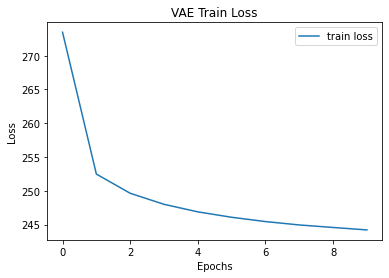

In [ ]:
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
# Z dimension
ZDIM = 5
#Initialize VAE
vae = VAE(5).to(device)
#Initialize optimizer
optimizer = optim.Adam(vae.parameters(), lr = 1e-3)
#Initialize scheduler(optional)
scheduler = StepLR(optimizer, step_size=10, gamma=0.2)
#num of epochs 
num_epochs = 10
import pdb
train_loss_list = []
orig_image_list = []
recon_image_list = []
reconst_error = []
# Define Train loop 
def train(epochs, train_loader, test_loader):

  for epoch in range(epochs):
      vae.train()
      train_loss = 0
      for batch_idx, (data, _) in enumerate(train_loader):
          data = data.cuda()
          optimizer.zero_grad()
          recon_batch, mean, log_var = vae(data)

          loss = loss_function(recon_batch, data, mean, log_var)
          
          loss.backward()
          train_loss += loss.item()
          optimizer.step()

          if batch_idx % 100 == 0:
              recon_err = reconstruction_error(vae, test_loader)
              reconst_error.append(recon_err)
              print('Train Epoch: {} {:.0f}% \tLoss: {:.6f} \tRecon_err: {}'.format(epoch+1, 100. * batch_idx / len(train_loader), loss.item() / len(data), recon_err))
          del data; del recon_batch; del mean; del log_var    
          
      train_loss_list.append(train_loss / len(train_loader.dataset))
      print('Epoch: {} Train loss: {:.4f}'.format(epoch+1, train_loss / len(train_loader.dataset)))
      scheduler.step() 

    #   recon_err = reconstruction_error(vae, test_loader)
    #   print('Epoch: {} Reconstruction Error: {:.4f}'.format(epoch+1, recon_err))
      if epoch%5==0:
        with torch.no_grad():
          test_loss = 0
          x_batch =torch.randn(10*10, ZDIM)
          recon_batch = vae.decode(x_batch.to(device))          
          x_batch =torch.randn(10*10, ZDIM)
          recon_batch = vae.decode(x_batch.to(device))
        orig_image_list.append(vutils.make_grid(x_batch, nrow=10 ,padding=2, normalize=True))
        recon_image_list.append(vutils.make_grid(recon_batch.view(recon_batch.shape[0], 1 , 28, 28).detach().cpu(),nrow=10 , padding=2, normalize=True))
        show_recon = vutils.make_grid(recon_batch.view(recon_batch.shape[0], 1 , 28, 28).detach().cpu(),nrow=10 , padding=2, normalize=True)
        #show(show_recon)
  # save the training checkpoint
  checkpoint = {'vae': vae.state_dict()}
  torch.save(checkpoint, '/content/vae_{}.pt'.format(epochs))
# Run Train loop
train(num_epochs, train_loader, test_loader)

# Plot Train loss
plt.title("VAE Train Loss")
plt.plot(train_loss_list,label="train loss")
plt.xlabel("Epochs")
plt.ylabel("Loss")
plt.legend()
plt.show()


## Qualitative Visualisations

### VAE Testing (TODO)

torch.Size([36, 784])


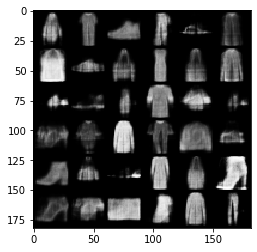

torch.Size([36, 784])


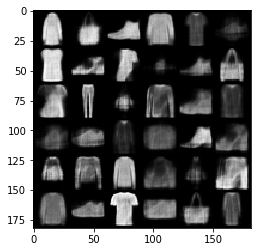

torch.Size([36, 784])


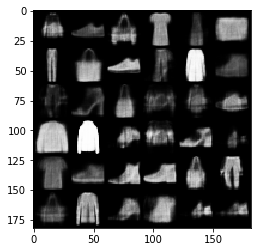

torch.Size([36, 784])


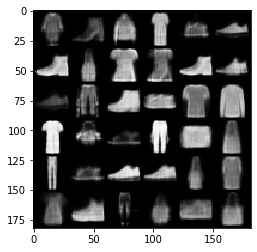

torch.Size([36, 784])


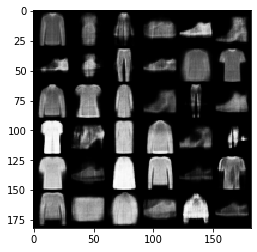

torch.Size([36, 784])


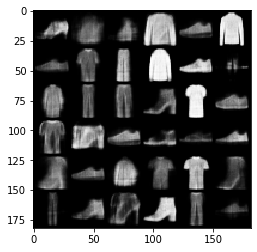

torch.Size([36, 784])


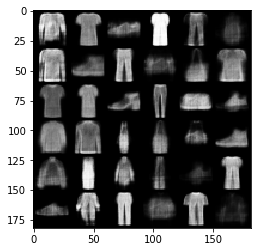

torch.Size([36, 784])


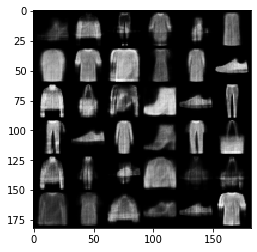

torch.Size([36, 784])


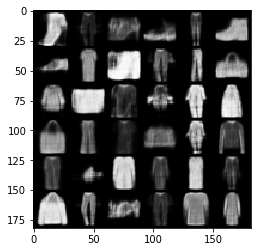

torch.Size([36, 784])


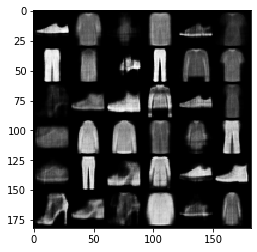

torch.Size([36, 784])


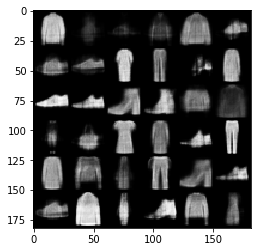

torch.Size([36, 784])


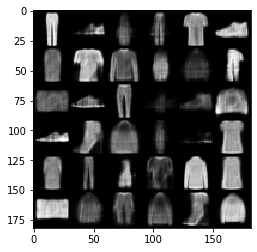

torch.Size([36, 784])


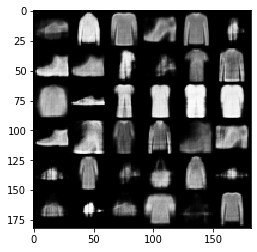

torch.Size([36, 784])


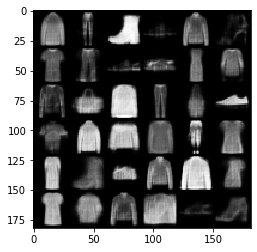

torch.Size([36, 784])


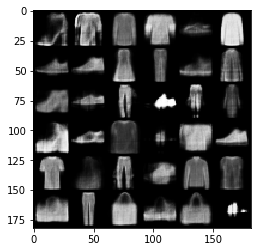

torch.Size([36, 784])


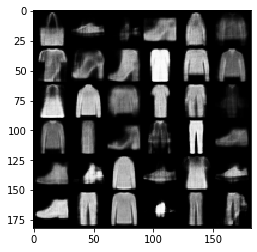

torch.Size([36, 784])


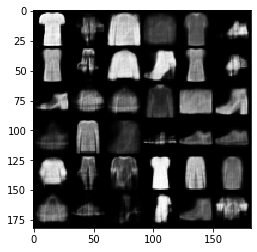

torch.Size([36, 784])


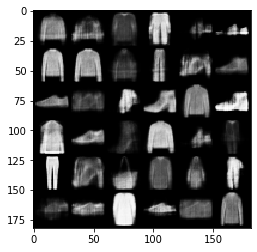

torch.Size([36, 784])


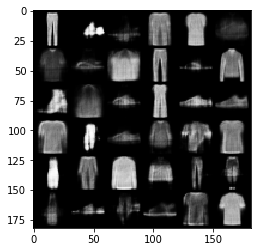

torch.Size([36, 784])


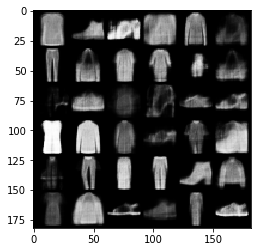

torch.Size([36, 784])


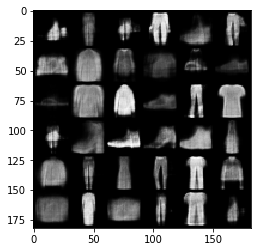

torch.Size([36, 784])


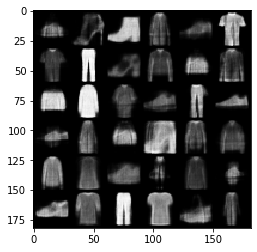

torch.Size([36, 784])


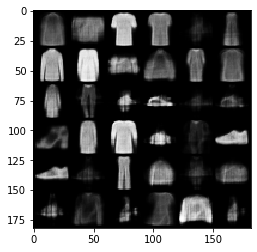

torch.Size([36, 784])


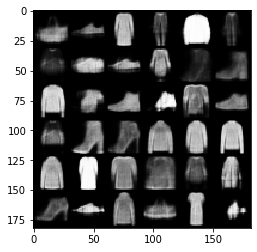

torch.Size([36, 784])


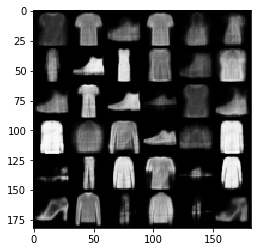

torch.Size([36, 784])


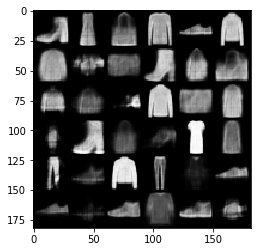

torch.Size([36, 784])


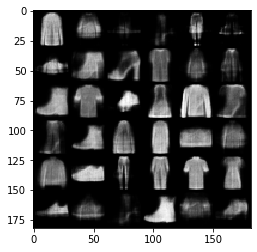

torch.Size([36, 784])


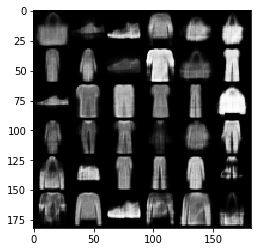

torch.Size([36, 784])


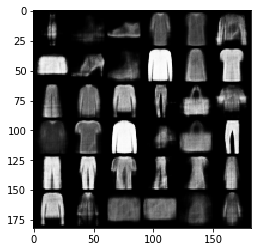

torch.Size([36, 784])


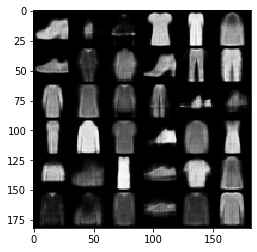

torch.Size([36, 784])


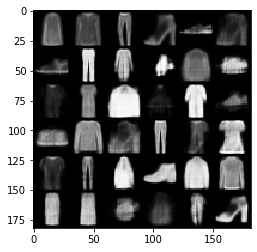

torch.Size([36, 784])


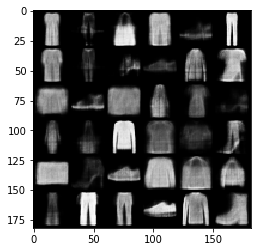

torch.Size([36, 784])


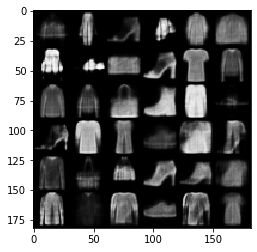

torch.Size([36, 784])


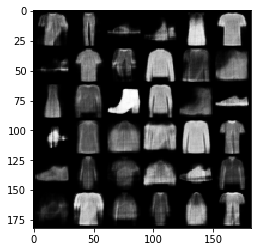

torch.Size([36, 784])


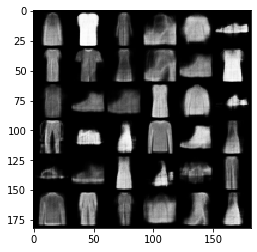

torch.Size([36, 784])


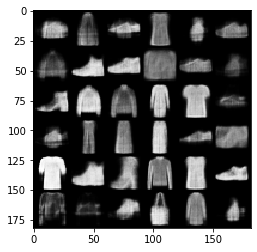

In [ ]:
# Test VAE on a random sample and display on 6X6 grid

################################
# Please fill in your code here:

################################
def show(img):
    img = img.cpu().detach()
    npimg = img.numpy()
    plt.imshow(np.transpose(npimg, (1,2,0)), interpolation='nearest')
    plt.show()


for i in range(0,36):
  x = torch.randn(36,5).cuda()
  decode = vae.decode(x)
  decode_plt = vutils.make_grid(decode.view(decode.shape[0], 1 , 28, 28).detach().cpu(),nrow=6 , padding=2, normalize=True)
  print(decode.shape)
  show(decode_plt)


### Visualize the original vs reconstructed images (TODO)

#################################


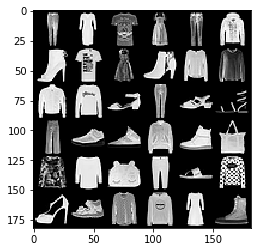

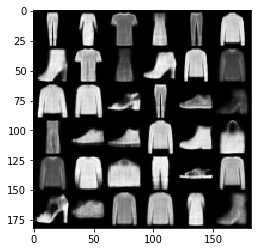

#################################
#################################


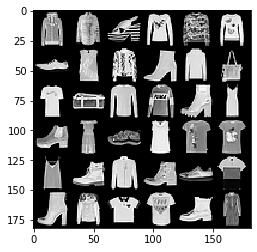

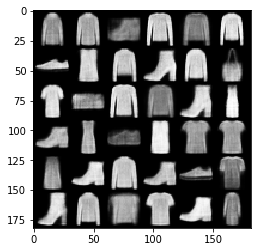

#################################
#################################


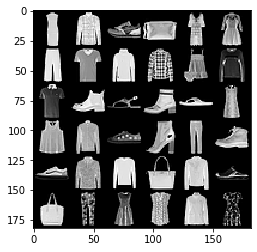

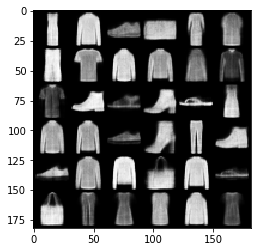

#################################
#################################


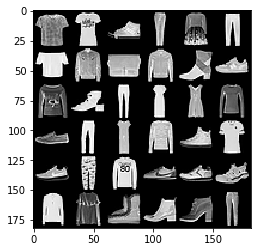

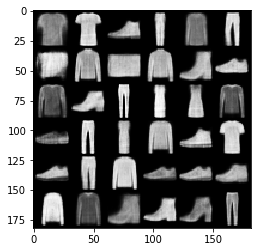

#################################
#################################


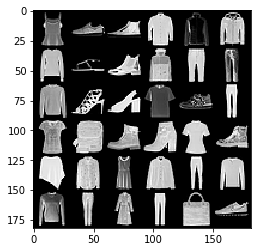

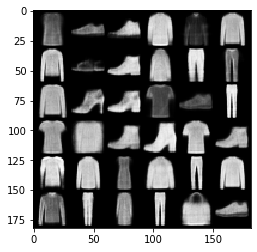

#################################
#################################


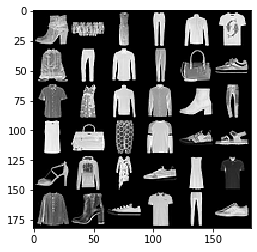

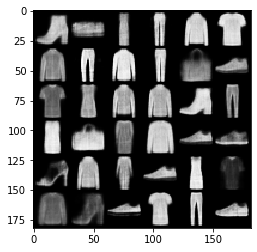

#################################
#################################


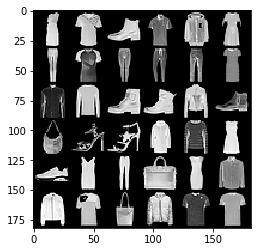

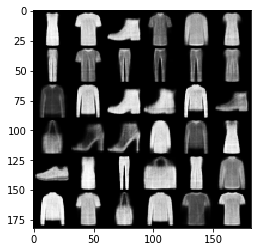

#################################
#################################


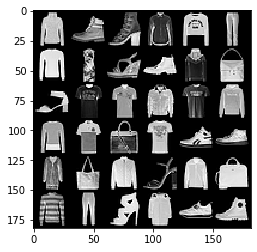

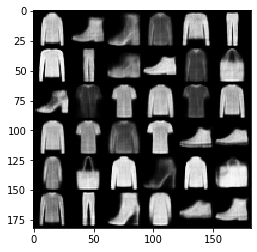

#################################
#################################


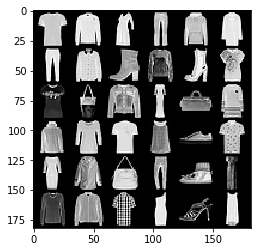

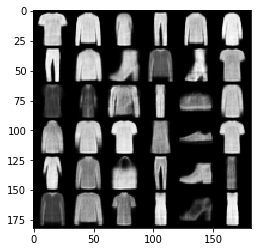

#################################
#################################


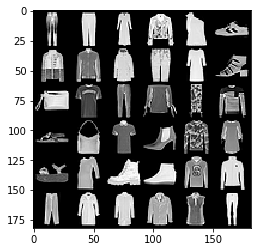

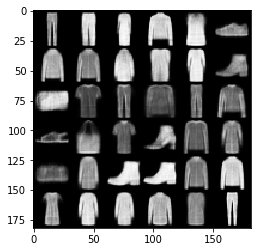

#################################
#################################


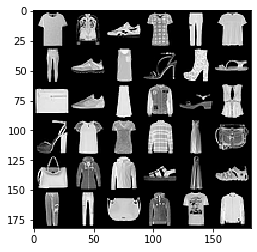

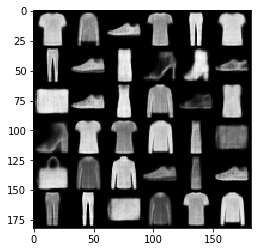

#################################
#################################


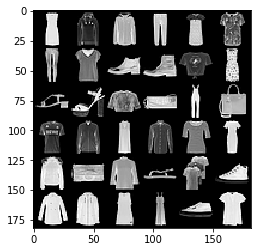

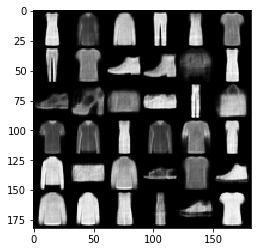

#################################
#################################


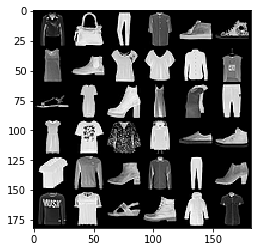

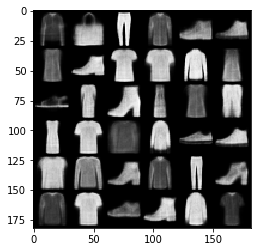

#################################
#################################


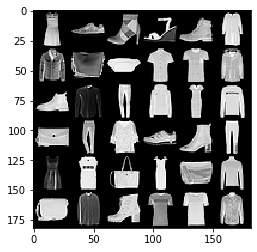

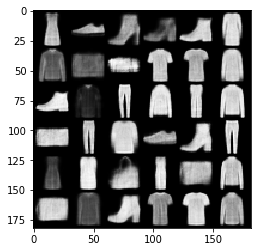

#################################
#################################


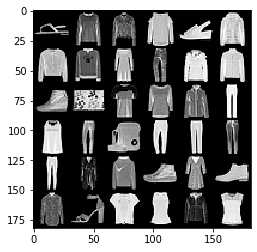

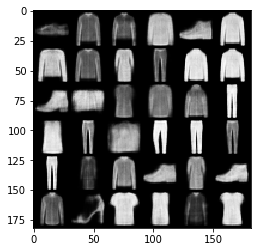

#################################
#################################


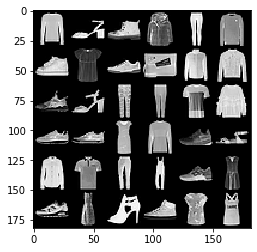

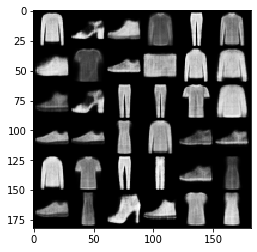

#################################
#################################


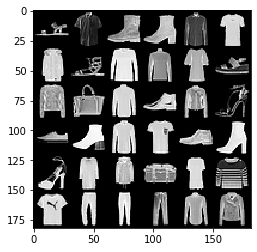

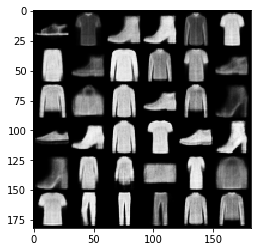

#################################
#################################


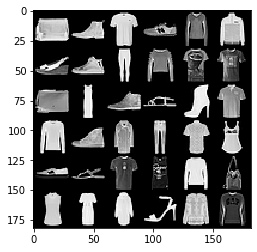

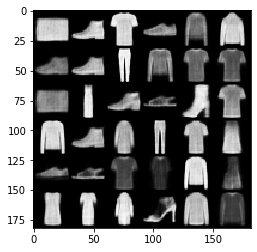

#################################
#################################


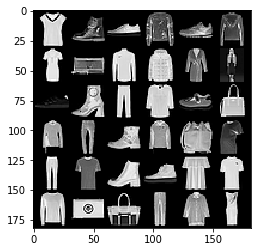

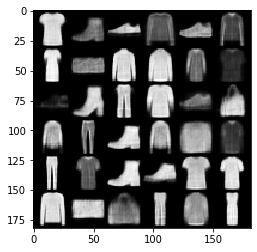

#################################
#################################


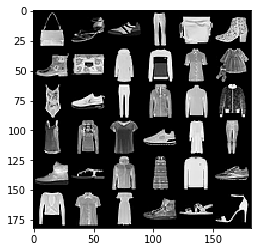

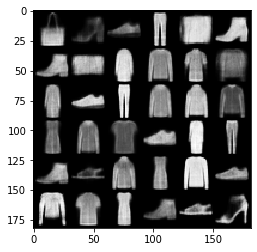

#################################
#################################


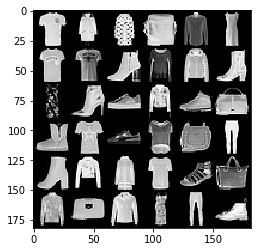

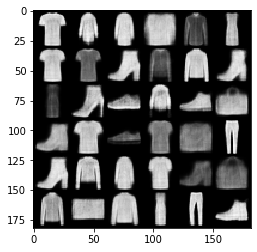

#################################
#################################


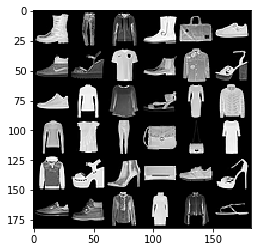

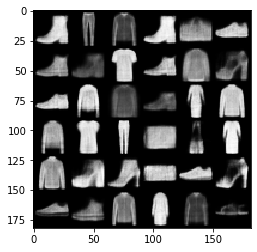

#################################
#################################


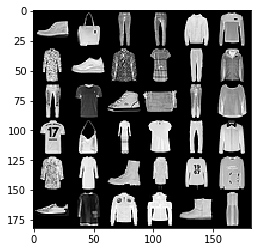

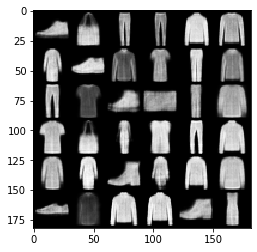

#################################
#################################


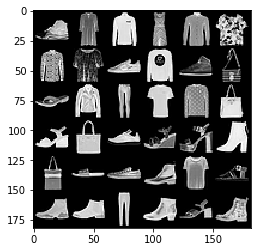

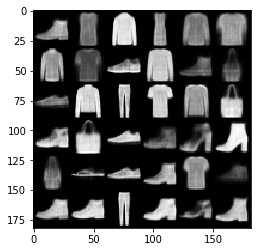

#################################
#################################


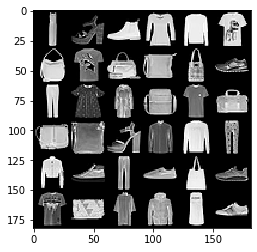

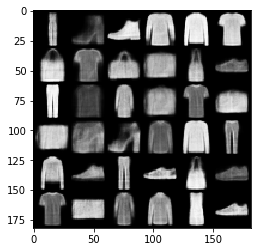

#################################
#################################


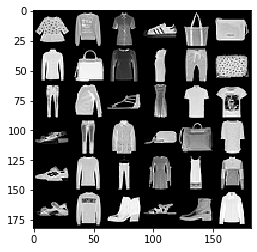

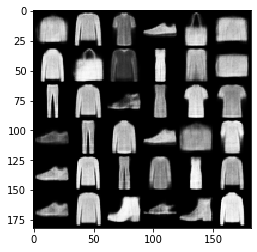

#################################
#################################


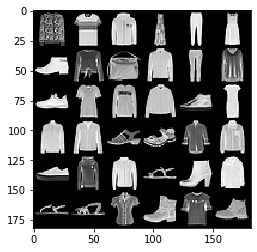

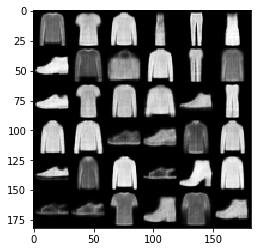

#################################
#################################


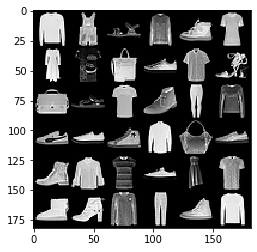

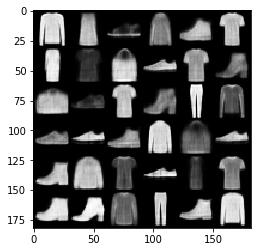

#################################
#################################


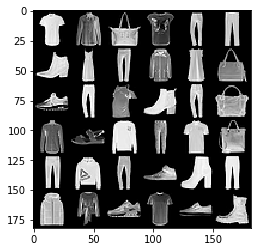

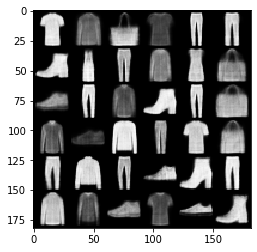

#################################
#################################


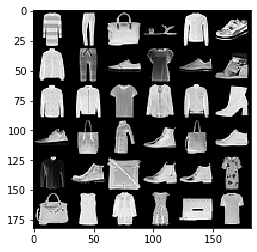

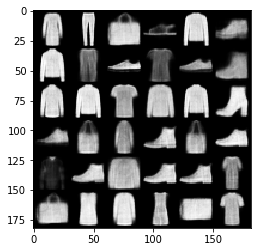

#################################
#################################


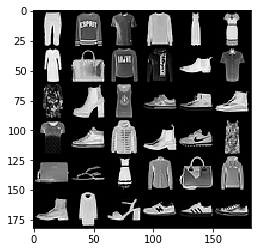

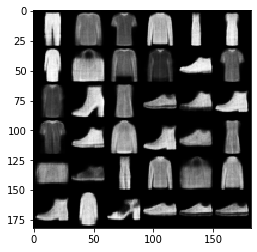

#################################
#################################


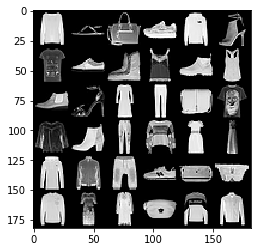

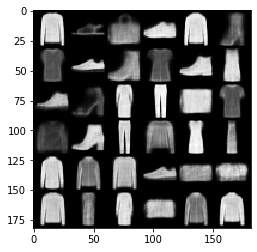

#################################
#################################


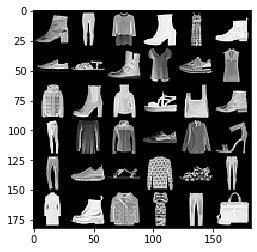

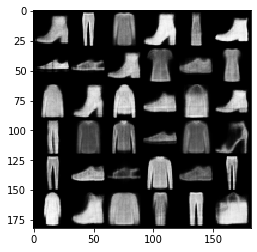

#################################
#################################


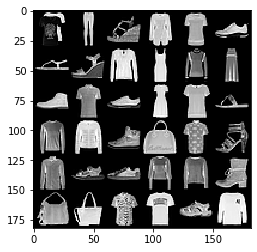

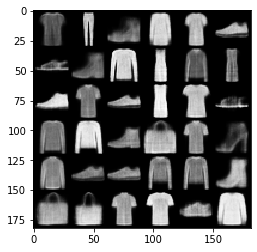

#################################
#################################


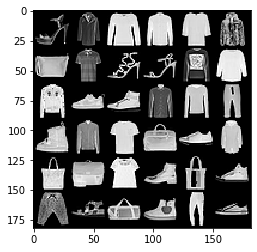

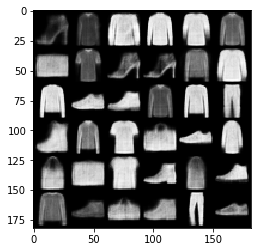

#################################
#################################


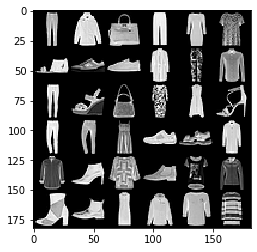

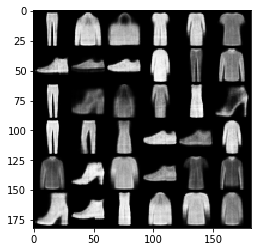

#################################
#################################


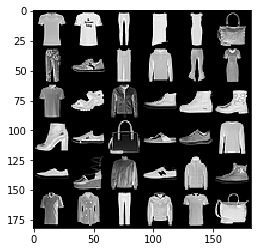

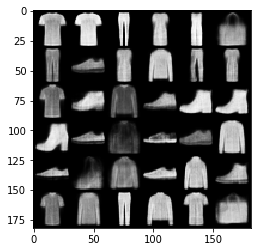

#################################
#################################


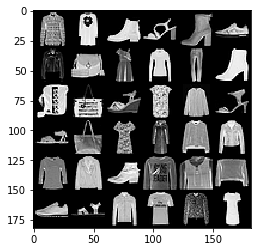

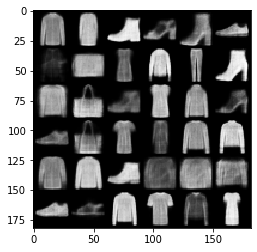

#################################
#################################


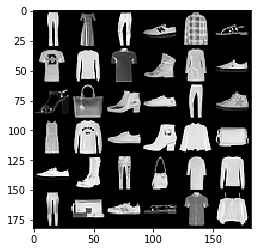

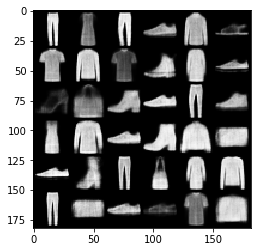

#################################
#################################


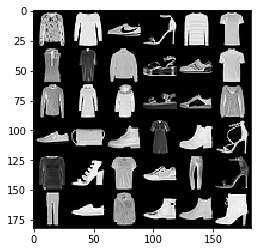

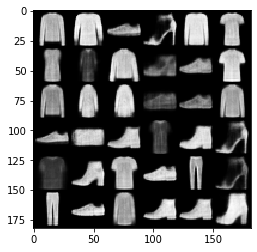

#################################
#################################


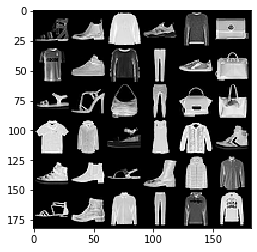

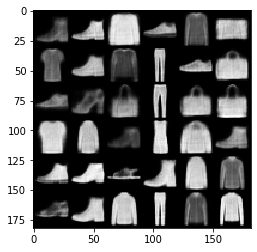

#################################
#################################


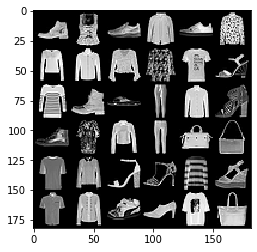

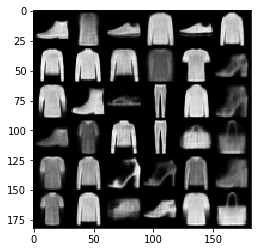

#################################
#################################


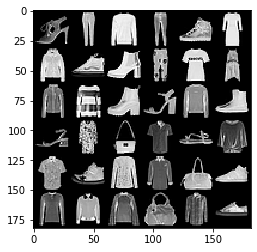

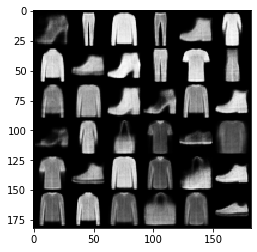

#################################
#################################


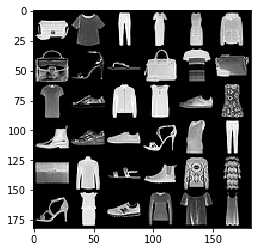

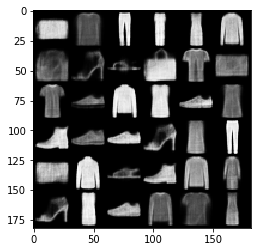

#################################
#################################


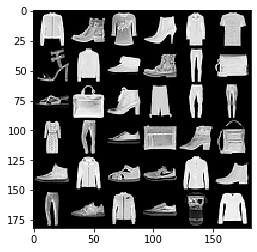

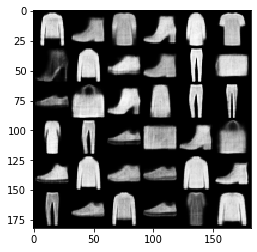

#################################
#################################


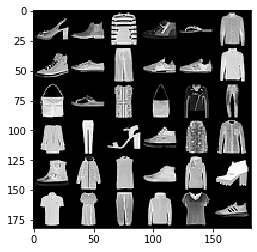

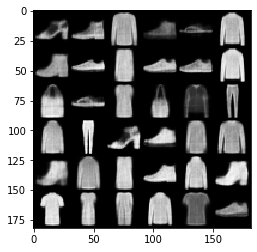

#################################
#################################


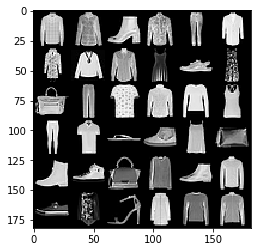

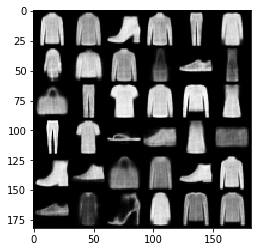

#################################
#################################


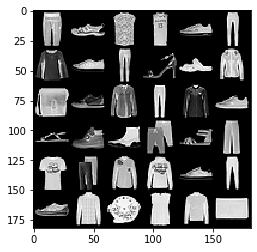

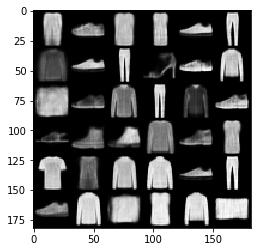

#################################
#################################


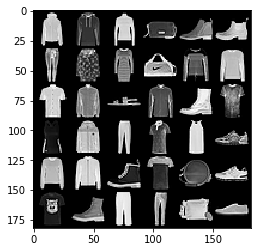

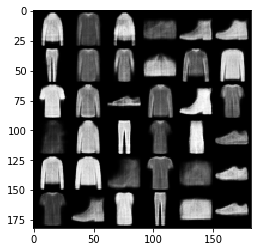

#################################
#################################


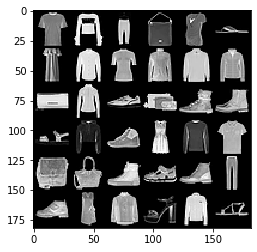

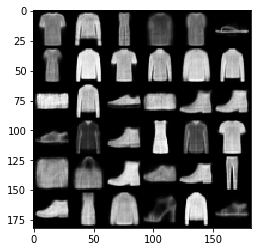

#################################
#################################


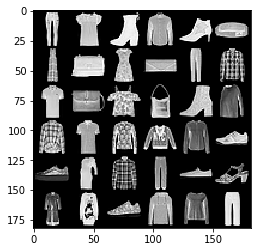

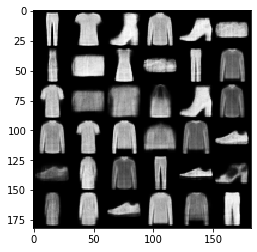

#################################
#################################


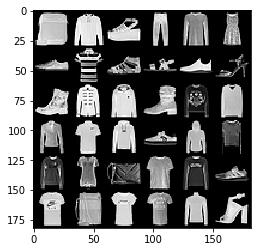

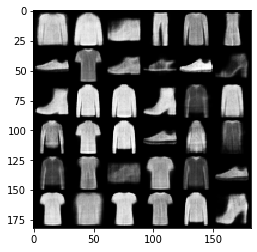

#################################
#################################


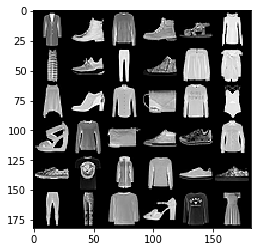

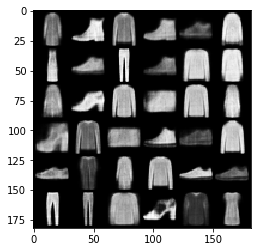

#################################
#################################


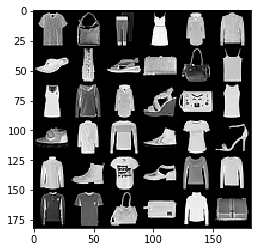

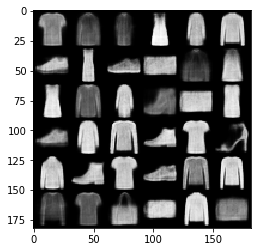

#################################
#################################


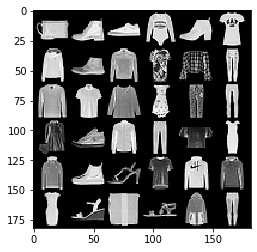

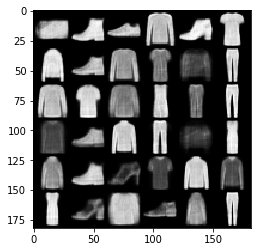

#################################
#################################


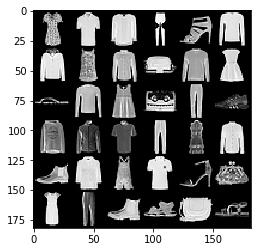

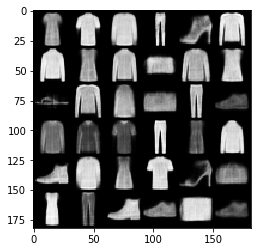

#################################
#################################


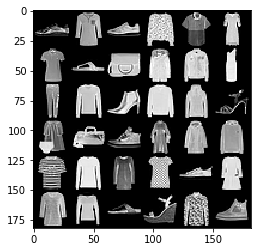

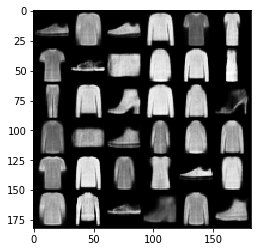

#################################
#################################


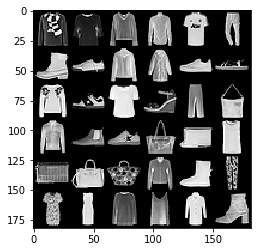

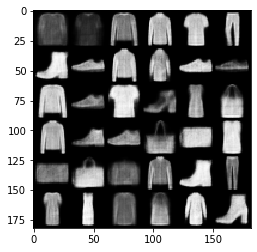

#################################
#################################


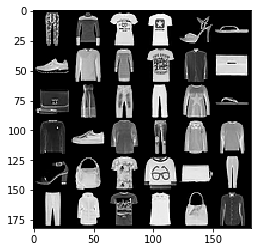

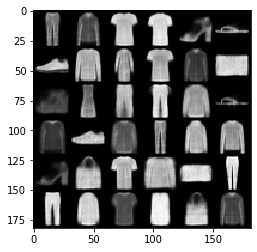

#################################
#################################


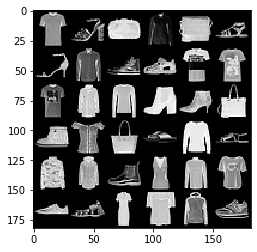

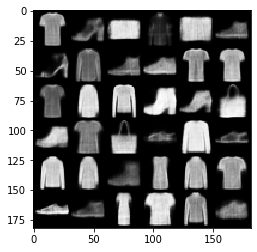

#################################
#################################


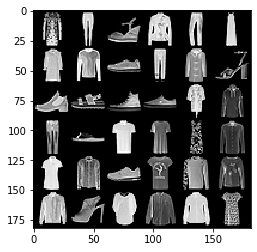

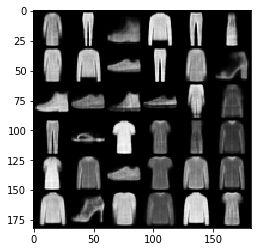

#################################
#################################


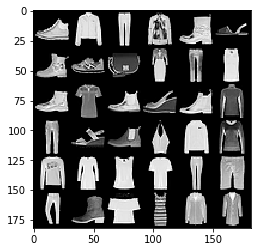

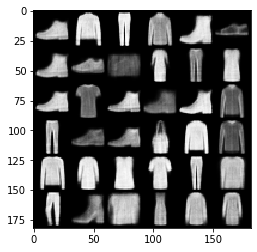

#################################
#################################


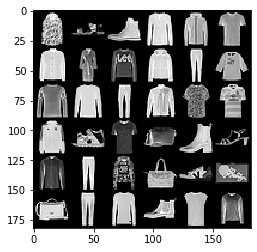

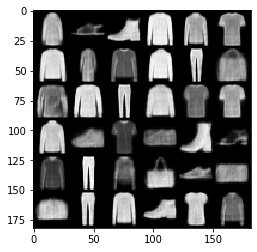

#################################
#################################


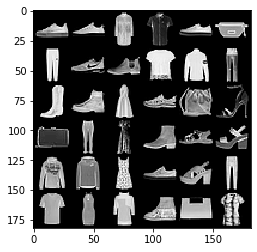

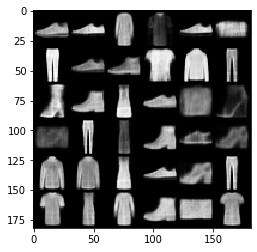

#################################
#################################


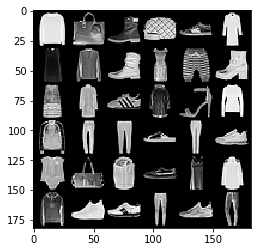

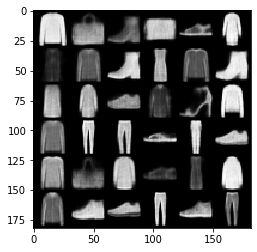

#################################
#################################


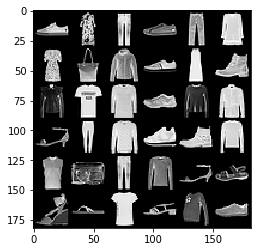

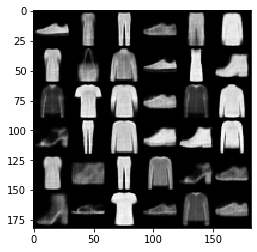

#################################
#################################


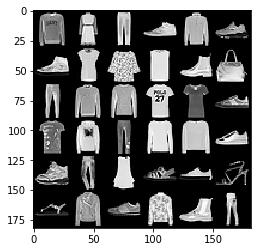

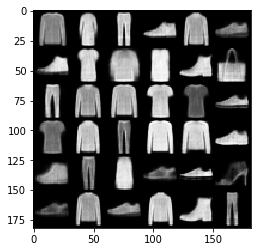

#################################
#################################


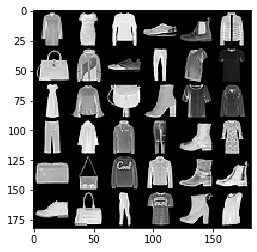

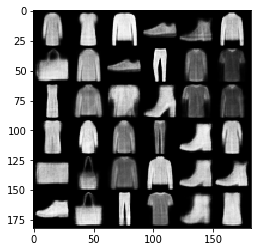

#################################
#################################


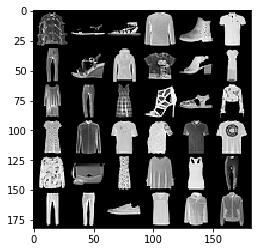

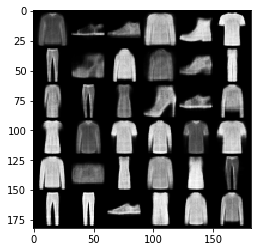

#################################
#################################


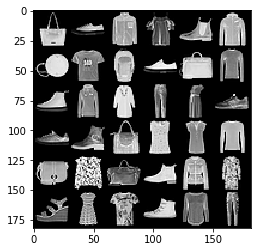

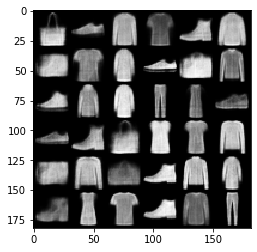

#################################
#################################


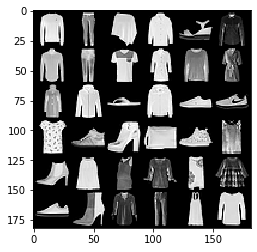

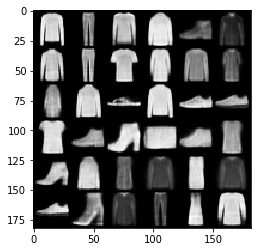

#################################
#################################


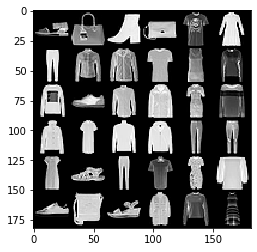

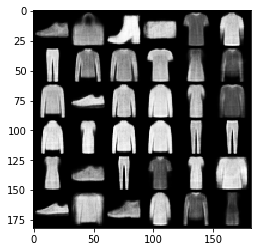

#################################
#################################


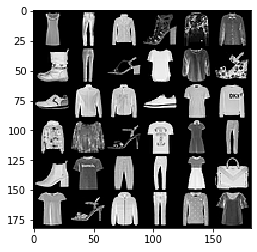

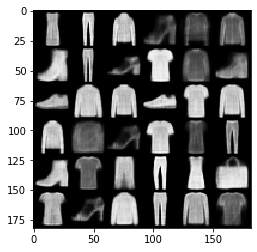

#################################
#################################


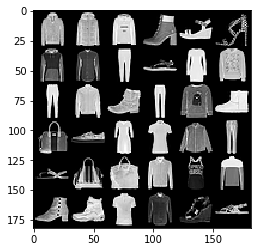

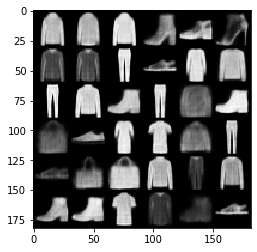

#################################
#################################


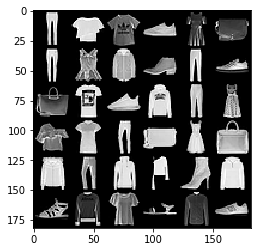

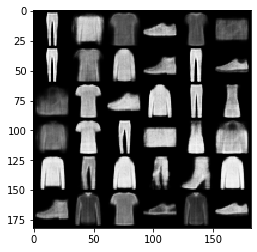

#################################
#################################


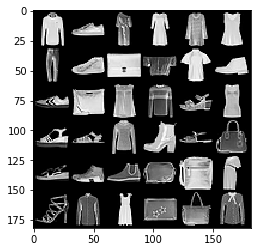

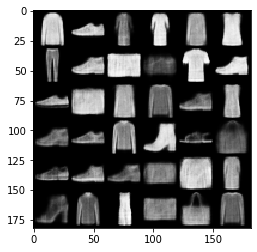

#################################
#################################


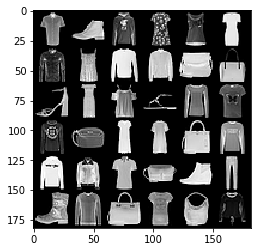

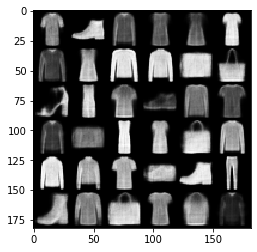

#################################
#################################


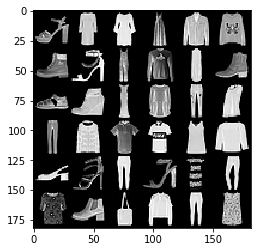

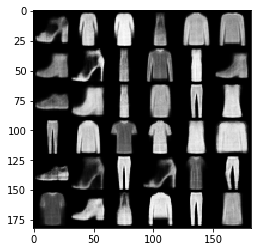

#################################
#################################


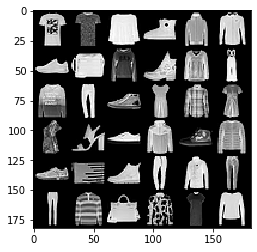

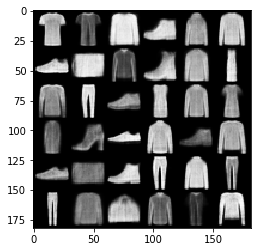

#################################
#################################


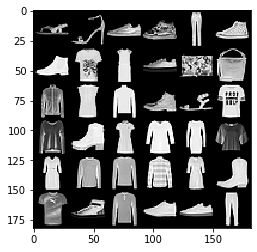

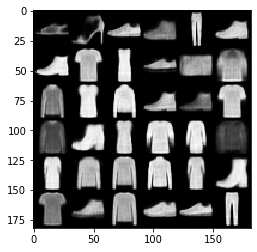

#################################
#################################


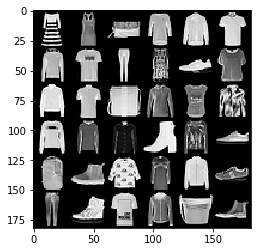

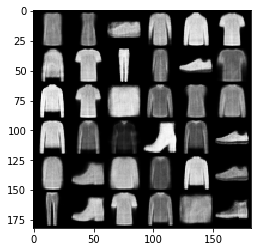

#################################
#################################


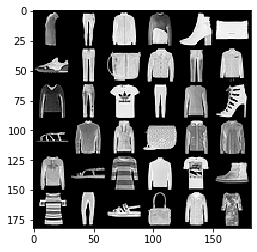

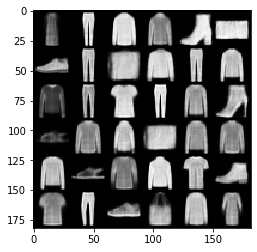

#################################
#################################


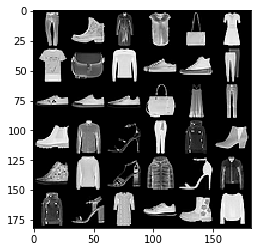

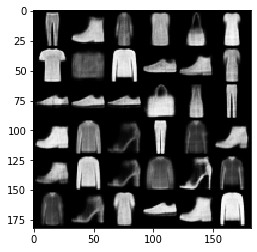

#################################
#################################


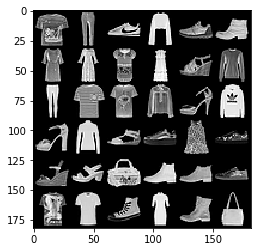

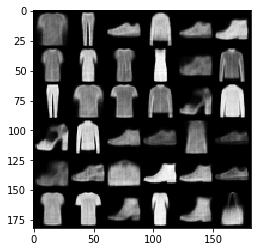

#################################
#################################


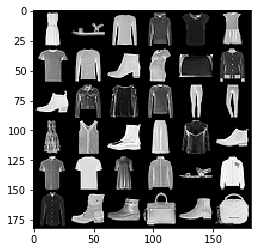

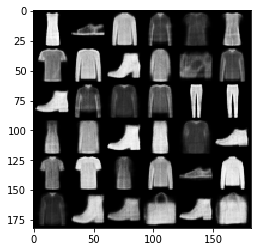

#################################
#################################


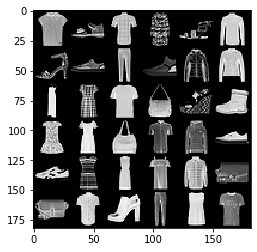

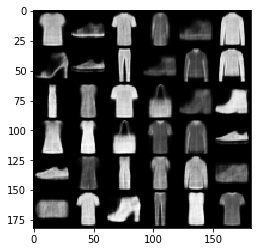

#################################
#################################


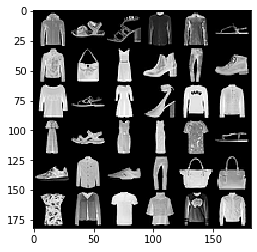

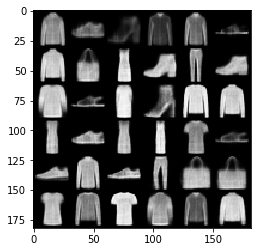

#################################
#################################


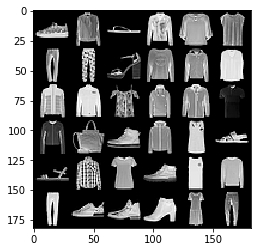

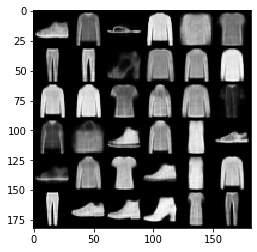

#################################
#################################


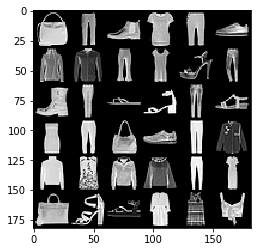

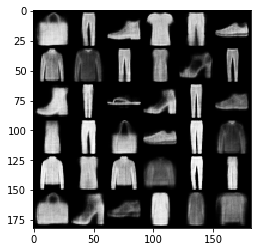

#################################
#################################


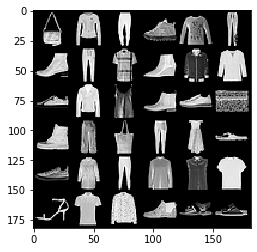

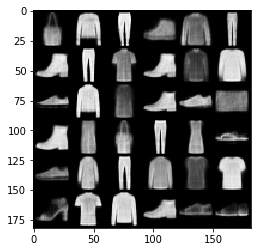

#################################
#################################


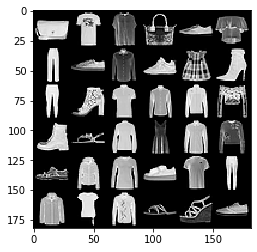

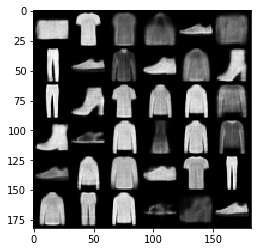

#################################
#################################


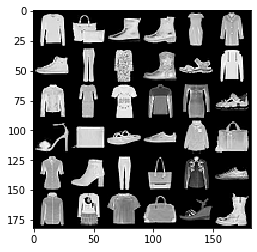

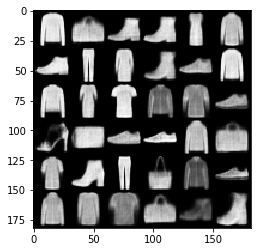

#################################
#################################


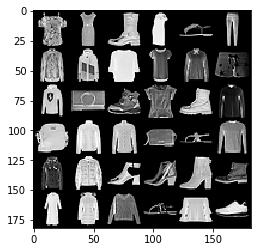

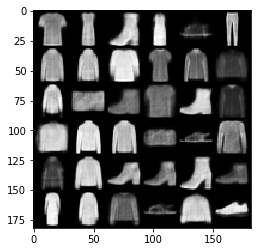

#################################
#################################


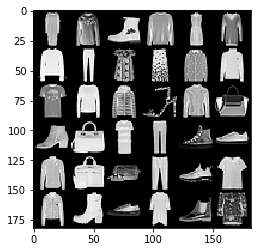

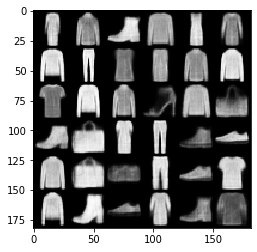

#################################
#################################


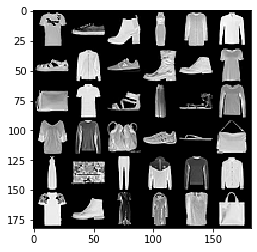

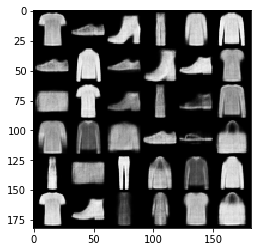

#################################
#################################


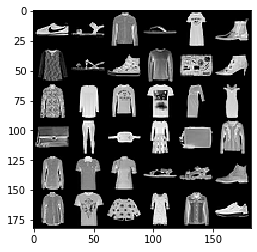

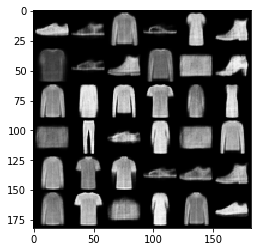

#################################
#################################


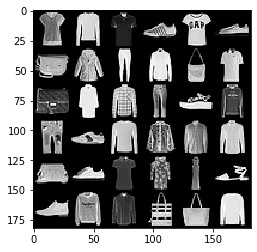

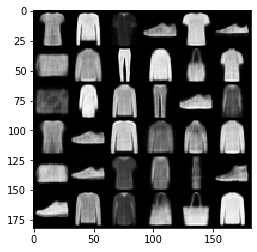

#################################
#################################


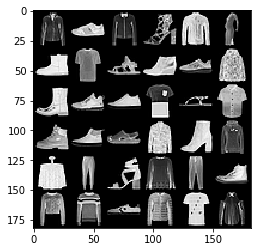

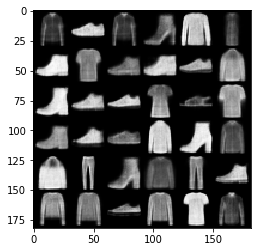

#################################
#################################


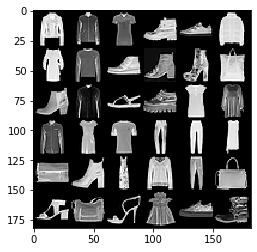

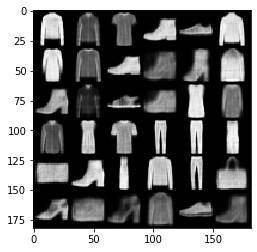

#################################
#################################


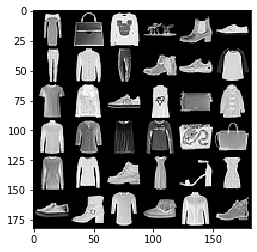

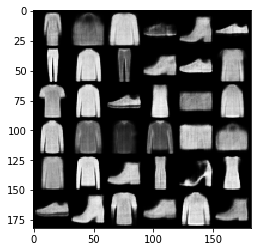

#################################
#################################


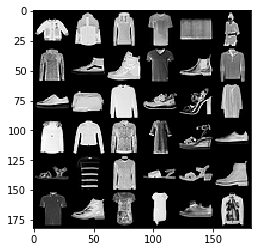

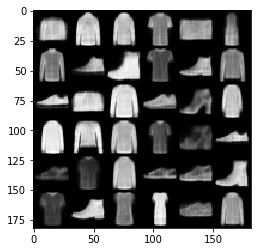

#################################
#################################


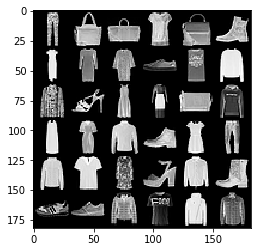

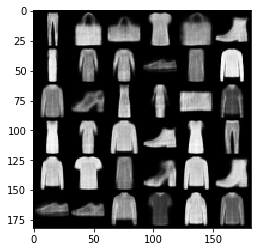

#################################
#################################


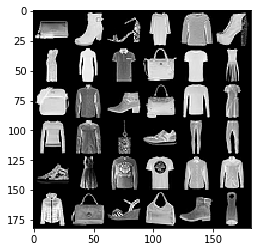

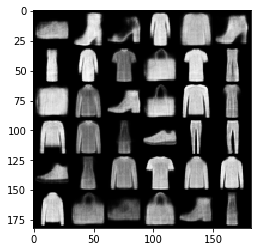

#################################
#################################


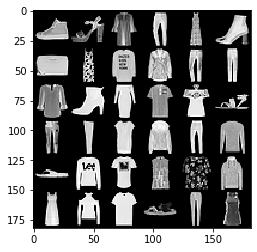

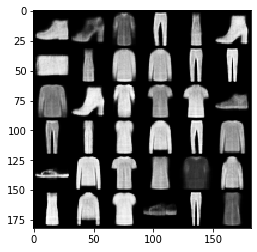

#################################
#################################


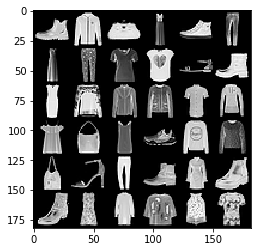

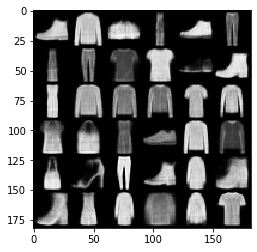

#################################
#################################


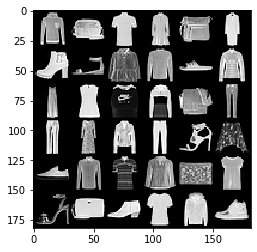

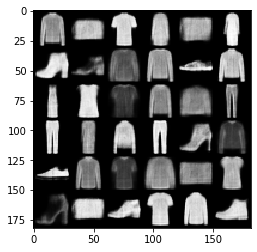

#################################
#################################


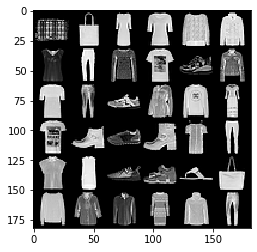

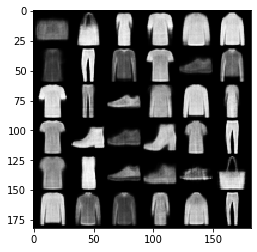

#################################
#################################


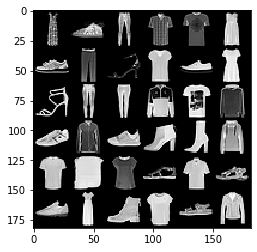

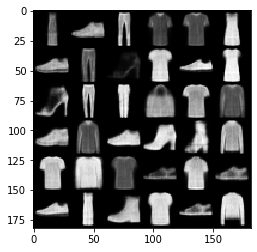

#################################
#################################


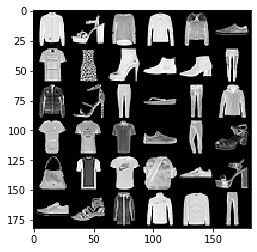

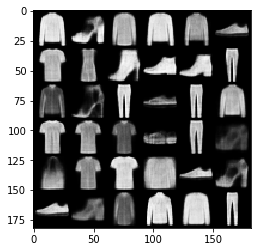

#################################
#################################


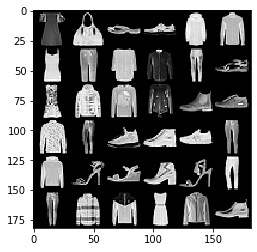

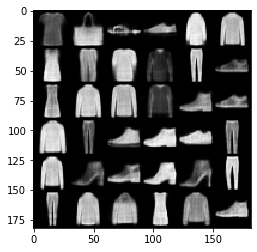

#################################
#################################


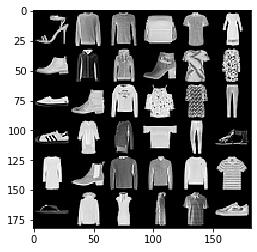

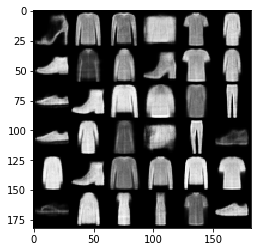

#################################
#################################


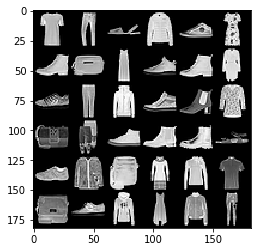

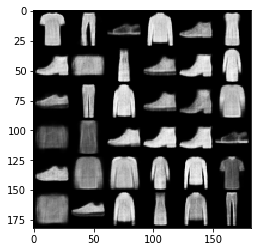

#################################
#################################


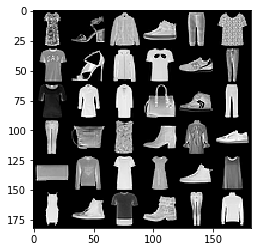

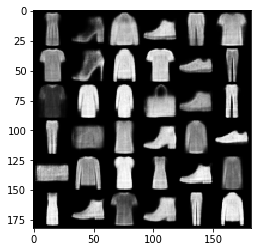

#################################
#################################


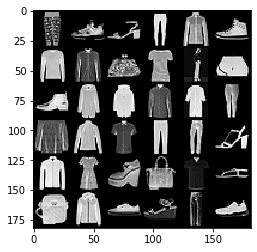

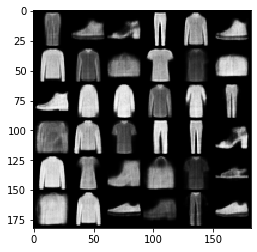

#################################
#################################


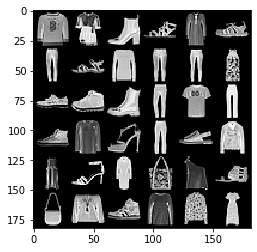

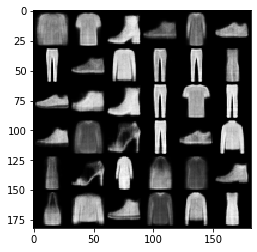

#################################
#################################


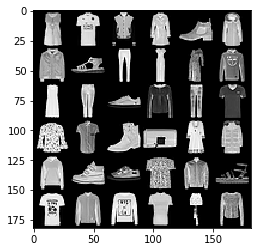

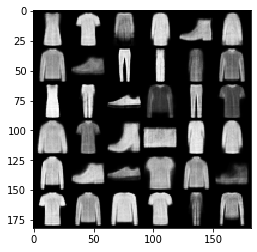

#################################
#################################


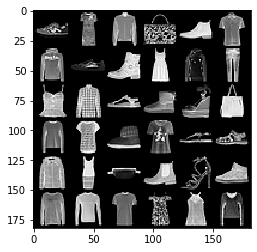

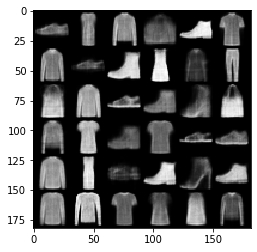

#################################
#################################


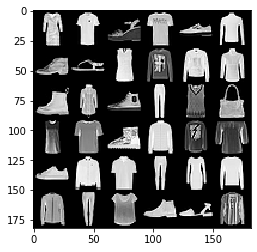

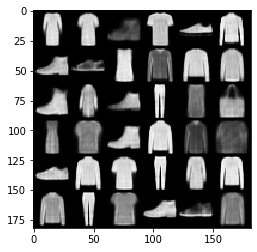

#################################
#################################


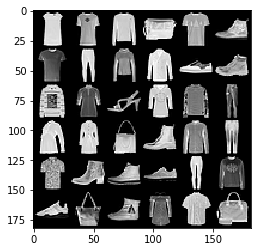

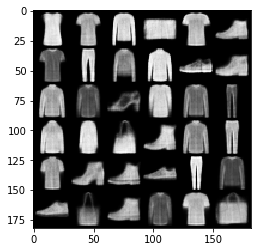

#################################
#################################


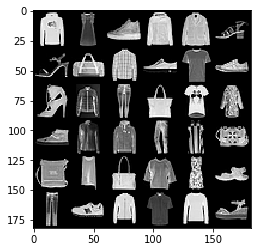

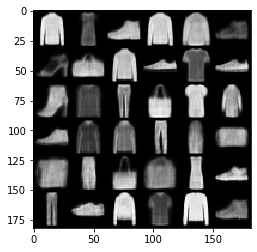

#################################
#################################


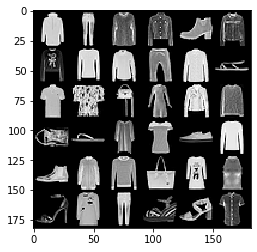

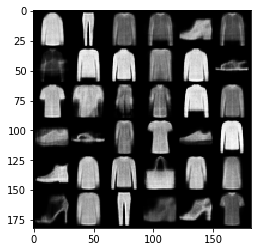

#################################
#################################


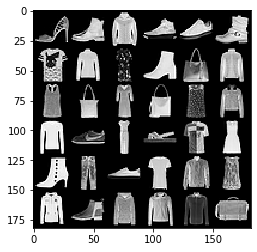

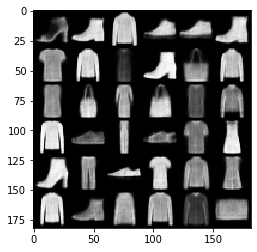

#################################
#################################


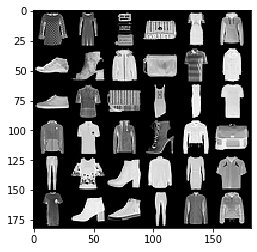

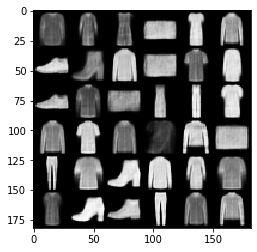

#################################
#################################


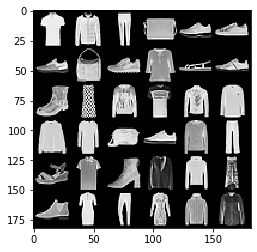

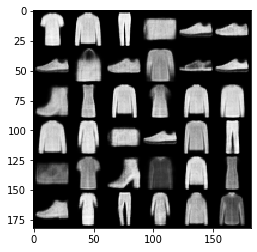

#################################
#################################


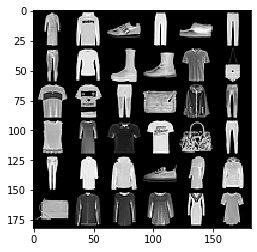

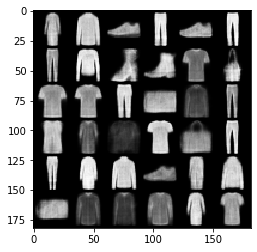

#################################
#################################


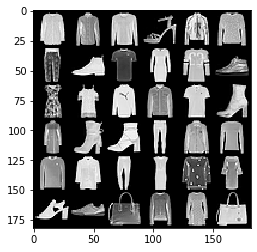

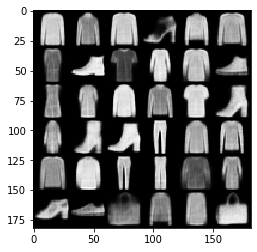

#################################
#################################


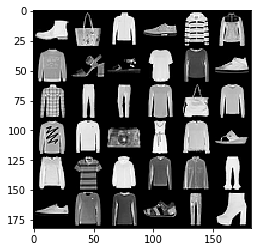

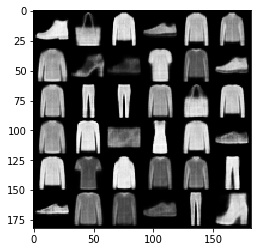

#################################
#################################


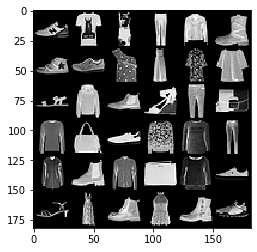

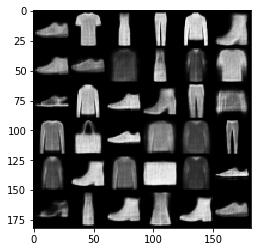

#################################
#################################


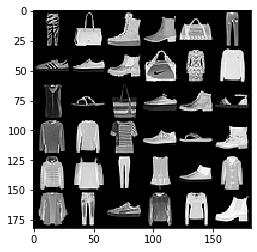

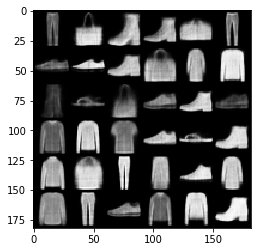

#################################
#################################


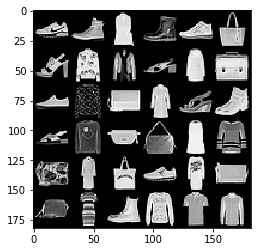

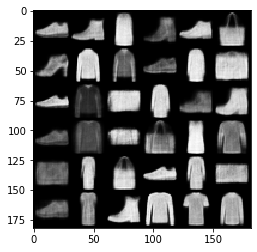

#################################
#################################


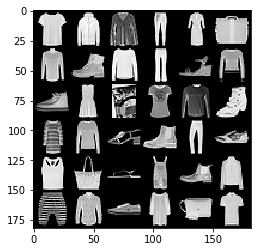

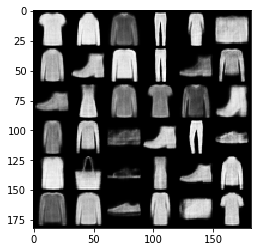

#################################
#################################


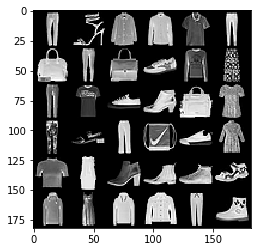

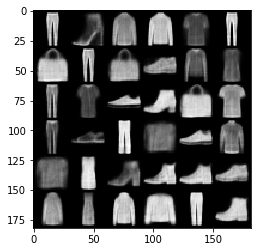

#################################
#################################


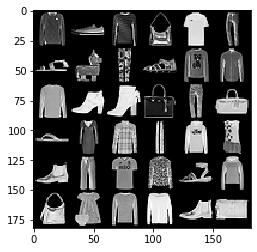

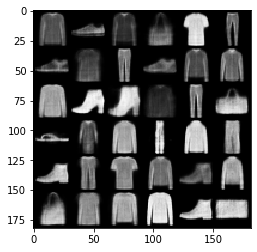

#################################
#################################


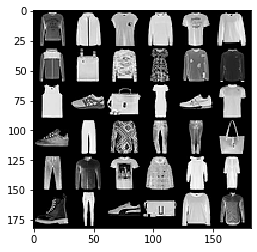

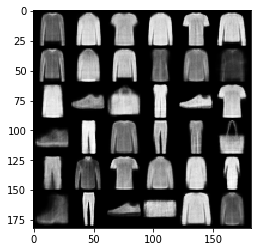

#################################
#################################


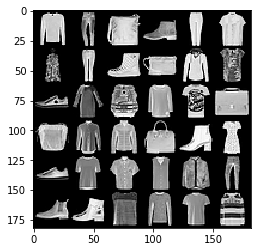

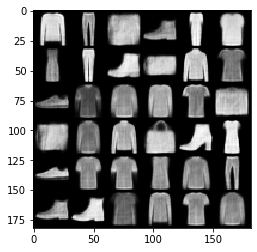

#################################
#################################


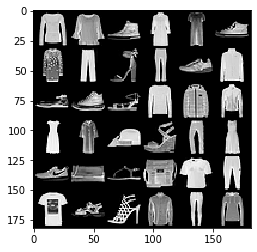

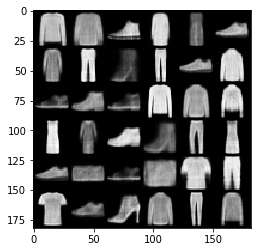

#################################
#################################


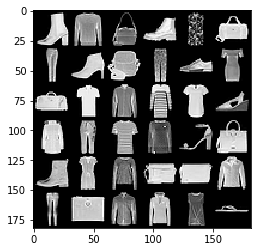

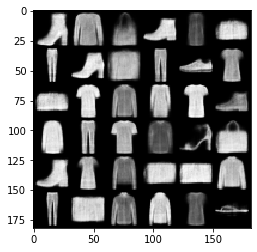

#################################
#################################


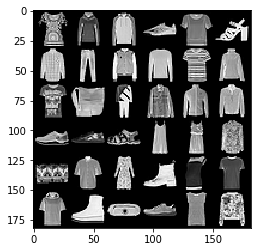

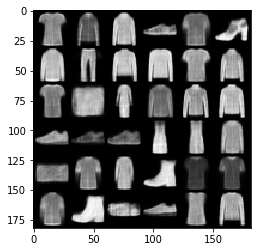

#################################
#################################


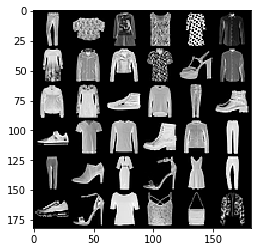

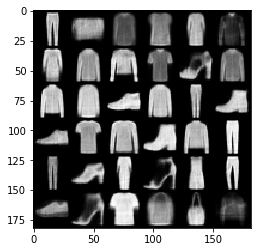

#################################
#################################


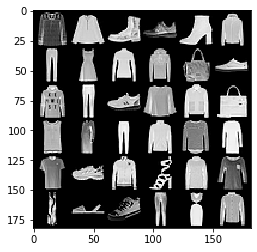

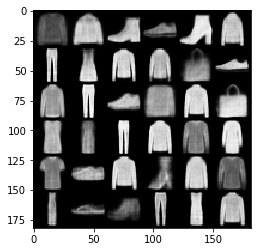

#################################
#################################


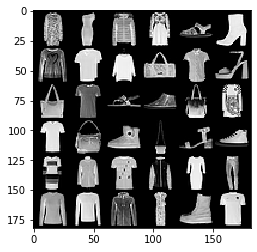

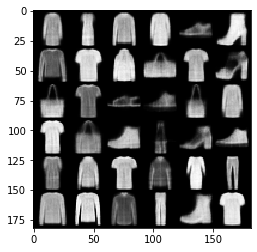

#################################
#################################


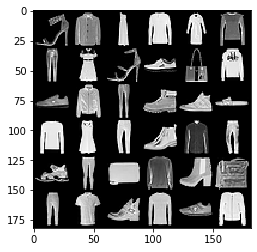

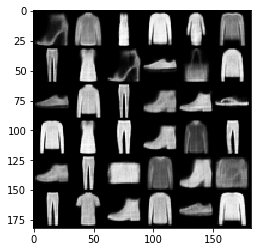

#################################
#################################


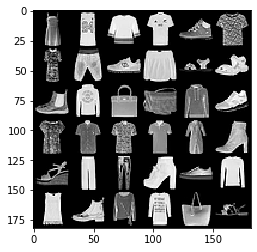

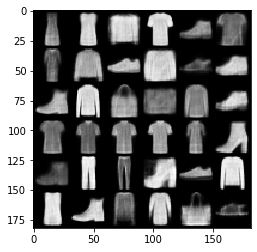

#################################
#################################


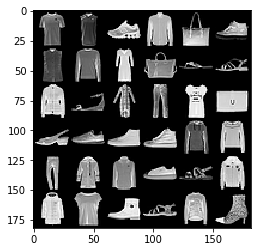

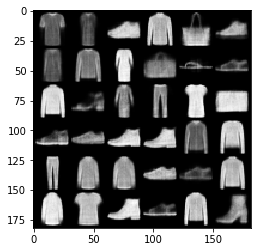

#################################
#################################


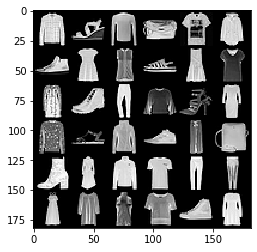

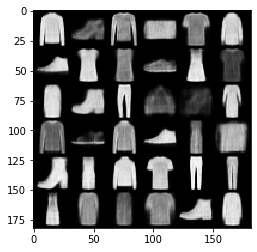

#################################
#################################


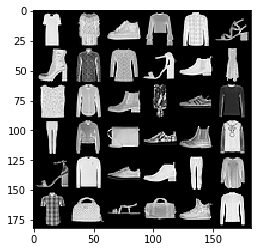

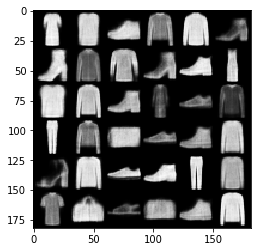

#################################
#################################


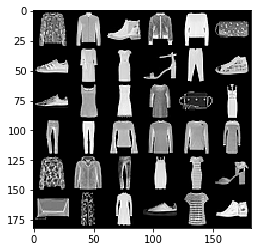

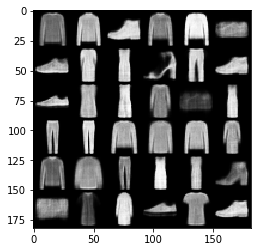

#################################
#################################


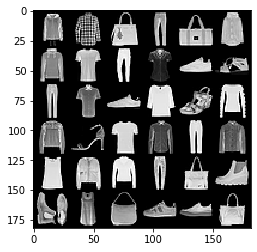

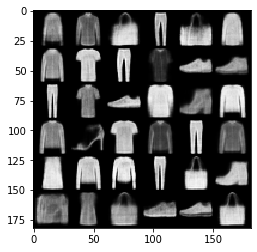

#################################
#################################


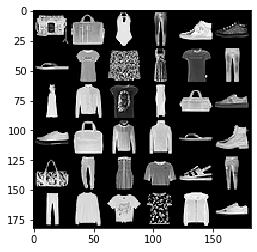

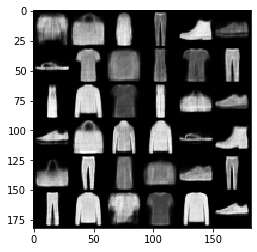

#################################
#################################


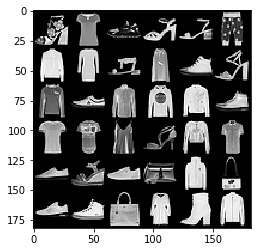

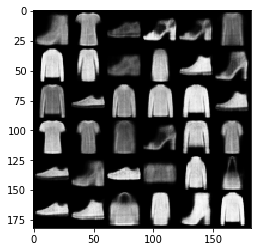

#################################
#################################


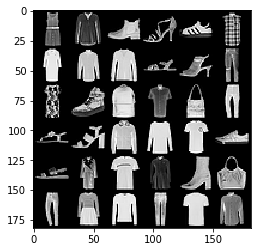

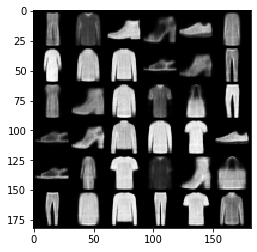

#################################
#################################


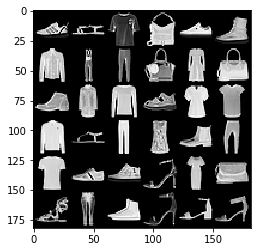

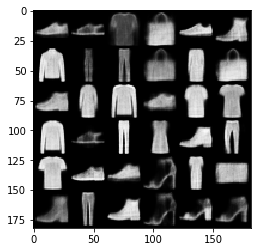

#################################
#################################


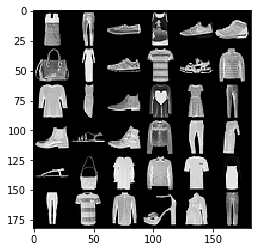

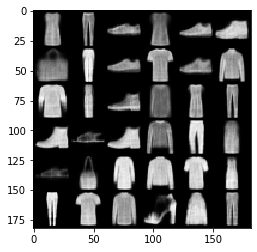

#################################
#################################


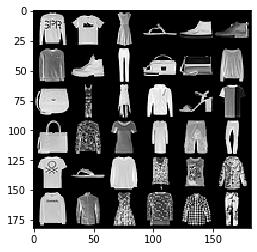

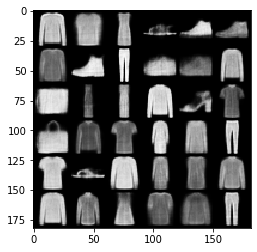

#################################
#################################


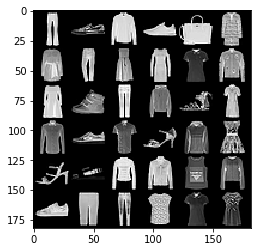

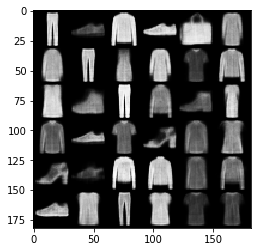

#################################
#################################


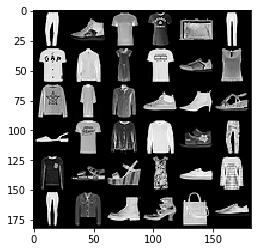

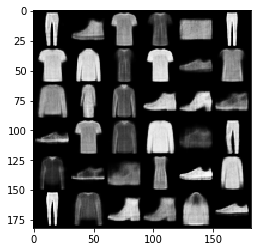

#################################
#################################


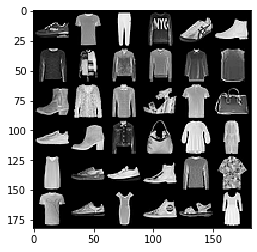

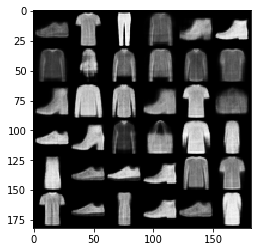

#################################
#################################


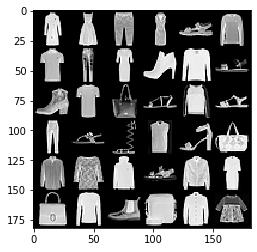

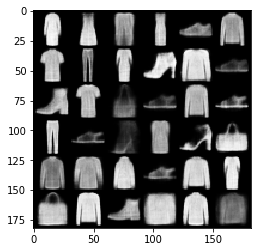

#################################
#################################


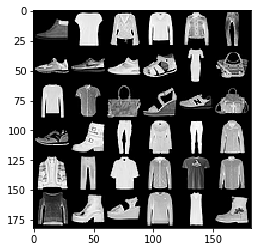

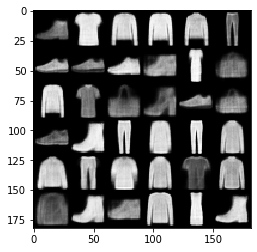

#################################
#################################


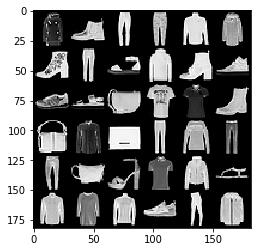

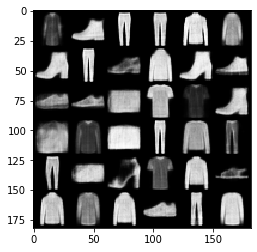

#################################
#################################


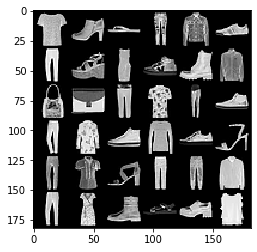

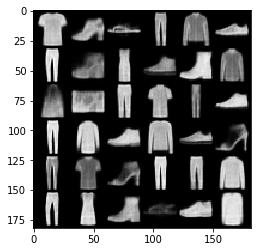

#################################
#################################


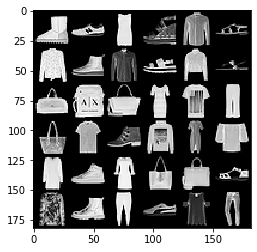

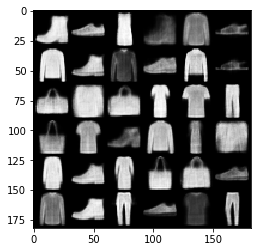

#################################
#################################


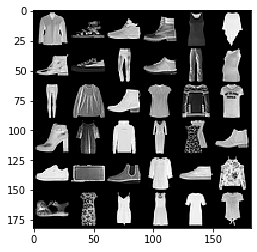

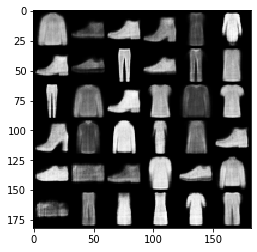

#################################
#################################


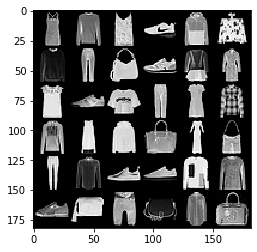

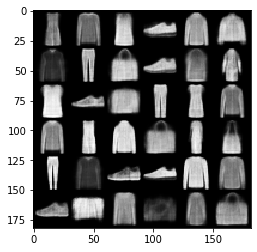

#################################
#################################


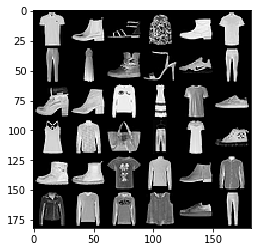

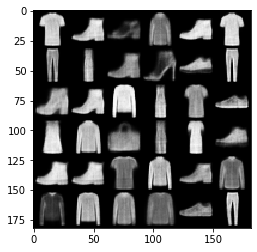

#################################
#################################


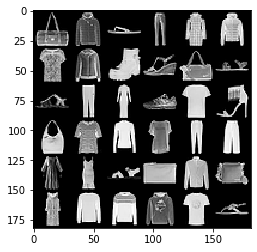

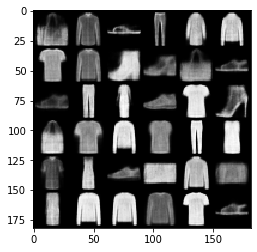

#################################
#################################


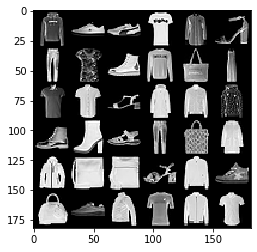

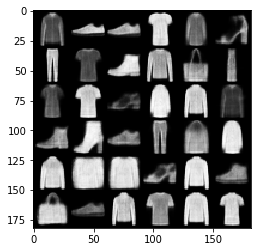

#################################
#################################


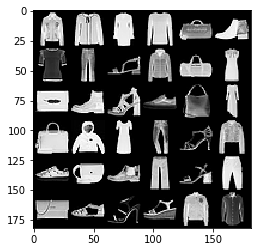

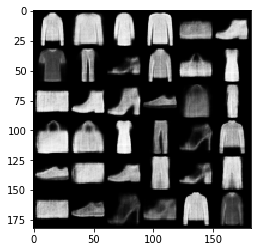

#################################
#################################


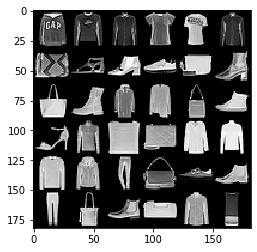

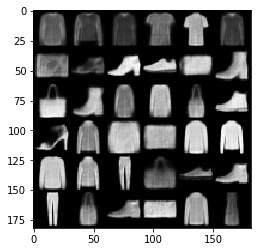

#################################
#################################


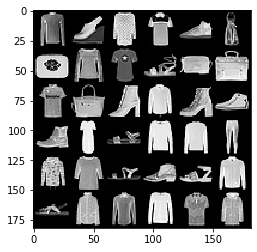

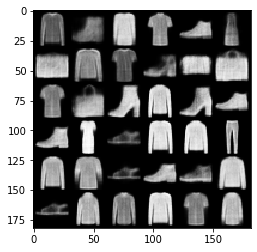

#################################
#################################


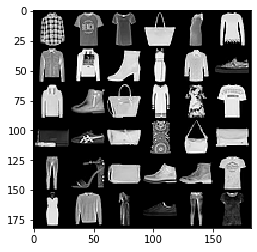

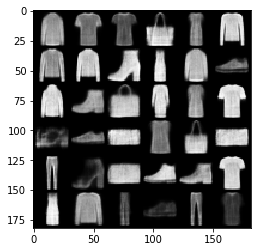

#################################
#################################


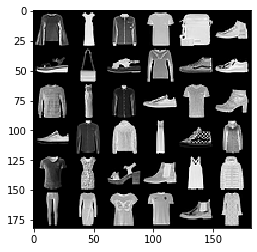

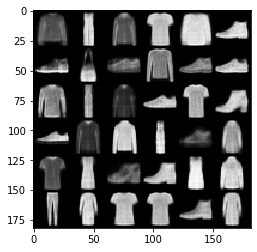

#################################
#################################


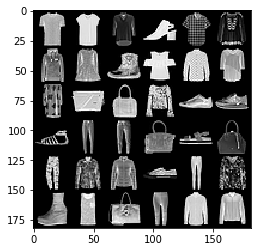

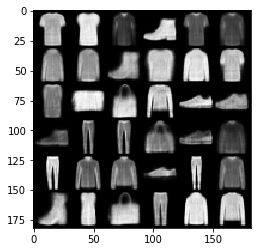

#################################
#################################


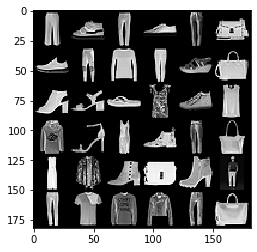

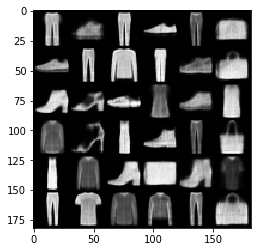

#################################
#################################


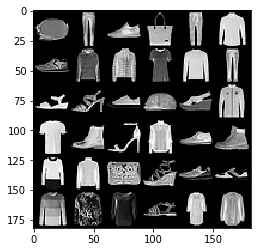

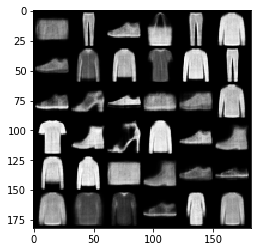

#################################
#################################


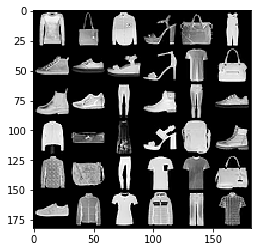

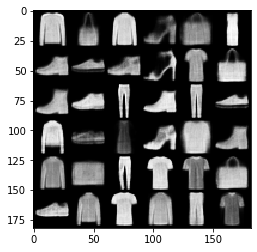

#################################
#################################


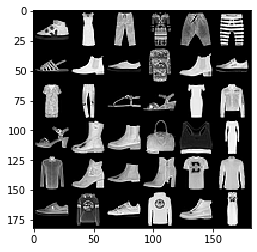

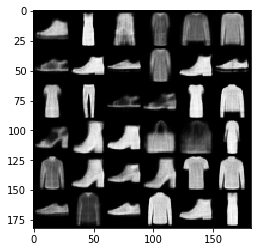

#################################
#################################


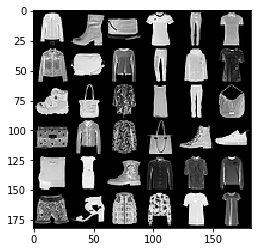

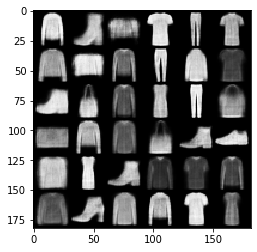

#################################
#################################


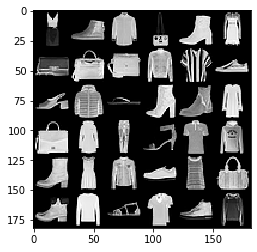

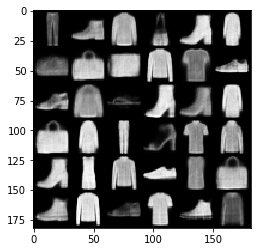

#################################
#################################


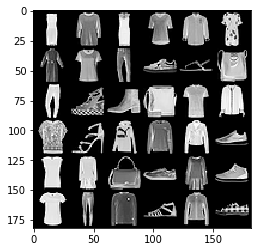

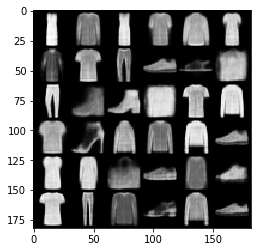

#################################
#################################


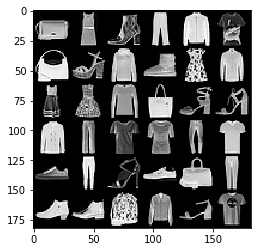

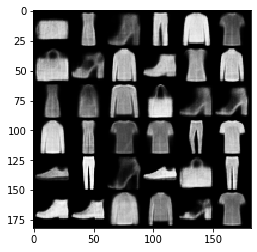

#################################
#################################


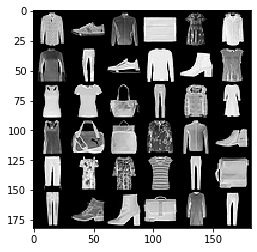

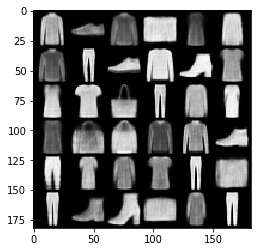

#################################
#################################


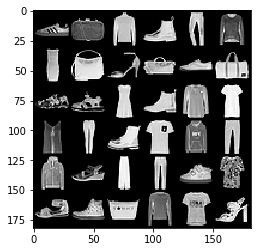

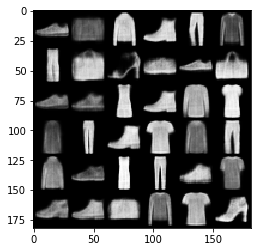

#################################
#################################


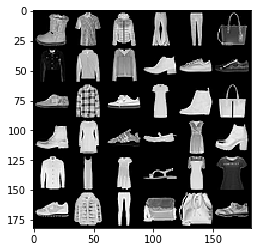

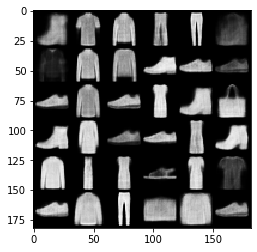

#################################
#################################


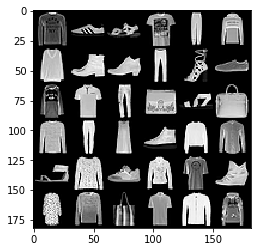

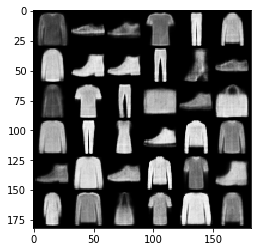

#################################
#################################


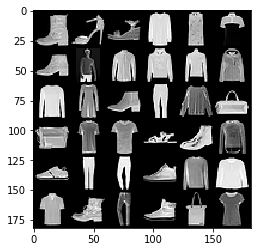

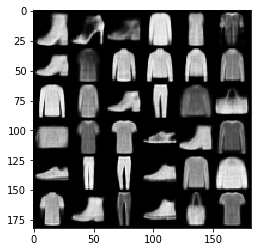

#################################
#################################


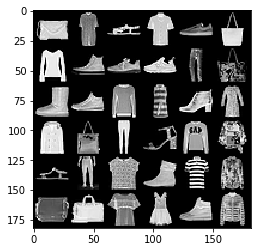

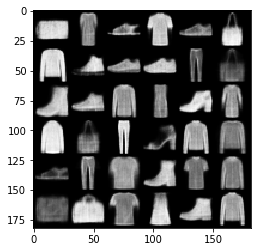

#################################
#################################


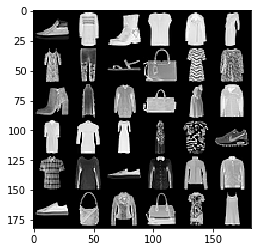

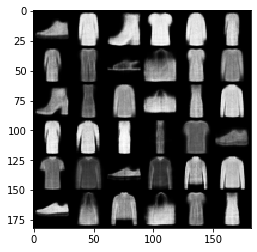

#################################
#################################


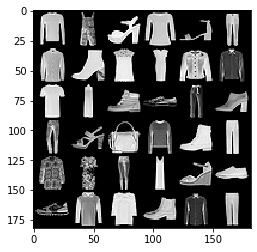

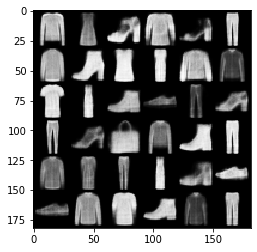

#################################
#################################


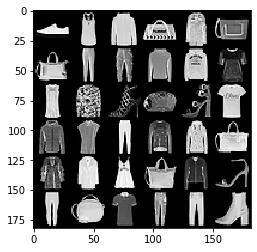

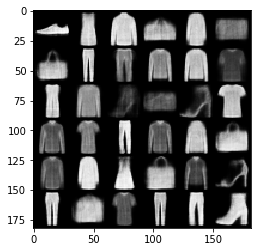

#################################
#################################


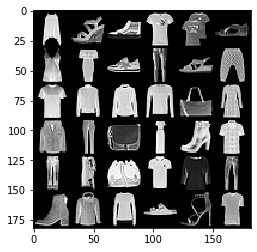

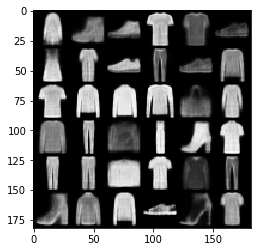

#################################
#################################


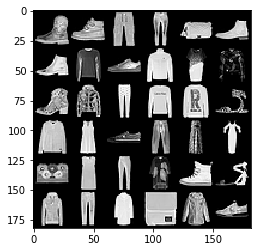

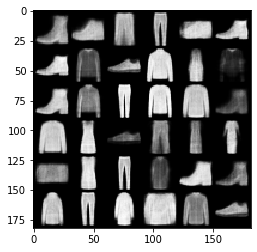

#################################
#################################


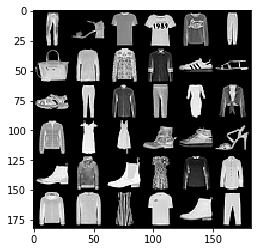

KeyboardInterrupt: ignored

In [ ]:
# Visualise the original vs reconstructed images
# Input the 36 images in Fashion-MNIST to VAE network 
# and display reconstructed output on 6X6 grid

################################
# Please fill in your code here:

################################
test_vis_loader = torch.utils.data.DataLoader(dataset=test_dataset, batch_size=36, shuffle=True)
for batch_idx, (data, _) in enumerate(test_vis_loader):
  #print("COmes in")
  data = data.cuda()
  recon_batch, mean, log_var = vae(data)
  orig_image = vutils.make_grid(data, nrow=6 ,padding=2, normalize=True)
  show_recon = vutils.make_grid(recon_batch.view(recon_batch.shape[0], 1 , 28, 28).detach().cpu(),nrow=6 , padding=2, normalize=True)
  print('#################################')
  show(orig_image)
  show(show_recon)
  print('#################################')


## Quantitative Evaluation (TODO)

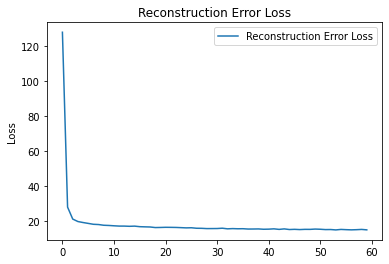

In [ ]:
# Please plot out the reconstruction error curve you saved 
# in 'reconstruction_error' list in training.
# And report the final reconstruction error value
################################
# Please fill in your code here:

################################
plt.title("Reconstruction Error Loss")
plt.plot(reconst_error,label="Reconstruction Error Loss")
plt.ylabel("Loss")
plt.legend()
plt.show()

### VAE IS score

The following block create 2 torch dataset.

In [ ]:
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
model_saved = torch.load('/content/vae_10.pt')
model_vae = VAE(10)
model_vae.load_state_dict(model_saved['vae'])

# Prepare the torch dataset
evaluate_num = 1000
real_set = []
gen_set = []
test_batch_size = 1
test_dataset = datasets.FashionMNIST(root='./mnist_data/', train=False, transform=transforms.ToTensor(), download=False)
test_loader = torch.utils.data.DataLoader(dataset=test_dataset, batch_size=test_batch_size, shuffle=True)

for idx, data in enumerate(test_loader, 0):
    model_vae.eval()
    image = data[0]
    # print(image.shape)
    gen_image, _, _ = model_vae(image)

    # print(gen_image.shape)
    gen_image = gen_image.reshape(-1,28,28).unsqueeze(0)
    # print(gen_image.shape)
    
    image = image.repeat(1,3,1,1)
    gen_image = gen_image.repeat(1,3,1,1)
    real_set.append(image)
    gen_set.append(gen_image)

        
    if idx == evaluate_num-1:
        break

# make the pytorch dataset
real_set = TensorDataset(torch.cat(real_set))
gen_set = TensorDataset(torch.cat(gen_set))


#### IS API
Here you could apply the existed API to compute IS score

In [ ]:
from inception_score import inception_score
import warnings
warnings.filterwarnings("ignore")

print('real images IS_score:')
print(inception_score(real_set, cuda=True, batch_size=64, resize=True, splits=1))

print('generated images IS_score:')
print(inception_score(gen_set, cuda=True, batch_size=64, resize=True, splits=1))

real images IS_score:


Downloading: "https://download.pytorch.org/models/inception_v3_google-1a9a5a14.pth" to /root/.cache/torch/hub/checkpoints/inception_v3_google-1a9a5a14.pth



4.155728487660895
generated images IS_score:
2.8528217180272444


# GAN (please restart you colab session to refresh the GPU memory usage)
### Load data for part 2.1 GAN


In [ ]:
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
from torchvision import datasets, transforms
from torch.autograd import Variable
from torchvision.utils import save_image
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML
import numpy as np
from torch.optim.lr_scheduler import StepLR
import torchvision.utils as vutils
from torch.utils.data import DataLoader, TensorDataset
from scipy import linalg
from scipy.stats import entropy
import tqdm
import cv2
# Resize image to this size
image_size=64

# Setting up transforms to resize and normalize 
transform=transforms.Compose([ transforms.Resize(image_size),
                               transforms.ToTensor(),
                               transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))])

# batchsize of dataset
batch_size = 128

# Load STL-10 Dataset
gan_train_dataset = datasets.STL10(root='./stl10_data/', split='train', transform=transform, download=True)
gan_train_loader = torch.utils.data.DataLoader(dataset=gan_train_dataset, batch_size=batch_size, shuffle=True)

Extracting ./stl10_data/stl10_binary.tar.gz to ./stl10_data/


## Model Definition (TODO)

In [ ]:
class DCGAN_Generator(nn.Module):
    def __init__(self):
        super(DCGAN_Generator,self).__init__()
        ################################
        # Please fill in your code here:
        # self.layer =  nn.Sequential()
        ################################
        self.layer = nn.Sequential(
            #1st Conv
            nn.ConvTranspose2d(100,1024,kernel_size=(4,4),stride=1,padding=0),
            nn.BatchNorm2d(1024),
            nn.ReLU(),
            #2nd Conv
            nn.ConvTranspose2d(1024,512,kernel_size=(4,4),stride=2,padding=1),
            nn.BatchNorm2d(512),
            nn.ReLU(),
            #3rd Conv
            nn.ConvTranspose2d(512,256,kernel_size=(4,4),stride=2,padding=1),
            nn.BatchNorm2d(256),
            nn.ReLU(),
            #4th Conv
            nn.ConvTranspose2d(256,128,kernel_size=(4,4),stride=2,padding=1),
            nn.BatchNorm2d(128),
            nn.ReLU(),
            #5th Conv
            nn.ConvTranspose2d(128,3,kernel_size=(4,4),stride=2,padding=1),
            nn.Tanh()  
            
        )

    
    def forward(self, input):
      return self.layer(input)


class DCGAN_Discriminator(nn.Module):
    def __init__(self):
        super(DCGAN_Discriminator, self).__init__()
        ################################
        # Please fill in your code here:
        # self.layer =  nn.Sequential()
        ################################
        self.layer = nn.Sequential(
            #1st Conv
            nn.Conv2d(3,128,kernel_size=(4,4),stride=(2,2),padding=(1,1)),
            nn.LeakyReLU(negative_slope= 0.2, inplace=True),
            #2nd Conv
            nn.Conv2d(128,256,kernel_size=(4,4),stride=(2,2),padding=(1,1)),
            nn.BatchNorm2d(256),
            nn.LeakyReLU(negative_slope= 0.2, inplace=True),
            #3rd Conv
            nn.Conv2d(256,512,kernel_size=(4,4),stride=(2,2),padding=(1,1)),
            nn.BatchNorm2d(512),
            nn.LeakyReLU(negative_slope= 0.2, inplace=True),
            #4th Conv
            nn.Conv2d(512,1024,kernel_size=(4,4),stride=(2,2),padding=(1,1)),
            nn.BatchNorm2d(1024),
            nn.LeakyReLU(negative_slope= 0.2, inplace=True),
            #5th Conv
            nn.Conv2d(1024,1,kernel_size=(4,4),stride=(1,1),padding=0),
            nn.Sigmoid()  
            
        )

    def forward(self, input):      
      return self.layer(input)

## GAN Training

### GAN loss (TODO)

In [ ]:
import torch
fake = torch.load('test_case_GAN/fake.pt')
netD = torch.load('test_case_GAN/netD.pt')
real = torch.load('test_case_GAN/real.pt')
netG = torch.load('test_case_GAN/netG.pt')
noise = torch.load('test_case_GAN/noise.pt')
Valid_label = torch.load('test_case_GAN/Valid_label.pt')
Fake_label = torch.load('test_case_GAN/Fake_label.pt')
criterion = torch.load('test_case_GAN/criterion.pt')
discriminator = DCGAN_Discriminator()
generator = DCGAN_Generator()

def loss_discriminator(D, real, G, noise, Valid_label, Fake_label, criterion):
    '''
    1. Forward real images into the discriminator
    2. Compute loss between Valid_label and dicriminator output on real images
    3. Forward noise into the generator to get fake images
    4. Forward fake images to the discriminator
    5. Compute loss between Fake_label and discriminator output on fake images
    6. sum real loss and fake loss as the loss_D
    7. we also need to output fake images generate by G(noise) for loss_generator computation
    '''
    #pdb.set_trace()
    loss_disc = nn.BCELoss()
    dis_out = D(real)
    dis_out = dis_out.view(-1)
    loss_real = loss_disc(dis_out,Valid_label)
    fake = G(noise)
    dis_fake = D(fake.detach()).view(-1)
    loss_fake = loss_disc(dis_fake,Fake_label)
    loss_D = loss_real + loss_fake
    return loss_D, fake

def loss_generator(netD, fake, Valid_label, criterion):
    '''
    1. Forward fake images to the discriminator
    2. Compute loss between valid labels and discriminator output on fake images
    '''
    loss_disc = nn.BCELoss()
    dis_fake = netD(fake).view(-1)
    loss_G = loss_disc(dis_fake,Valid_label)

    return loss_G


# loss_D, fake_G = loss_discriminator(netD, real, netG, noise, Valid_label, Fake_label, criterion)
# # torch.save(loss_D, 'test_case_GAN/loss_D.pt')
# loss_G = loss_generator(netD, fake, Valid_label, criterion)
# # torch.save(loss_G, 'test_case_GAN/loss_G.pt')



# test_loss_D = torch.load('test_case_GAN/loss_D.pt')
# test_loss_G = torch.load('test_case_GAN/loss_G.pt')
# print("netD",netD)
# print("Valiid ",Valid_label.shape)

# print('test case loss_D:', test_loss_D.item())
# print('computed loss_D:', loss_D.item())

# print('test case loss_G:', test_loss_G.item())
# print('computed loss_G:', loss_G.item())


In [ ]:
import torchvision.utils as vutils
from torch.optim.lr_scheduler import StepLR
import pdb

device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
torch.backends.cudnn.benchmark = True
# Number of channels
nc = 3
# Size of z latent vector (i.e. size of generator input)
nz = 100
# Size of feature maps in generator
ngf = 128
# Size of feature maps in discriminator
ndf = 128


# custom weights initialization called on netG and netD
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

# Create the generator and discriminator
netG = DCGAN_Generator().to(device)
netD = DCGAN_Discriminator().to(device)

# Apply weight initialization
netG.apply(weights_init)
netD.apply(weights_init)


# Initialize BCELoss function
criterion = nn.BCELoss()

# Create latent vector to test the generator performance
fixed_noise = torch.randn(36, nz, 1, 1, device=device)

# Establish convention for real and fake labels during training
real_label = 1
fake_label = 0

learning_rate = 0.0002
beta1 = 0.5

# Setup Adam optimizers for both G and D
optimizerD = optim.Adam(netD.parameters(), lr=learning_rate, betas=(beta1, 0.999))
optimizerG = optim.Adam(netG.parameters(), lr=learning_rate, betas=(beta1, 0.999))

img_list = []
real_img_list = []
G_losses = []
D_losses = []
iters = 0
num_epochs = 100

  
def load_param(num_eps):
  model_saved = torch.load('/content/gan_{}.pt'.format(num_eps))
  netG.load_state_dict(model_saved['netG'])
  netD.load_state_dict(model_saved['netD'])

# GAN Training Loop
for epoch in range(num_epochs):
    for i, data in enumerate(gan_train_loader, 0):
        real = data[0].to(device)
        b_size = real.size(0)
        noise = torch.randn(b_size, nz, 1, 1, device=device)

        Valid_label = torch.full((b_size,), real_label, dtype=torch.float, device=device)
        Fake_label = torch.full((b_size,), fake_label, dtype=torch.float, device=device)
        ############################
        # (1) Update D network: maximize log(D(x)) + log(1 - D(G(z)))
        ###########################

        netD.zero_grad()
        # Function to compute discriminator loss
        
        loss_D, fake = loss_discriminator(netD, real, netG, noise, Valid_label, Fake_label, criterion)

        
        # torch.save(fake,'test_case_GAN/fake.pt')
        # torch.save(netD,'test_case_GAN/netD.pt')
        # torch.save(real,'test_case_GAN/real.pt')
        # torch.save(netG,'test_case_GAN/netG.pt')
        # torch.save(noise,'test_case_GAN/noise.pt')
        # torch.save(Valid_label,'test_case_GAN/Valid_label.pt')
        # torch.save(Fake_label,'test_case_GAN/Fake_label.pt')
        # torch.save(criterion,'test_case_GAN/criterion.pt')

        # pdb.set_trace()

        loss_D.backward()
        # Update D
        optimizerD.step()

        ############################
        # (2) Update G network: maximize log(D(G(z)))
        ###########################
        netG.zero_grad()
        # Function to compute generator loss
        loss_G = loss_generator(netD, fake, Valid_label, criterion)
        # Calculate gradients for G
        loss_G.backward()
        # Update G
        optimizerG.step()

        # Output training stats
        if i % 50 == 0:
            print('[%d/%d][%d/%d]\tLoss_D: %.4f\tLoss_G: %.4f\t'
                  % (epoch, num_epochs, i, len(gan_train_loader),
                     loss_D.item(), loss_G.item()))

        # Save Losses for plotting later
        G_losses.append(loss_G.item())
        D_losses.append(loss_D.item())

        # Check how the generator is doing by saving G's output on fixed_noise
        if (iters % 500 == 0) or ((epoch == num_epochs-1) and (i == len(gan_train_loader)-1)):
            with torch.no_grad():
                fake = netG(fixed_noise).detach().cpu()
            img_list.append(vutils.make_grid(fake, padding=2, normalize=True))

        iters += 1

        

plt.title("Generator and Discriminator Loss During Training")
plt.plot(G_losses,label="G")
plt.plot(D_losses,label="D")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

checkpoint = {'netG': netG.state_dict(),
              'netD': netD.state_dict()}
torch.save(checkpoint, '/content/gan_{}.pt'.format(num_epochs))


### Training block

[0/100][0/40]	Loss_D: 1.4044	Loss_G: 0.9528	
[1/100][0/40]	Loss_D: 0.0513	Loss_G: 4.0071	
[2/100][0/40]	Loss_D: 0.3999	Loss_G: 2.5377	
[3/100][0/40]	Loss_D: 0.0281	Loss_G: 4.7322	
[4/100][0/40]	Loss_D: 0.1121	Loss_G: 4.5977	
[5/100][0/40]	Loss_D: 0.4563	Loss_G: 2.7337	
[6/100][0/40]	Loss_D: 0.3236	Loss_G: 3.8271	
[7/100][0/40]	Loss_D: 0.5088	Loss_G: 3.8159	
[8/100][0/40]	Loss_D: 0.8286	Loss_G: 2.6581	
[9/100][0/40]	Loss_D: 0.7786	Loss_G: 2.8453	
[10/100][0/40]	Loss_D: 0.4576	Loss_G: 4.5022	
[11/100][0/40]	Loss_D: 1.4132	Loss_G: 3.4289	
[12/100][0/40]	Loss_D: 1.7000	Loss_G: 4.8359	
[13/100][0/40]	Loss_D: 0.8786	Loss_G: 2.9979	
[14/100][0/40]	Loss_D: 1.1005	Loss_G: 2.1473	
[15/100][0/40]	Loss_D: 0.6178	Loss_G: 2.4111	
[16/100][0/40]	Loss_D: 0.6094	Loss_G: 2.7635	
[17/100][0/40]	Loss_D: 1.0011	Loss_G: 1.9820	
[18/100][0/40]	Loss_D: 0.6653	Loss_G: 3.5594	
[19/100][0/40]	Loss_D: 0.6846	Loss_G: 2.9902	
[20/100][0/40]	Loss_D: 0.5453	Loss_G: 2.6683	
[21/100][0/40]	Loss_D: 0.7576	Loss_G: 1.9660

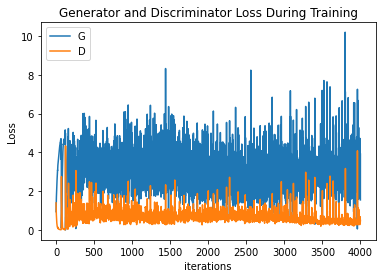

In [ ]:
import torchvision.utils as vutils
from torch.optim.lr_scheduler import StepLR
import pdb

device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

# Number of channels
nc = 3
# Size of z latent vector (i.e. size of generator input)
nz = 100
# Size of feature maps in generator
ngf = 128
# Size of feature maps in discriminator
ndf = 128


# custom weights initialization called on netG and netD
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

# Create the generator and discriminator
netG = DCGAN_Generator().to(device)
netD = DCGAN_Discriminator().to(device)

# Apply weight initialization
netG.apply(weights_init)
netD.apply(weights_init)


# Initialize BCELoss function
criterion = nn.BCELoss()

# Create latent vector to test the generator performance
fixed_noise = torch.randn(36, nz, 1, 1, device=device)

# Establish convention for real and fake labels during training
real_label = 1
fake_label = 0

learning_rate = 0.0002
beta1 = 0.5

# Setup Adam optimizers for both G and D
optimizerD = optim.Adam(netD.parameters(), lr=learning_rate, betas=(beta1, 0.999))
optimizerG = optim.Adam(netG.parameters(), lr=learning_rate, betas=(beta1, 0.999))

img_list = []
real_img_list = []
G_losses = []
D_losses = []
iters = 0
num_epochs = 100

  
def load_param(num_eps):
  model_saved = torch.load('/content/gan_{}.pt'.format(num_eps))
  netG.load_state_dict(model_saved['netG'])
  netD.load_state_dict(model_saved['netD'])

# GAN Training Loop
for epoch in range(num_epochs):
    for i, data in enumerate(gan_train_loader, 0):
        real = data[0].to(device)
        b_size = real.size(0)
        noise = torch.randn(b_size, nz, 1, 1, device=device)

        Valid_label = torch.full((b_size,), real_label, dtype=torch.float, device=device)
        Fake_label = torch.full((b_size,), fake_label, dtype=torch.float, device=device)
        ############################
        # (1) Update D network: maximize log(D(x)) + log(1 - D(G(z)))
        ###########################

        netD.zero_grad()
        # Function to compute discriminator loss
        
        loss_D, fake = loss_discriminator(netD, real, netG, noise, Valid_label, Fake_label, criterion)

        
        # torch.save(fake,'test_case_GAN/fake.pt')
        # torch.save(netD,'test_case_GAN/netD.pt')
        # torch.save(real,'test_case_GAN/real.pt')
        # torch.save(netG,'test_case_GAN/netG.pt')
        # torch.save(noise,'test_case_GAN/noise.pt')
        # torch.save(Valid_label,'test_case_GAN/Valid_label.pt')
        # torch.save(Fake_label,'test_case_GAN/Fake_label.pt')
        # torch.save(criterion,'test_case_GAN/criterion.pt')

        # pdb.set_trace()

        loss_D.backward()
        # Update D
        optimizerD.step()

        ############################
        # (2) Update G network: maximize log(D(G(z)))
        ###########################
        netG.zero_grad()
        # Function to compute generator loss
        loss_G = loss_generator(netD, fake, Valid_label, criterion)
        # Calculate gradients for G
        loss_G.backward()
        # Update G
        optimizerG.step()

        # Output training stats
        if i % 50 == 0:
            print('[%d/%d][%d/%d]\tLoss_D: %.4f\tLoss_G: %.4f\t'
                  % (epoch, num_epochs, i, len(gan_train_loader),
                     loss_D.item(), loss_G.item()))

        # Save Losses for plotting later
        G_losses.append(loss_G.item())
        D_losses.append(loss_D.item())

        # Check how the generator is doing by saving G's output on fixed_noise
        if (iters % 500 == 0) or ((epoch == num_epochs-1) and (i == len(gan_train_loader)-1)):
            with torch.no_grad():
                fake = netG(fixed_noise).detach().cpu()
            img_list.append(vutils.make_grid(fake, padding=2, normalize=True))

        iters += 1

        

plt.title("Generator and Discriminator Loss During Training")
plt.plot(G_losses,label="G")
plt.plot(D_losses,label="D")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

checkpoint = {'netG': netG.state_dict(),
              'netD': netD.state_dict()}
torch.save(checkpoint, '/content/gan_{}.pt'.format(num_epochs))


[0/100][0/40]	Loss_D: 1.3769	Loss_G: 0.9892	
[1/100][0/40]	Loss_D: 0.0577	Loss_G: 3.6844	
[2/100][0/40]	Loss_D: 0.0154	Loss_G: 5.0690	
[3/100][0/40]	Loss_D: 0.2978	Loss_G: 1.6246	
[4/100][0/40]	Loss_D: 3.1784	Loss_G: 1.8550	
[5/100][0/40]	Loss_D: 1.1795	Loss_G: 3.2157	
[6/100][0/40]	Loss_D: 1.0302	Loss_G: 4.9004	
[7/100][0/40]	Loss_D: 1.0232	Loss_G: 3.1075	
[8/100][0/40]	Loss_D: 0.3612	Loss_G: 3.9694	
[9/100][0/40]	Loss_D: 0.4472	Loss_G: 3.9437	
[10/100][0/40]	Loss_D: 1.8712	Loss_G: 4.6886	
[11/100][0/40]	Loss_D: 0.8106	Loss_G: 2.8432	
[12/100][0/40]	Loss_D: 0.8006	Loss_G: 2.2674	
[13/100][0/40]	Loss_D: 2.2502	Loss_G: 2.3971	
[14/100][0/40]	Loss_D: 0.6782	Loss_G: 1.8893	
[15/100][0/40]	Loss_D: 1.0641	Loss_G: 4.7234	
[16/100][0/40]	Loss_D: 0.7553	Loss_G: 2.6665	
[17/100][0/40]	Loss_D: 0.8735	Loss_G: 2.6088	
[18/100][0/40]	Loss_D: 1.7748	Loss_G: 3.8434	
[19/100][0/40]	Loss_D: 0.4954	Loss_G: 2.1542	
[20/100][0/40]	Loss_D: 0.6884	Loss_G: 1.6215	
[21/100][0/40]	Loss_D: 0.7911	Loss_G: 4.5824

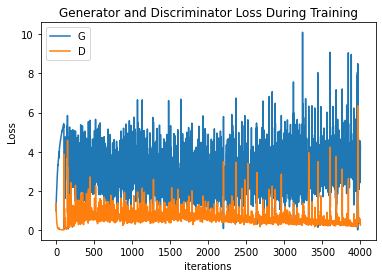

In [ ]:
import torchvision.utils as vutils
from torch.optim.lr_scheduler import StepLR
import pdb

device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

# Number of channels
nc = 3
# Size of z latent vector (i.e. size of generator input)
nz = 100
# Size of feature maps in generator
ngf = 128
# Size of feature maps in discriminator
ndf = 128


# custom weights initialization called on netG and netD
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

# Create the generator and discriminator
netG = DCGAN_Generator().to(device)
netD = DCGAN_Discriminator().to(device)

# Apply weight initialization
netG.apply(weights_init)
netD.apply(weights_init)


# Initialize BCELoss function
criterion = nn.BCELoss()

# Create latent vector to test the generator performance
fixed_noise = torch.randn(36, nz, 1, 1, device=device)

# Establish convention for real and fake labels during training
real_label = 1
fake_label = 0

learning_rate = 0.0002
beta1 = 0.5

# Setup Adam optimizers for both G and D
optimizerD = optim.Adam(netD.parameters(), lr=learning_rate, betas=(beta1, 0.999))
optimizerG = optim.Adam(netG.parameters(), lr=learning_rate, betas=(beta1, 0.999))

img_list = []
real_img_list = []
G_losses = []
D_losses = []
iters = 0
num_epochs = 100

  
def load_param(num_eps):
  model_saved = torch.load('/content/gan_{}.pt'.format(num_eps))
  netG.load_state_dict(model_saved['netG'])
  netD.load_state_dict(model_saved['netD'])

# GAN Training Loop
for epoch in range(num_epochs):
    for i, data in enumerate(gan_train_loader, 0):
        real = data[0].to(device)
        b_size = real.size(0)
        noise = torch.randn(b_size, nz, 1, 1, device=device)

        Valid_label = torch.full((b_size,), real_label, dtype=torch.float, device=device)
        Fake_label = torch.full((b_size,), fake_label, dtype=torch.float, device=device)
        ############################
        # (1) Update D network: maximize log(D(x)) + log(1 - D(G(z)))
        ###########################

        netD.zero_grad()
        # Function to compute discriminator loss
        
        loss_D, fake = loss_discriminator(netD, real, netG, noise, Valid_label, Fake_label, criterion)

        
        # torch.save(fake,'test_case_GAN/fake.pt')
        # torch.save(netD,'test_case_GAN/netD.pt')
        # torch.save(real,'test_case_GAN/real.pt')
        # torch.save(netG,'test_case_GAN/netG.pt')
        # torch.save(noise,'test_case_GAN/noise.pt')
        # torch.save(Valid_label,'test_case_GAN/Valid_label.pt')
        # torch.save(Fake_label,'test_case_GAN/Fake_label.pt')
        # torch.save(criterion,'test_case_GAN/criterion.pt')

        # pdb.set_trace()

        loss_D.backward()
        # Update D
        optimizerD.step()

        ############################
        # (2) Update G network: maximize log(D(G(z)))
        ###########################
        netG.zero_grad()
        # Function to compute generator loss
        loss_G = loss_generator(netD, fake, Valid_label, criterion)
        # Calculate gradients for G
        loss_G.backward()
        # Update G
        optimizerG.step()

        # Output training stats
        if i % 50 == 0:
            print('[%d/%d][%d/%d]\tLoss_D: %.4f\tLoss_G: %.4f\t'
                  % (epoch, num_epochs, i, len(gan_train_loader),
                     loss_D.item(), loss_G.item()))

        # Save Losses for plotting later
        G_losses.append(loss_G.item())
        D_losses.append(loss_D.item())

        # Check how the generator is doing by saving G's output on fixed_noise
        if (iters % 500 == 0) or ((epoch == num_epochs-1) and (i == len(gan_train_loader)-1)):
            with torch.no_grad():
                fake = netG(fixed_noise).detach().cpu()
            img_list.append(vutils.make_grid(fake, nrow=6, padding=2, normalize=True))

        iters += 1

        

plt.title("Generator and Discriminator Loss During Training")
plt.plot(G_losses,label="G")
plt.plot(D_losses,label="D")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

checkpoint = {'netG': netG.state_dict(),
              'netD': netD.state_dict()}
torch.save(checkpoint, '/content/gan_{}.pt'.format(num_epochs))


## Qualitative Visualisations

### GAN Testing (TODO)

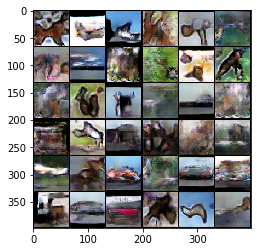

In [ ]:
fixed_noise = torch.randn(36, nz, 1, 1, device=device)
with torch.no_grad():
  fake = netG(fixed_noise).detach().cpu()
  grid_val = vutils.make_grid(fake, nrow=6 ,padding=2, normalize=True)
  show(grid_val)

### Visualisation at different epochs (TODO)

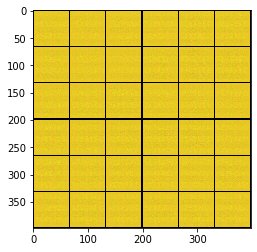

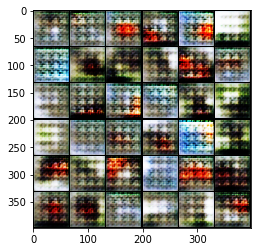

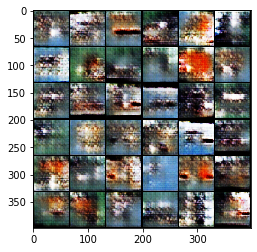

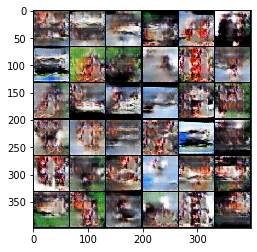

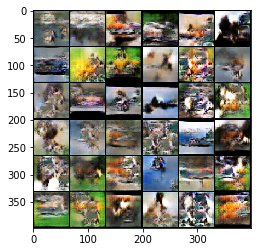

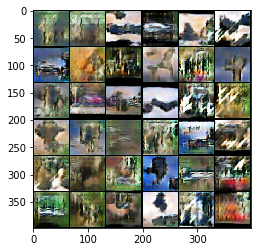

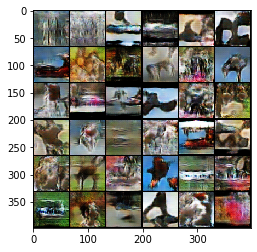

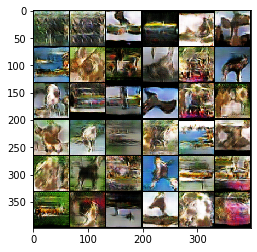

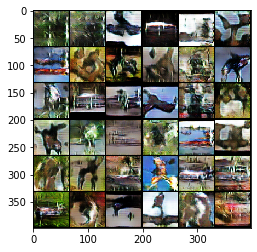

In [ ]:
# Plot GAN generated images at different epochs during training
################################
# Please fill in your code here:

################################
for i in img_list:
  show(i)

## Quantitative Evaluation

In [ ]:
# Resize image to this size
image_size=64

# Setting up transforms to resize and normalize 
transform=transforms.Compose([ transforms.Resize(image_size),
                               transforms.ToTensor(),
                               transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))])
# Load STL-10 test set
test_batch_size = 1
gan_test_dataset = datasets.STL10(root='./stl10_data/', split='test', transform=transform, download=True)
gan_test_loader = torch.utils.data.DataLoader(dataset=gan_test_dataset, batch_size=test_batch_size, shuffle=False)

Files already downloaded and verified


### FID score for GAN
This part, you would be asked to compute a FID score between the real image and the generated images to evaluate the photo-realistic quality of the generated images. 
For this part, we should create three folder: 
- 1. STL_10_real_1 
- 2. STL_10_real_2 
- 3. STL_10_fake


In [ ]:
! mkdir STL_10_fake STL_10_real_1 STL_10_real_2

Create the dataset to evaluate quantitative scores.

In [ ]:
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
# Number of channels
nc = 3
# Size of z latent vector (i.e. size of generator input)
nz = 100
# Size of feature maps in generator
ngf = 128
# Size of feature maps in discriminator
ndf = 128
# Load checkpoint
model_saved = torch.load('/content/gan_{}.pt'.format(num_epochs))
netG = DCGAN_Generator()
netG.load_state_dict(model_saved['netG'])
netG.to(device)


def denorm(x, norm_mean, norm_std):
    y = torch.zeros(x.shape)
    y[:,0,:,:] = x[:,0,:,:]*norm_std[0] + norm_mean[0]
    y[:,1,:,:] = x[:,1,:,:]*norm_std[1] + norm_mean[1]
    y[:,2,:,:] = x[:,2,:,:]*norm_std[2] + norm_mean[2]
    return y



evaluate_num = 1000

# make the gen data set and folder
gen_set = []
for idx in range(evaluate_num):
    with torch.no_grad():
        fixed_noise = torch.randn(1, nz, 1, 1, device=device)
        fake = netG(fixed_noise).detach().cpu()
        fake = fake.cpu().detach()
        fake_denorm = denorm(fake, (0.5, 0.5, 0.5), (0.5, 0.5, 0.5))
        # print(fake_denorm.shape)
        gen_set.append(fake_denorm)
        
        # plt.imshow(np.transpose(vutils.make_grid(fake, nrow=6 ,padding=2, normalize=True),(1,2,0)), animated=True)
        save_image(fake.squeeze(), './STL_10_fake/fake' + str(idx) + '.png', normalize=True)

gen_dataset = TensorDataset(torch.cat(gen_set))

# make the real data set and folder
real_set_1 = []
real_set_2 = []

for idx, data in enumerate(gan_test_loader, 0):
    image = data[0]
    # print(image.shape)
    image_denorm = denorm(image, (0.5, 0.5, 0.5), (0.5, 0.5, 0.5))
    if idx < evaluate_num:
        real_set_1.append(image_denorm)
        save_image(image.squeeze(), './STL_10_real_1/real' + str(idx) + '.png', normalize=True)
    elif evaluate_num <= idx < 2*evaluate_num:
        real_set_2.append(image_denorm)
        save_image(image.squeeze(), './STL_10_real_2/real' + str(idx) + '.png', normalize=True)
    if idx == 2*evaluate_num-1:
        break

# make the pytorch dataset
real_dataset_1 = TensorDataset(torch.cat(real_set_1))
real_dataset_2 = TensorDataset(torch.cat(real_set_2))


#### FID API

In [ ]:
! pip install pytorch-fid
! python -m pytorch_fid '/content/STL_10_real_1' '/content/STL_10_real_1' --gpu 0
! python -m pytorch_fid '/content/STL_10_real_1' '/content/STL_10_real_2' --gpu 0
! python -m pytorch_fid '/content/STL_10_real_1' '/content/STL_10_fake' --gpu 0


  Created wheel for pytorch-fid: filename=pytorch_fid-0.1.1-cp36-none-any.whl size=10188 sha256=e8392d606b4ef4a33384daa25d52dfbbdc70631f38634f187a9dc24244a3c8a8
  Stored in directory: /root/.cache/pip/wheels/b8/93/92/a6a8add9047b97dcb2470d2d1642450e6b76b5988e9744e3f0
Successfully built pytorch-fid
Downloading: "https://github.com/mseitzer/pytorch-fid/releases/download/fid_weights/pt_inception-2015-12-05-6726825d.pth" to /root/.cache/torch/hub/checkpoints/pt_inception-2015-12-05-6726825d.pth
100% 91.2M/91.2M [00:03<00:00, 29.3MB/s]
100% 20/20 [00:01<00:00, 11.71it/s]
100% 20/20 [00:01<00:00, 12.78it/s]
FID:  -2.21134979483395e-05
100% 20/20 [00:01<00:00, 12.64it/s]
100% 20/20 [00:01<00:00, 11.85it/s]
FID:  37.67411966576964
100% 20/20 [00:01<00:00, 12.57it/s]
100% 20/20 [00:01<00:00, 11.00it/s]
FID:  209.50898673829022


If you implement the self-implement FID version. You would notice a negligible difference in value. Because the API package compute this value by saving and reading tensor from .png files. Accuracy problem could happen in the middle of transation.

### IS score for GAN

#### IS API

In [ ]:
from inception_score import inception_score
import warnings
warnings.filterwarnings("ignore")

print('IS score for real data set 1:')
print(inception_score(real_dataset_1, cuda=True, batch_size=64, resize=True, splits=1))
print('IS score for generated data set:')
print(inception_score(gen_dataset, cuda=True, batch_size=64, resize=True, splits=1))

IS score for real data set 1:


Downloading: "https://download.pytorch.org/models/inception_v3_google-1a9a5a14.pth" to /root/.cache/torch/hub/checkpoints/inception_v3_google-1a9a5a14.pth



14.623428882365124
IS score for generated data set:
2.5340821575774424


In [ ]:
from inception_score import inception_score
import warnings
warnings.filterwarnings("ignore")
print('IS score for real data set 2:')
print(inception_score(real_dataset_2, cuda=True, batch_size=64, resize=True, splits=1))

IS score for real data set 2:
15.913448906786716


# **Cycle GAN**

In [ ]:
from google.colab import auth
auth.authenticate_user()
from googleapiclient.discovery import build
drive_service = build('drive', 'v3')
import io
import os
from googleapiclient.http import MediaIoBaseDownload
def download_file(fn, file_id):
    request = drive_service.files().get_media(fileId=file_id)
    downloaded = io.BytesIO()
    downloader = MediaIoBaseDownload(downloaded, request)
    done = False
    while done is False:
        # _ is a placeholder for a progress object that we ignore.
        # (Our file is small, so we skip reporting progress.)
        _, done = downloader.next_chunk()
    downloaded.seek(0)
    folder = fn.split('/')
    if len(folder) > 1:
        os.makedirs(folder[0], exist_ok=True)
    with open(fn, 'wb') as f:
        f.write(downloaded.read())
id_to_fn = {
# '1D3rH-gSxIECZnoyc5k77PEucKBVzoiBc': 'edges2shoes.zip',
'1D3m6I2S8xIvdOHBkvwSSFof5OTJZCDSt': 'edges2shoes.zip',
'1CDRMyBA3Hk_gmbk1xkAm7aRHXBOQQigu': 'CycleGAN_support.zip',
# '1so6AQ0_Pg255COjAzEOOVPlDzTJFVQro': 'test_case.zip',
'1l7gHikhCz64hYHL4n_Ps7nufQcddcRyR': 'test_case.zip'

}
# download all files into the vm
for fid, fn in id_to_fn.items():
    print("Downloading %s from %s" % (fn, fid))
    download_file(fn, fid)

In [ ]:
! unzip -q edges2shoes.zip
! unzip -q CycleGAN_support.zip
! unzip -q test_case.zip

In [ ]:
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
from torchvision import datasets, transforms
from torch.autograd import Variable
from torchvision.utils import save_image
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML
import numpy as np
from torch.optim.lr_scheduler import StepLR
import torchvision.utils as vutils
from torch.utils.data import DataLoader, TensorDataset
from scipy import linalg
from scipy.stats import entropy
import tqdm
import cv2

In [ ]:
import warnings
warnings.filterwarnings("ignore")
from torch.autograd import Variable
from torch.utils import data
from torch.utils.data import DataLoader, TensorDataset
from torch import nn, optim
from datasets import *
from models import *
import argparse, os
import itertools
import torch
import time
import pdb
import matplotlib.pyplot as plt

# Training

In [ ]:
import torch
import pdb

D_A = torch.load('test_case/D_A.pt')
D_B = torch.load('test_case/D_B.pt')
G_BA = torch.load('test_case/G_BA.pt')
G_AB = torch.load('test_case/G_AB.pt')
valid = torch.load('test_case/valid.pt')
fake = torch.load('test_case/fake.pt')
fake_A = torch.load('test_case/fake_A.pt')
fake_B = torch.load('test_case/fake_B.pt')
real_A = torch.load('test_case/real_A.pt')
real_B = torch.load('test_case/real_B.pt')
criterion_GAN = torch.load('test_case/criterion_GAN.pt')
criterion_cycle = torch.load('test_case/criterion_cycle.pt')



def loss_discriminator(fakefG, D, real2D, valid, fake, criterion_GAN):
    '''
    loss_discriminator function is applied to compute loss for discriminator D_A and D_B,
    For example, we want to compute loss for D_A. The loss is consisted of two parts: 
    D(real_A) and D(G(real_B)). We want to penalize the distance between D(real_A) part and 1 and 
    distance between D(G(real_B)) part and 0. 
    We will want to first compute discriminator loss given real_A and valid, which is all 1.
    Then we want to forward real_A through G_AB network to get fake image batch 
    and compute discriminator loss given fake batch and fake, which is all 0.
    Finally, add up these two loss as the total discriminator loss.
    '''
    loss1 = criterion_GAN(D(real2D),valid)
    # print(D(real2D).shape)
    loss2 = criterion_GAN(D(fakefG),fake)
    loss_D = loss1 + loss2
    return loss_D



def loss_generator(G, real2G, D, valid, criterion_GAN):
    '''
    loss_generator function is applied to compute loss for both generator G_AB and G_BA:
    For example, we want to compute the loss for G_AB.
    real2G will be the real image in domain A, then we map real2G into domain B to get fake B,
    then we compute the loss between D_B(fake_B) and valid, which is all 1.
    The fake_B image will also be one of the outputs, since we want to use it in the loss_cycle_consis.
    '''
    loss_G = criterion_GAN(D(G(real2G)),valid)
    fake_o_G = G(real2G)
    return loss_G, fake_o_G



def loss_cycle_consis(G, fakefG, real, criterion_cycle):
    '''
    loss_cycle_consis function is applied to both cycle consistency loss:
    between recovered A and original A,
    between recovered B and original B.
    For example, we want to compute the cycle consistency loss between recovered A and original A.
    fake2G will be the generated image in domain B, then we map fake2G back into domain A to get recovered A,
    then we compute the loss between recovered A and original A
    '''
    loss_cycle = criterion_cycle(G(fakefG),real)
    return loss_cycle


# test case

test_loss_GAN_AB = torch.load('test_case/loss_GAN_AB.pt')
test_loss_cycle_A = torch.load('test_case/loss_cycle_A.pt')
test_loss_D_A = torch.load('test_case/loss_D_A.pt')
loss_GAN_AB, fake_B = loss_generator(G_AB, real_A, D_B, valid, criterion_GAN)
loss_cycle_A = loss_cycle_consis(G_BA, fake_B, real_A, criterion_cycle)
loss_D_A = loss_discriminator(fake_A, D_A, real_A, valid, fake, criterion_GAN)


print('test case loss_D_A:', test_loss_D_A.item())
print('computed loss_D_A:', loss_D_A.item())
print()
print('test case test_loss_GAN_AB:', test_loss_GAN_AB.item())
print('computed test_loss_GAN_AB:', loss_GAN_AB.item())
print()
print('test case loss_cycle_A:', test_loss_cycle_A.item())
print('computed loss_cycle_A:', loss_cycle_A.item())

test case loss_D_A: 3.1760239601135254
computed loss_D_A: 3.1760239601135254

test case test_loss_GAN_AB: 3.164881467819214
computed test_loss_GAN_AB: 3.164881467819214

test case loss_cycle_A: 0.6627261638641357
computed loss_cycle_A: 0.6627261638641357


the length of training data: 49825


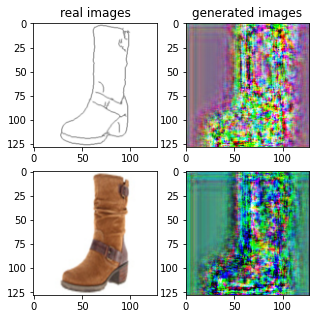

Train Epoch: 1 0% 	Total Loss: 11.118874 	Loss_G_AB: 2.136657	Loss_G_BA: 1.832249	Loss_cycle: 5.600091	Loss_D_A: 1.455792	Loss_D_B: 2.078538
0 9 T:  1.3647866249084473
Train Epoch: 1 0% 	Total Loss: 7.165460 	Loss_G_AB: 2.038377	Loss_G_BA: 1.483172	Loss_cycle: 2.252422	Loss_D_A: 1.301880	Loss_D_B: 1.850383
0 19 T:  0.8757436275482178
Train Epoch: 1 0% 	Total Loss: 4.486576 	Loss_G_AB: 1.123319	Loss_G_BA: 0.769582	Loss_cycle: 1.967603	Loss_D_A: 0.633372	Loss_D_B: 0.939150
0 29 T:  0.8616044521331787
Train Epoch: 1 0% 	Total Loss: 3.743900 	Loss_G_AB: 0.728767	Loss_G_BA: 1.020452	Loss_cycle: 1.700527	Loss_D_A: 0.673686	Loss_D_B: 0.495077
0 39 T:  0.8721978664398193
Train Epoch: 1 0% 	Total Loss: 3.227381 	Loss_G_AB: 0.677209	Loss_G_BA: 0.751385	Loss_cycle: 1.546746	Loss_D_A: 0.527777	Loss_D_B: 0.438561
0 49 T:  0.882836103439331
Train Epoch: 1 0% 	Total Loss: 2.465598 	Loss_G_AB: 0.604268	Loss_G_BA: 0.685422	Loss_cycle: 1.066644	Loss_D_A: 0.395966	Loss_D_B: 0.358144
0 59 T:  0.9138236045

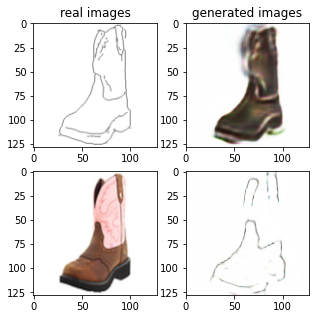

Train Epoch: 1 2% 	Total Loss: 1.592241 	Loss_G_AB: 0.361225	Loss_G_BA: 0.740350	Loss_cycle: 0.659052	Loss_D_A: 0.087665	Loss_D_B: 0.294737
0 1009 T:  1.5053613185882568
Train Epoch: 1 2% 	Total Loss: 1.948462 	Loss_G_AB: 0.351149	Loss_G_BA: 0.945897	Loss_cycle: 0.981540	Loss_D_A: 0.056043	Loss_D_B: 0.262356
0 1019 T:  0.9423215389251709
Train Epoch: 1 2% 	Total Loss: 1.598423 	Loss_G_AB: 0.318193	Loss_G_BA: 0.629906	Loss_cycle: 0.806090	Loss_D_A: 0.089167	Loss_D_B: 0.229116
0 1029 T:  0.9280557632446289
Train Epoch: 1 2% 	Total Loss: 1.868603 	Loss_G_AB: 0.441494	Loss_G_BA: 0.954537	Loss_cycle: 0.879822	Loss_D_A: 0.069320	Loss_D_B: 0.221446
0 1039 T:  0.9369306564331055
Train Epoch: 1 2% 	Total Loss: 1.931946 	Loss_G_AB: 0.448358	Loss_G_BA: 0.834255	Loss_cycle: 0.901490	Loss_D_A: 0.086527	Loss_D_B: 0.302623
0 1049 T:  0.8998253345489502
Train Epoch: 1 2% 	Total Loss: 1.772145 	Loss_G_AB: 0.378281	Loss_G_BA: 0.878836	Loss_cycle: 0.737685	Loss_D_A: 0.158519	Loss_D_B: 0.247382
0 1059 T: 

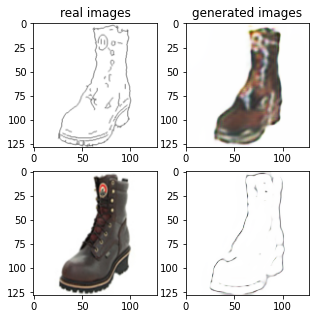

Train Epoch: 1 4% 	Total Loss: 1.538222 	Loss_G_AB: 0.315628	Loss_G_BA: 0.955342	Loss_cycle: 0.625975	Loss_D_A: 0.030649	Loss_D_B: 0.246113
0 2009 T:  1.6726975440979004
Train Epoch: 1 4% 	Total Loss: 1.896263 	Loss_G_AB: 0.348695	Loss_G_BA: 0.934672	Loss_cycle: 0.936323	Loss_D_A: 0.060939	Loss_D_B: 0.257318
0 2019 T:  0.9319331645965576
Train Epoch: 1 4% 	Total Loss: 1.787718 	Loss_G_AB: 0.390485	Loss_G_BA: 0.791382	Loss_cycle: 0.885659	Loss_D_A: 0.062922	Loss_D_B: 0.248203
0 2029 T:  0.9132764339447021
Train Epoch: 1 4% 	Total Loss: 1.738162 	Loss_G_AB: 0.350048	Loss_G_BA: 0.806155	Loss_cycle: 0.807098	Loss_D_A: 0.115687	Loss_D_B: 0.237276
0 2039 T:  0.9270172119140625
Train Epoch: 1 4% 	Total Loss: 1.546856 	Loss_G_AB: 0.356606	Loss_G_BA: 0.654721	Loss_cycle: 0.572862	Loss_D_A: 0.161929	Loss_D_B: 0.306402
0 2049 T:  0.911440372467041
Train Epoch: 1 4% 	Total Loss: 1.666812 	Loss_G_AB: 0.356511	Loss_G_BA: 0.586748	Loss_cycle: 0.803292	Loss_D_A: 0.106400	Loss_D_B: 0.285490
0 2059 T:  

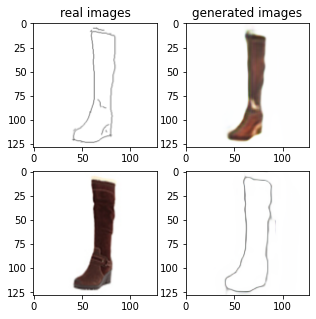

Train Epoch: 1 6% 	Total Loss: 1.676954 	Loss_G_AB: 0.328932	Loss_G_BA: 0.942399	Loss_cycle: 0.735102	Loss_D_A: 0.050199	Loss_D_B: 0.255988
0 3009 T:  1.5141713619232178
Train Epoch: 1 6% 	Total Loss: 1.743780 	Loss_G_AB: 0.370035	Loss_G_BA: 0.906477	Loss_cycle: 0.770648	Loss_D_A: 0.050821	Loss_D_B: 0.284056
0 3019 T:  0.889634370803833
Train Epoch: 1 6% 	Total Loss: 1.570179 	Loss_G_AB: 0.305452	Loss_G_BA: 0.840970	Loss_cycle: 0.671343	Loss_D_A: 0.078593	Loss_D_B: 0.247032
0 3029 T:  0.8877511024475098
Train Epoch: 1 6% 	Total Loss: 1.720371 	Loss_G_AB: 0.327731	Loss_G_BA: 0.851609	Loss_cycle: 0.841753	Loss_D_A: 0.047303	Loss_D_B: 0.241645
0 3039 T:  0.9848146438598633
Train Epoch: 1 6% 	Total Loss: 1.684292 	Loss_G_AB: 0.423134	Loss_G_BA: 0.835068	Loss_cycle: 0.800987	Loss_D_A: 0.059414	Loss_D_B: 0.194790
0 3049 T:  0.8937225341796875
Train Epoch: 1 6% 	Total Loss: 1.720049 	Loss_G_AB: 0.371959	Loss_G_BA: 0.864442	Loss_cycle: 0.714839	Loss_D_A: 0.095177	Loss_D_B: 0.291833
0 3059 T:  

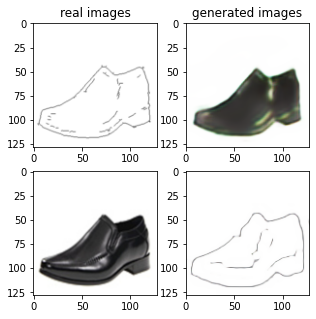

Train Epoch: 1 8% 	Total Loss: 1.740948 	Loss_G_AB: 0.407600	Loss_G_BA: 0.906215	Loss_cycle: 0.728946	Loss_D_A: 0.096685	Loss_D_B: 0.258410
0 4009 T:  1.5273709297180176
Train Epoch: 1 8% 	Total Loss: 1.549211 	Loss_G_AB: 0.361973	Loss_G_BA: 0.625859	Loss_cycle: 0.677561	Loss_D_A: 0.111609	Loss_D_B: 0.266125
0 4019 T:  0.9505918025970459
Train Epoch: 1 8% 	Total Loss: 1.767079 	Loss_G_AB: 0.338323	Loss_G_BA: 0.865182	Loss_cycle: 0.851937	Loss_D_A: 0.075253	Loss_D_B: 0.238136
0 4029 T:  0.9640448093414307
Train Epoch: 1 8% 	Total Loss: 1.732689 	Loss_G_AB: 0.371130	Loss_G_BA: 0.883981	Loss_cycle: 0.762159	Loss_D_A: 0.097567	Loss_D_B: 0.245408
0 4039 T:  0.8965339660644531
Train Epoch: 1 8% 	Total Loss: 1.846656 	Loss_G_AB: 0.494113	Loss_G_BA: 0.763578	Loss_cycle: 0.768654	Loss_D_A: 0.083612	Loss_D_B: 0.365544
0 4049 T:  0.9159111976623535
Train Epoch: 1 8% 	Total Loss: 1.660935 	Loss_G_AB: 0.360069	Loss_G_BA: 0.896385	Loss_cycle: 0.728689	Loss_D_A: 0.065789	Loss_D_B: 0.238230
0 4059 T: 

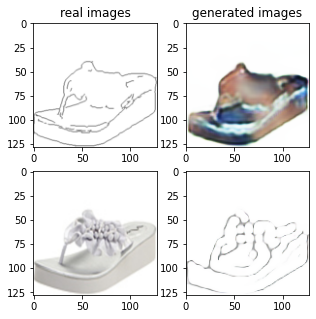

Train Epoch: 1 10% 	Total Loss: 1.644976 	Loss_G_AB: 0.326704	Loss_G_BA: 0.915357	Loss_cycle: 0.707108	Loss_D_A: 0.015985	Loss_D_B: 0.300852
0 5009 T:  1.607100009918213
Train Epoch: 1 10% 	Total Loss: 1.632694 	Loss_G_AB: 0.362484	Loss_G_BA: 0.969844	Loss_cycle: 0.707026	Loss_D_A: 0.019900	Loss_D_B: 0.239604
0 5019 T:  0.9949314594268799
Train Epoch: 1 10% 	Total Loss: 1.890609 	Loss_G_AB: 0.387692	Loss_G_BA: 0.960619	Loss_cycle: 0.935879	Loss_D_A: 0.023630	Loss_D_B: 0.256944
0 5029 T:  0.9183573722839355
Train Epoch: 1 10% 	Total Loss: 1.598803 	Loss_G_AB: 0.360127	Loss_G_BA: 0.921816	Loss_cycle: 0.678964	Loss_D_A: 0.042108	Loss_D_B: 0.236759
0 5039 T:  1.0087268352508545
Train Epoch: 1 10% 	Total Loss: 1.686974 	Loss_G_AB: 0.271324	Loss_G_BA: 0.893927	Loss_cycle: 0.781015	Loss_D_A: 0.025536	Loss_D_B: 0.297798
0 5049 T:  0.9138240814208984
Train Epoch: 1 10% 	Total Loss: 1.584927 	Loss_G_AB: 0.268106	Loss_G_BA: 1.041368	Loss_cycle: 0.640626	Loss_D_A: 0.026197	Loss_D_B: 0.263368
0 505

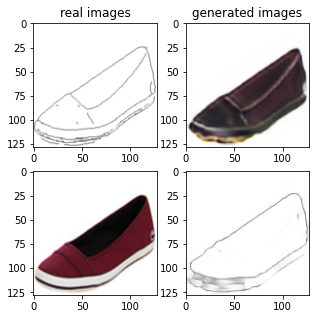

Train Epoch: 1 12% 	Total Loss: 1.641177 	Loss_G_AB: 0.333417	Loss_G_BA: 1.028109	Loss_cycle: 0.663018	Loss_D_A: 0.029625	Loss_D_B: 0.267772
0 6009 T:  1.5228214263916016
Train Epoch: 1 12% 	Total Loss: 1.852972 	Loss_G_AB: 0.444895	Loss_G_BA: 0.926778	Loss_cycle: 0.846073	Loss_D_A: 0.033086	Loss_D_B: 0.287976
0 6019 T:  0.9176208972930908
Train Epoch: 1 12% 	Total Loss: 1.593010 	Loss_G_AB: 0.326570	Loss_G_BA: 0.931227	Loss_cycle: 0.674373	Loss_D_A: 0.037461	Loss_D_B: 0.252278
0 6029 T:  0.923349142074585
Train Epoch: 1 12% 	Total Loss: 1.620300 	Loss_G_AB: 0.372981	Loss_G_BA: 0.884525	Loss_cycle: 0.710385	Loss_D_A: 0.064647	Loss_D_B: 0.216516
0 6039 T:  0.9026129245758057
Train Epoch: 1 12% 	Total Loss: 1.611145 	Loss_G_AB: 0.347471	Loss_G_BA: 0.853922	Loss_cycle: 0.730290	Loss_D_A: 0.035705	Loss_D_B: 0.244453
0 6049 T:  0.9015953540802002
Train Epoch: 1 12% 	Total Loss: 1.595435 	Loss_G_AB: 0.335420	Loss_G_BA: 0.789953	Loss_cycle: 0.694875	Loss_D_A: 0.054680	Loss_D_B: 0.283193
0 605

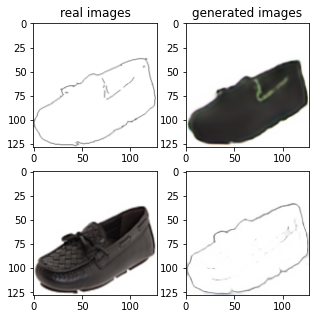

Train Epoch: 1 14% 	Total Loss: 1.596437 	Loss_G_AB: 0.299411	Loss_G_BA: 0.876582	Loss_cycle: 0.694322	Loss_D_A: 0.046154	Loss_D_B: 0.267965
0 7009 T:  1.60817289352417
Train Epoch: 1 14% 	Total Loss: 1.460043 	Loss_G_AB: 0.306452	Loss_G_BA: 0.793054	Loss_cycle: 0.594120	Loss_D_A: 0.079667	Loss_D_B: 0.236503
0 7019 T:  0.9019081592559814
Train Epoch: 1 14% 	Total Loss: 1.739021 	Loss_G_AB: 0.296697	Loss_G_BA: 0.989713	Loss_cycle: 0.791976	Loss_D_A: 0.044655	Loss_D_B: 0.259184
0 7029 T:  0.9165334701538086
Train Epoch: 1 14% 	Total Loss: 1.421396 	Loss_G_AB: 0.326613	Loss_G_BA: 0.943960	Loss_cycle: 0.527253	Loss_D_A: 0.026585	Loss_D_B: 0.232271
0 7039 T:  0.9473297595977783
Train Epoch: 1 14% 	Total Loss: 1.696836 	Loss_G_AB: 0.360249	Loss_G_BA: 0.846724	Loss_cycle: 0.737725	Loss_D_A: 0.091483	Loss_D_B: 0.264141
0 7049 T:  0.9049408435821533
Train Epoch: 1 14% 	Total Loss: 1.449378 	Loss_G_AB: 0.325442	Loss_G_BA: 0.722804	Loss_cycle: 0.651969	Loss_D_A: 0.054898	Loss_D_B: 0.218388
0 7059

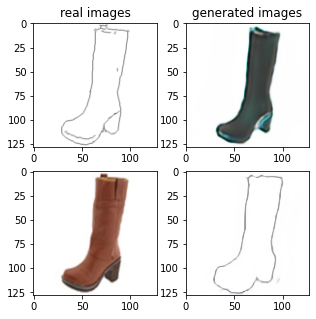

Train Epoch: 1 16% 	Total Loss: 1.674714 	Loss_G_AB: 0.275153	Loss_G_BA: 0.658319	Loss_cycle: 0.852298	Loss_D_A: 0.113849	Loss_D_B: 0.241832
0 8009 T:  1.607088327407837
Train Epoch: 1 16% 	Total Loss: 1.384287 	Loss_G_AB: 0.301582	Loss_G_BA: 0.616274	Loss_cycle: 0.527592	Loss_D_A: 0.158103	Loss_D_B: 0.239664
0 8019 T:  0.9011335372924805
Train Epoch: 1 16% 	Total Loss: 1.666250 	Loss_G_AB: 0.287907	Loss_G_BA: 0.884193	Loss_cycle: 0.698504	Loss_D_A: 0.120129	Loss_D_B: 0.261567
0 8029 T:  0.9074230194091797
Train Epoch: 1 16% 	Total Loss: 1.396811 	Loss_G_AB: 0.327816	Loss_G_BA: 0.729811	Loss_cycle: 0.511862	Loss_D_A: 0.100454	Loss_D_B: 0.255681
0 8039 T:  0.9169068336486816
Train Epoch: 1 16% 	Total Loss: 1.826952 	Loss_G_AB: 0.304155	Loss_G_BA: 0.744322	Loss_cycle: 0.922577	Loss_D_A: 0.131364	Loss_D_B: 0.248772
0 8049 T:  0.891960859298706
Train Epoch: 1 16% 	Total Loss: 1.300403 	Loss_G_AB: 0.347161	Loss_G_BA: 0.614201	Loss_cycle: 0.441596	Loss_D_A: 0.112118	Loss_D_B: 0.266008
0 8059

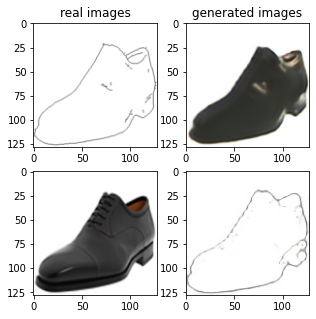

Train Epoch: 1 18% 	Total Loss: 1.457217 	Loss_G_AB: 0.363439	Loss_G_BA: 0.983277	Loss_cycle: 0.531143	Loss_D_A: 0.013384	Loss_D_B: 0.239332
0 9009 T:  1.5183250904083252
Train Epoch: 1 18% 	Total Loss: 1.765259 	Loss_G_AB: 0.275754	Loss_G_BA: 0.872301	Loss_cycle: 0.838373	Loss_D_A: 0.033738	Loss_D_B: 0.319120
0 9019 T:  0.9079582691192627
Train Epoch: 1 18% 	Total Loss: 1.783776 	Loss_G_AB: 0.297984	Loss_G_BA: 0.983845	Loss_cycle: 0.866404	Loss_D_A: 0.026641	Loss_D_B: 0.249816
0 9029 T:  0.9686324596405029
Train Epoch: 1 18% 	Total Loss: 1.477338 	Loss_G_AB: 0.301926	Loss_G_BA: 1.027976	Loss_cycle: 0.553815	Loss_D_A: 0.020784	Loss_D_B: 0.237786
0 9039 T:  0.9271376132965088
Train Epoch: 1 18% 	Total Loss: 1.448177 	Loss_G_AB: 0.297114	Loss_G_BA: 0.914404	Loss_cycle: 0.584109	Loss_D_A: 0.023835	Loss_D_B: 0.234475
0 9049 T:  0.9304065704345703
Train Epoch: 1 18% 	Total Loss: 1.804899 	Loss_G_AB: 0.336581	Loss_G_BA: 1.027094	Loss_cycle: 0.849107	Loss_D_A: 0.016303	Loss_D_B: 0.257652
0 90

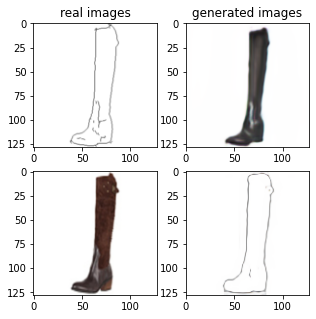

Train Epoch: 1 20% 	Total Loss: 1.467567 	Loss_G_AB: 0.338318	Loss_G_BA: 0.911484	Loss_cycle: 0.558031	Loss_D_A: 0.037110	Loss_D_B: 0.247524
0 10009 T:  1.507188081741333
Train Epoch: 1 20% 	Total Loss: 1.470699 	Loss_G_AB: 0.316454	Loss_G_BA: 1.026829	Loss_cycle: 0.534597	Loss_D_A: 0.025354	Loss_D_B: 0.239106
0 10019 T:  0.9112002849578857
Train Epoch: 1 20% 	Total Loss: 1.598750 	Loss_G_AB: 0.291925	Loss_G_BA: 1.017488	Loss_cycle: 0.662118	Loss_D_A: 0.008483	Loss_D_B: 0.273442
0 10029 T:  0.897395133972168
Train Epoch: 1 20% 	Total Loss: 1.548249 	Loss_G_AB: 0.365832	Loss_G_BA: 0.929745	Loss_cycle: 0.613027	Loss_D_A: 0.029818	Loss_D_B: 0.257616
0 10039 T:  0.8759279251098633
Train Epoch: 1 20% 	Total Loss: 1.531979 	Loss_G_AB: 0.314481	Loss_G_BA: 0.927791	Loss_cycle: 0.643419	Loss_D_A: 0.025939	Loss_D_B: 0.241485
0 10049 T:  0.9043736457824707
Train Epoch: 1 20% 	Total Loss: 1.565888 	Loss_G_AB: 0.322763	Loss_G_BA: 1.027147	Loss_cycle: 0.576469	Loss_D_A: 0.025189	Loss_D_B: 0.289275
0

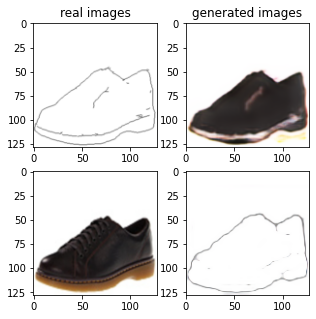

Train Epoch: 1 22% 	Total Loss: 1.587169 	Loss_G_AB: 0.282899	Loss_G_BA: 0.990577	Loss_cycle: 0.673816	Loss_D_A: 0.018632	Loss_D_B: 0.257982
0 11009 T:  1.5443944931030273
Train Epoch: 1 22% 	Total Loss: 1.563654 	Loss_G_AB: 0.295936	Loss_G_BA: 0.980314	Loss_cycle: 0.655592	Loss_D_A: 0.018274	Loss_D_B: 0.251663
0 11019 T:  0.9355943202972412
Train Epoch: 1 22% 	Total Loss: 1.291606 	Loss_G_AB: 0.279935	Loss_G_BA: 0.904685	Loss_cycle: 0.436741	Loss_D_A: 0.021366	Loss_D_B: 0.241188
0 11029 T:  0.900022029876709
Train Epoch: 1 22% 	Total Loss: 1.742133 	Loss_G_AB: 0.325649	Loss_G_BA: 0.955994	Loss_cycle: 0.821763	Loss_D_A: 0.023623	Loss_D_B: 0.255925
0 11039 T:  0.8967010974884033
Train Epoch: 1 22% 	Total Loss: 1.553415 	Loss_G_AB: 0.296396	Loss_G_BA: 0.904859	Loss_cycle: 0.660194	Loss_D_A: 0.051937	Loss_D_B: 0.240656
0 11049 T:  0.9282231330871582
Train Epoch: 1 22% 	Total Loss: 1.409547 	Loss_G_AB: 0.309602	Loss_G_BA: 1.014864	Loss_cycle: 0.482843	Loss_D_A: 0.010263	Loss_D_B: 0.254209


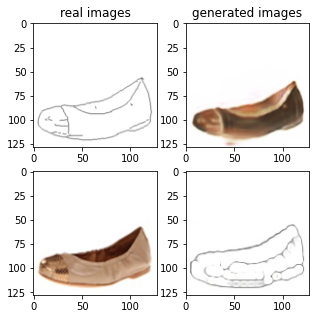

Train Epoch: 1 24% 	Total Loss: 1.554387 	Loss_G_AB: 0.307316	Loss_G_BA: 0.948549	Loss_cycle: 0.624647	Loss_D_A: 0.031521	Loss_D_B: 0.270287
0 12009 T:  1.5798513889312744
Train Epoch: 1 24% 	Total Loss: 1.488807 	Loss_G_AB: 0.302281	Loss_G_BA: 0.958682	Loss_cycle: 0.559767	Loss_D_A: 0.036956	Loss_D_B: 0.261603
0 12019 T:  0.9034438133239746
Train Epoch: 1 24% 	Total Loss: 1.527757 	Loss_G_AB: 0.347036	Loss_G_BA: 0.964645	Loss_cycle: 0.616529	Loss_D_A: 0.012688	Loss_D_B: 0.242701
0 12029 T:  0.9086911678314209
Train Epoch: 1 24% 	Total Loss: 1.477794 	Loss_G_AB: 0.264657	Loss_G_BA: 0.934381	Loss_cycle: 0.545500	Loss_D_A: 0.037871	Loss_D_B: 0.294904
0 12039 T:  0.9080765247344971
Train Epoch: 1 24% 	Total Loss: 1.516265 	Loss_G_AB: 0.306288	Loss_G_BA: 1.066061	Loss_cycle: 0.569314	Loss_D_A: 0.012544	Loss_D_B: 0.248234
0 12049 T:  0.9138777256011963
Train Epoch: 1 24% 	Total Loss: 1.414452 	Loss_G_AB: 0.253356	Loss_G_BA: 0.934379	Loss_cycle: 0.538602	Loss_D_A: 0.018809	Loss_D_B: 0.263173

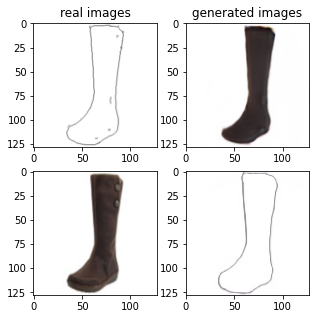

Train Epoch: 1 26% 	Total Loss: 1.430903 	Loss_G_AB: 0.278017	Loss_G_BA: 0.969186	Loss_cycle: 0.531682	Loss_D_A: 0.016101	Loss_D_B: 0.259518
0 13009 T:  1.4922940731048584
Train Epoch: 1 26% 	Total Loss: 1.652263 	Loss_G_AB: 0.349910	Loss_G_BA: 0.894110	Loss_cycle: 0.689084	Loss_D_A: 0.086963	Loss_D_B: 0.254207
0 13019 T:  0.951913595199585
Train Epoch: 1 26% 	Total Loss: 1.453595 	Loss_G_AB: 0.273763	Loss_G_BA: 0.860268	Loss_cycle: 0.581950	Loss_D_A: 0.026043	Loss_D_B: 0.278586
0 13029 T:  0.9142076969146729
Train Epoch: 1 26% 	Total Loss: 1.520045 	Loss_G_AB: 0.307177	Loss_G_BA: 0.951265	Loss_cycle: 0.613052	Loss_D_A: 0.026164	Loss_D_B: 0.251607
0 13039 T:  0.9062750339508057
Train Epoch: 1 26% 	Total Loss: 1.402938 	Loss_G_AB: 0.280710	Loss_G_BA: 1.074499	Loss_cycle: 0.458335	Loss_D_A: 0.010203	Loss_D_B: 0.256795
0 13049 T:  0.8861041069030762
Train Epoch: 1 26% 	Total Loss: 1.643216 	Loss_G_AB: 0.306044	Loss_G_BA: 0.923695	Loss_cycle: 0.746281	Loss_D_A: 0.039678	Loss_D_B: 0.242387


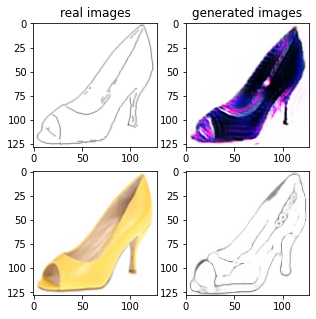

Train Epoch: 1 28% 	Total Loss: 1.691512 	Loss_G_AB: 0.332227	Loss_G_BA: 0.842706	Loss_cycle: 0.790925	Loss_D_A: 0.084166	Loss_D_B: 0.228955
0 14009 T:  1.5122804641723633
Train Epoch: 1 28% 	Total Loss: 1.572657 	Loss_G_AB: 0.297917	Loss_G_BA: 0.873282	Loss_cycle: 0.694978	Loss_D_A: 0.057334	Loss_D_B: 0.234745
0 14019 T:  0.8869054317474365
Train Epoch: 1 28% 	Total Loss: 1.483990 	Loss_G_AB: 0.337698	Loss_G_BA: 0.734933	Loss_cycle: 0.582143	Loss_D_A: 0.125028	Loss_D_B: 0.240503
0 14029 T:  0.8798933029174805
Train Epoch: 1 28% 	Total Loss: 1.441422 	Loss_G_AB: 0.320529	Loss_G_BA: 0.971969	Loss_cycle: 0.525997	Loss_D_A: 0.030389	Loss_D_B: 0.238786
0 14039 T:  0.891890287399292
Train Epoch: 1 28% 	Total Loss: 1.566100 	Loss_G_AB: 0.287832	Loss_G_BA: 0.979977	Loss_cycle: 0.647028	Loss_D_A: 0.010679	Loss_D_B: 0.274488
0 14049 T:  0.9103436470031738
Train Epoch: 1 28% 	Total Loss: 1.567690 	Loss_G_AB: 0.288606	Loss_G_BA: 0.965605	Loss_cycle: 0.673394	Loss_D_A: 0.021520	Loss_D_B: 0.245671


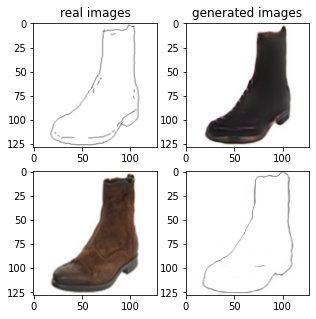

Train Epoch: 1 30% 	Total Loss: 1.519330 	Loss_G_AB: 0.292313	Loss_G_BA: 0.983623	Loss_cycle: 0.596707	Loss_D_A: 0.004002	Loss_D_B: 0.280653
0 15009 T:  1.6303539276123047
Train Epoch: 1 30% 	Total Loss: 1.423386 	Loss_G_AB: 0.288125	Loss_G_BA: 1.004633	Loss_cycle: 0.520734	Loss_D_A: 0.009475	Loss_D_B: 0.246798
0 15019 T:  0.9112014770507812
Train Epoch: 1 30% 	Total Loss: 1.501756 	Loss_G_AB: 0.346779	Loss_G_BA: 1.012133	Loss_cycle: 0.599532	Loss_D_A: 0.006360	Loss_D_B: 0.216408
0 15029 T:  0.9195668697357178
Train Epoch: 1 30% 	Total Loss: 1.617998 	Loss_G_AB: 0.356971	Loss_G_BA: 0.979249	Loss_cycle: 0.672246	Loss_D_A: 0.006795	Loss_D_B: 0.270847
0 15039 T:  0.9109814167022705
Train Epoch: 1 30% 	Total Loss: 1.575394 	Loss_G_AB: 0.323509	Loss_G_BA: 0.982941	Loss_cycle: 0.617323	Loss_D_A: 0.004578	Loss_D_B: 0.300268
0 15049 T:  0.9042098522186279
Train Epoch: 1 30% 	Total Loss: 1.495554 	Loss_G_AB: 0.384647	Loss_G_BA: 1.044292	Loss_cycle: 0.502286	Loss_D_A: 0.007211	Loss_D_B: 0.271588

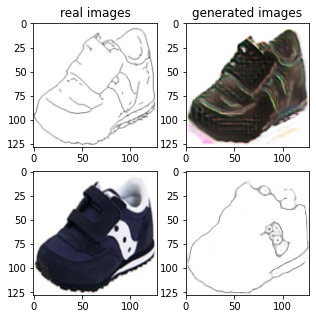

Train Epoch: 1 32% 	Total Loss: 1.527633 	Loss_G_AB: 0.288976	Loss_G_BA: 0.996837	Loss_cycle: 0.628797	Loss_D_A: 0.008665	Loss_D_B: 0.247265
0 16009 T:  1.5353662967681885
Train Epoch: 1 32% 	Total Loss: 1.532702 	Loss_G_AB: 0.303826	Loss_G_BA: 0.972796	Loss_cycle: 0.607871	Loss_D_A: 0.044507	Loss_D_B: 0.242012
0 16019 T:  0.9168422222137451
Train Epoch: 1 32% 	Total Loss: 1.523775 	Loss_G_AB: 0.298758	Loss_G_BA: 0.835504	Loss_cycle: 0.650596	Loss_D_A: 0.056587	Loss_D_B: 0.249461
0 16029 T:  0.9374992847442627
Train Epoch: 1 32% 	Total Loss: 1.480787 	Loss_G_AB: 0.317892	Loss_G_BA: 0.985627	Loss_cycle: 0.563672	Loss_D_A: 0.018257	Loss_D_B: 0.247097
0 16039 T:  0.9061038494110107
Train Epoch: 1 32% 	Total Loss: 1.419476 	Loss_G_AB: 0.313236	Loss_G_BA: 0.971781	Loss_cycle: 0.528783	Loss_D_A: 0.013975	Loss_D_B: 0.234209
0 16049 T:  0.9047157764434814
Train Epoch: 1 32% 	Total Loss: 1.485789 	Loss_G_AB: 0.283517	Loss_G_BA: 0.977499	Loss_cycle: 0.591823	Loss_D_A: 0.018483	Loss_D_B: 0.244975

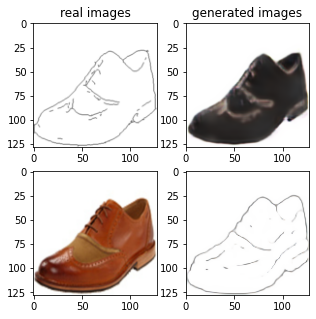

Train Epoch: 1 34% 	Total Loss: 1.454105 	Loss_G_AB: 0.350185	Loss_G_BA: 0.927951	Loss_cycle: 0.521277	Loss_D_A: 0.023723	Loss_D_B: 0.270037
0 17009 T:  1.5133273601531982
Train Epoch: 1 34% 	Total Loss: 1.550732 	Loss_G_AB: 0.326503	Loss_G_BA: 0.896729	Loss_cycle: 0.606804	Loss_D_A: 0.067310	Loss_D_B: 0.265002
0 17019 T:  0.904383659362793
Train Epoch: 1 34% 	Total Loss: 1.504056 	Loss_G_AB: 0.283429	Loss_G_BA: 0.945516	Loss_cycle: 0.581937	Loss_D_A: 0.048396	Loss_D_B: 0.259250
0 17029 T:  0.9137289524078369
Train Epoch: 1 34% 	Total Loss: 1.570876 	Loss_G_AB: 0.327520	Loss_G_BA: 0.930295	Loss_cycle: 0.688406	Loss_D_A: 0.022837	Loss_D_B: 0.230725
0 17039 T:  0.9425594806671143
Train Epoch: 1 34% 	Total Loss: 1.606642 	Loss_G_AB: 0.295744	Loss_G_BA: 1.008490	Loss_cycle: 0.675841	Loss_D_A: 0.014135	Loss_D_B: 0.264548
0 17049 T:  0.8758547306060791
Train Epoch: 1 34% 	Total Loss: 1.582323 	Loss_G_AB: 0.321234	Loss_G_BA: 0.903149	Loss_cycle: 0.691303	Loss_D_A: 0.030755	Loss_D_B: 0.248073


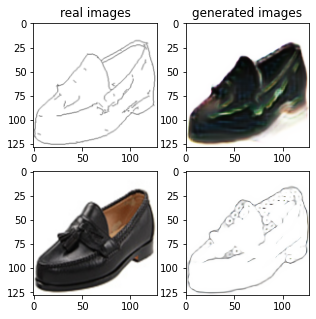

Train Epoch: 1 36% 	Total Loss: 1.333801 	Loss_G_AB: 0.293796	Loss_G_BA: 0.489560	Loss_cycle: 0.536000	Loss_D_A: 0.167014	Loss_D_B: 0.239109
0 18009 T:  1.4765403270721436
Train Epoch: 1 36% 	Total Loss: 1.460125 	Loss_G_AB: 0.349011	Loss_G_BA: 0.545998	Loss_cycle: 0.610203	Loss_D_A: 0.141719	Loss_D_B: 0.260698
0 18019 T:  0.9544429779052734
Train Epoch: 1 36% 	Total Loss: 1.491856 	Loss_G_AB: 0.314545	Loss_G_BA: 0.761187	Loss_cycle: 0.632764	Loss_D_A: 0.081878	Loss_D_B: 0.239347
0 18029 T:  0.9294881820678711
Train Epoch: 1 36% 	Total Loss: 1.595987 	Loss_G_AB: 0.354430	Loss_G_BA: 1.002264	Loss_cycle: 0.663315	Loss_D_A: 0.024937	Loss_D_B: 0.229389
0 18039 T:  0.9041221141815186
Train Epoch: 1 36% 	Total Loss: 1.571647 	Loss_G_AB: 0.280727	Loss_G_BA: 0.851124	Loss_cycle: 0.715512	Loss_D_A: 0.040608	Loss_D_B: 0.249602
0 18049 T:  0.9249253273010254
Train Epoch: 1 36% 	Total Loss: 1.500143 	Loss_G_AB: 0.338513	Loss_G_BA: 0.857161	Loss_cycle: 0.585383	Loss_D_A: 0.112634	Loss_D_B: 0.204289

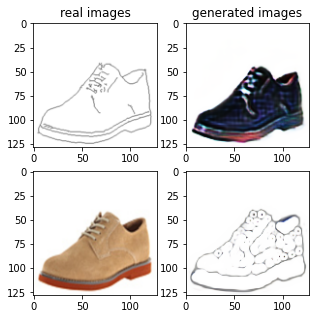

Train Epoch: 1 38% 	Total Loss: 1.465412 	Loss_G_AB: 0.341383	Loss_G_BA: 0.987117	Loss_cycle: 0.569163	Loss_D_A: 0.005432	Loss_D_B: 0.226567
0 19009 T:  1.4989063739776611
Train Epoch: 1 38% 	Total Loss: 1.657420 	Loss_G_AB: 0.326659	Loss_G_BA: 0.991821	Loss_cycle: 0.771611	Loss_D_A: 0.003246	Loss_D_B: 0.223324
0 19019 T:  0.9484081268310547
Train Epoch: 1 38% 	Total Loss: 1.325002 	Loss_G_AB: 0.280477	Loss_G_BA: 0.968221	Loss_cycle: 0.429737	Loss_D_A: 0.013781	Loss_D_B: 0.257134
0 19029 T:  1.0393359661102295
Train Epoch: 1 38% 	Total Loss: 1.451242 	Loss_G_AB: 0.273817	Loss_G_BA: 0.997612	Loss_cycle: 0.539808	Loss_D_A: 0.006520	Loss_D_B: 0.269200
0 19039 T:  0.9079873561859131
Train Epoch: 1 38% 	Total Loss: 1.482922 	Loss_G_AB: 0.276853	Loss_G_BA: 0.999053	Loss_cycle: 0.568198	Loss_D_A: 0.005762	Loss_D_B: 0.271010
0 19049 T:  0.8777327537536621
Train Epoch: 1 38% 	Total Loss: 1.399710 	Loss_G_AB: 0.351555	Loss_G_BA: 0.996891	Loss_cycle: 0.513687	Loss_D_A: 0.006314	Loss_D_B: 0.205485

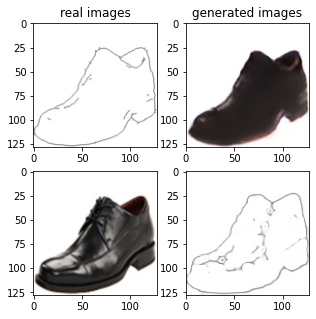

Train Epoch: 1 40% 	Total Loss: 1.574710 	Loss_G_AB: 0.307264	Loss_G_BA: 0.779162	Loss_cycle: 0.681608	Loss_D_A: 0.094680	Loss_D_B: 0.255209
0 20009 T:  1.5017781257629395
Train Epoch: 1 40% 	Total Loss: 1.603135 	Loss_G_AB: 0.326415	Loss_G_BA: 1.026086	Loss_cycle: 0.667708	Loss_D_A: 0.020375	Loss_D_B: 0.238802
0 20019 T:  0.8995568752288818
Train Epoch: 1 40% 	Total Loss: 1.354916 	Loss_G_AB: 0.327145	Loss_G_BA: 0.902137	Loss_cycle: 0.458260	Loss_D_A: 0.038208	Loss_D_B: 0.243806
0 20029 T:  0.9038546085357666
Train Epoch: 1 40% 	Total Loss: 1.451554 	Loss_G_AB: 0.359830	Loss_G_BA: 0.965048	Loss_cycle: 0.549670	Loss_D_A: 0.014352	Loss_D_B: 0.225093
0 20039 T:  0.924534797668457
Train Epoch: 1 40% 	Total Loss: 1.459609 	Loss_G_AB: 0.277439	Loss_G_BA: 0.923611	Loss_cycle: 0.482260	Loss_D_A: 0.083580	Loss_D_B: 0.293244
0 20049 T:  1.1032171249389648
Train Epoch: 1 40% 	Total Loss: 1.442226 	Loss_G_AB: 0.298055	Loss_G_BA: 0.906648	Loss_cycle: 0.576785	Loss_D_A: 0.036461	Loss_D_B: 0.226629


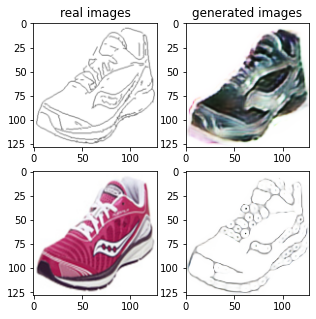

Train Epoch: 1 42% 	Total Loss: 1.608586 	Loss_G_AB: 0.316162	Loss_G_BA: 0.741663	Loss_cycle: 0.719598	Loss_D_A: 0.102393	Loss_D_B: 0.257683
0 21009 T:  1.663480281829834
Train Epoch: 1 42% 	Total Loss: 1.397260 	Loss_G_AB: 0.293070	Loss_G_BA: 0.954575	Loss_cycle: 0.510692	Loss_D_A: 0.031044	Loss_D_B: 0.231702
0 21019 T:  0.9431576728820801
Train Epoch: 1 42% 	Total Loss: 1.417165 	Loss_G_AB: 0.332259	Loss_G_BA: 0.874983	Loss_cycle: 0.509637	Loss_D_A: 0.038311	Loss_D_B: 0.265596
0 21029 T:  0.9660069942474365
Train Epoch: 1 42% 	Total Loss: 1.511011 	Loss_G_AB: 0.275980	Loss_G_BA: 0.844174	Loss_cycle: 0.596037	Loss_D_A: 0.093624	Loss_D_B: 0.261273
0 21039 T:  0.9297289848327637
Train Epoch: 1 42% 	Total Loss: 1.482673 	Loss_G_AB: 0.287322	Loss_G_BA: 0.920792	Loss_cycle: 0.549347	Loss_D_A: 0.048443	Loss_D_B: 0.280825
0 21049 T:  0.9490118026733398
Train Epoch: 1 42% 	Total Loss: 1.464336 	Loss_G_AB: 0.298319	Loss_G_BA: 0.936333	Loss_cycle: 0.601701	Loss_D_A: 0.022430	Loss_D_B: 0.222879


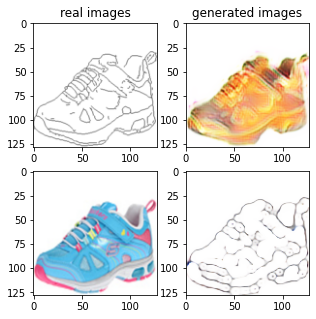

Train Epoch: 1 44% 	Total Loss: 1.580348 	Loss_G_AB: 0.335671	Loss_G_BA: 1.024984	Loss_cycle: 0.667904	Loss_D_A: 0.003714	Loss_D_B: 0.228402
0 22009 T:  1.5583875179290771
Train Epoch: 1 44% 	Total Loss: 1.425138 	Loss_G_AB: 0.261874	Loss_G_BA: 0.988392	Loss_cycle: 0.526855	Loss_D_A: 0.002633	Loss_D_B: 0.270517
0 22019 T:  0.8854355812072754
Train Epoch: 1 44% 	Total Loss: 1.368665 	Loss_G_AB: 0.315173	Loss_G_BA: 0.966577	Loss_cycle: 0.467168	Loss_D_A: 0.006365	Loss_D_B: 0.254257
0 22029 T:  0.9405426979064941
Train Epoch: 1 44% 	Total Loss: 1.414725 	Loss_G_AB: 0.297638	Loss_G_BA: 1.037875	Loss_cycle: 0.498336	Loss_D_A: 0.006628	Loss_D_B: 0.242004
0 22039 T:  0.9082705974578857
Train Epoch: 1 44% 	Total Loss: 1.446866 	Loss_G_AB: 0.300824	Loss_G_BA: 0.991894	Loss_cycle: 0.534549	Loss_D_A: 0.003870	Loss_D_B: 0.262087
0 22049 T:  0.9308297634124756
Train Epoch: 1 44% 	Total Loss: 1.520061 	Loss_G_AB: 0.348012	Loss_G_BA: 0.975881	Loss_cycle: 0.645178	Loss_D_A: 0.003366	Loss_D_B: 0.209571

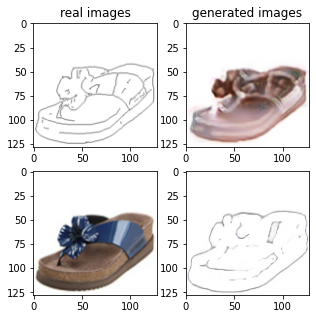

Train Epoch: 1 46% 	Total Loss: 1.425863 	Loss_G_AB: 0.312675	Loss_G_BA: 0.981659	Loss_cycle: 0.513140	Loss_D_A: 0.012135	Loss_D_B: 0.253421
0 23009 T:  1.5377438068389893
Train Epoch: 1 46% 	Total Loss: 1.451676 	Loss_G_AB: 0.304890	Loss_G_BA: 0.913876	Loss_cycle: 0.523960	Loss_D_A: 0.052852	Loss_D_B: 0.265482
0 23019 T:  0.9636611938476562
Train Epoch: 1 46% 	Total Loss: 1.321565 	Loss_G_AB: 0.291250	Loss_G_BA: 1.016180	Loss_cycle: 0.414570	Loss_D_A: 0.013463	Loss_D_B: 0.239818
0 23029 T:  0.9053490161895752
Train Epoch: 1 46% 	Total Loss: 1.338698 	Loss_G_AB: 0.325407	Loss_G_BA: 0.989080	Loss_cycle: 0.444519	Loss_D_A: 0.005390	Loss_D_B: 0.231545
0 23039 T:  0.9313435554504395
Train Epoch: 1 46% 	Total Loss: 1.566107 	Loss_G_AB: 0.297221	Loss_G_BA: 0.991855	Loss_cycle: 0.629731	Loss_D_A: 0.014641	Loss_D_B: 0.277197
0 23049 T:  0.889315128326416
Train Epoch: 1 46% 	Total Loss: 1.300822 	Loss_G_AB: 0.293873	Loss_G_BA: 1.007916	Loss_cycle: 0.394687	Loss_D_A: 0.006227	Loss_D_B: 0.249013


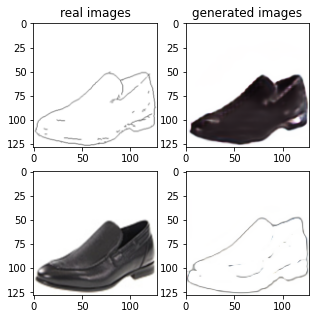

Train Epoch: 1 48% 	Total Loss: 1.373149 	Loss_G_AB: 0.358189	Loss_G_BA: 1.029966	Loss_cycle: 0.442905	Loss_D_A: 0.005627	Loss_D_B: 0.230540
0 24009 T:  1.5033252239227295
Train Epoch: 1 48% 	Total Loss: 1.452946 	Loss_G_AB: 0.267946	Loss_G_BA: 0.967957	Loss_cycle: 0.566396	Loss_D_A: 0.005304	Loss_D_B: 0.263294
0 24019 T:  0.9177567958831787
Train Epoch: 1 48% 	Total Loss: 1.448840 	Loss_G_AB: 0.302339	Loss_G_BA: 1.015918	Loss_cycle: 0.543710	Loss_D_A: 0.002847	Loss_D_B: 0.243154
0 24029 T:  0.9064426422119141
Train Epoch: 1 48% 	Total Loss: 1.403521 	Loss_G_AB: 0.326673	Loss_G_BA: 0.976728	Loss_cycle: 0.531419	Loss_D_A: 0.004495	Loss_D_B: 0.215908
0 24039 T:  0.9376957416534424
Train Epoch: 1 48% 	Total Loss: 1.440205 	Loss_G_AB: 0.322690	Loss_G_BA: 0.980224	Loss_cycle: 0.554862	Loss_D_A: 0.004420	Loss_D_B: 0.229467
0 24049 T:  0.8942341804504395
Train Epoch: 1 48% 	Total Loss: 1.616334 	Loss_G_AB: 0.355417	Loss_G_BA: 0.995777	Loss_cycle: 0.671341	Loss_D_A: 0.005885	Loss_D_B: 0.263512

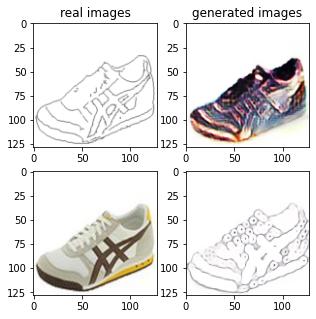

Train Epoch: 1 50% 	Total Loss: 1.434877 	Loss_G_AB: 0.264478	Loss_G_BA: 0.997672	Loss_cycle: 0.503522	Loss_D_A: 0.006811	Loss_D_B: 0.293469
0 25009 T:  1.53525710105896
Train Epoch: 1 50% 	Total Loss: 1.419565 	Loss_G_AB: 0.316417	Loss_G_BA: 0.967117	Loss_cycle: 0.545682	Loss_D_A: 0.010861	Loss_D_B: 0.221255
0 25019 T:  0.901341438293457
Train Epoch: 1 50% 	Total Loss: 1.369147 	Loss_G_AB: 0.279620	Loss_G_BA: 0.970697	Loss_cycle: 0.461276	Loss_D_A: 0.013796	Loss_D_B: 0.268916
0 25029 T:  0.9114432334899902
Train Epoch: 1 50% 	Total Loss: 1.367611 	Loss_G_AB: 0.284754	Loss_G_BA: 0.937222	Loss_cycle: 0.501427	Loss_D_A: 0.014693	Loss_D_B: 0.240503
0 25039 T:  0.9851603507995605
Train Epoch: 1 50% 	Total Loss: 1.476195 	Loss_G_AB: 0.289481	Loss_G_BA: 0.999077	Loss_cycle: 0.601783	Loss_D_A: 0.007836	Loss_D_B: 0.222297
0 25049 T:  0.9035091400146484
Train Epoch: 1 50% 	Total Loss: 1.380069 	Loss_G_AB: 0.317768	Loss_G_BA: 0.965386	Loss_cycle: 0.471501	Loss_D_A: 0.007706	Loss_D_B: 0.259285
0 

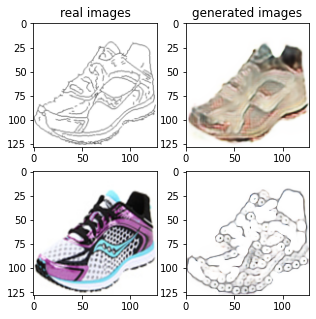

Train Epoch: 1 52% 	Total Loss: 1.400016 	Loss_G_AB: 0.320624	Loss_G_BA: 0.981241	Loss_cycle: 0.487018	Loss_D_A: 0.007783	Loss_D_B: 0.254282
0 26009 T:  1.5311839580535889
Train Epoch: 1 52% 	Total Loss: 1.349775 	Loss_G_AB: 0.295999	Loss_G_BA: 1.001342	Loss_cycle: 0.445834	Loss_D_A: 0.004934	Loss_D_B: 0.250337
0 26019 T:  0.9544172286987305
Train Epoch: 1 52% 	Total Loss: 1.192922 	Loss_G_AB: 0.284425	Loss_G_BA: 0.991623	Loss_cycle: 0.296142	Loss_D_A: 0.014151	Loss_D_B: 0.244604
0 26029 T:  1.0525989532470703
Train Epoch: 1 52% 	Total Loss: 1.305964 	Loss_G_AB: 0.315981	Loss_G_BA: 0.992616	Loss_cycle: 0.436263	Loss_D_A: 0.007787	Loss_D_B: 0.207616
0 26039 T:  0.8998582363128662
Train Epoch: 1 52% 	Total Loss: 1.530775 	Loss_G_AB: 0.340083	Loss_G_BA: 0.983813	Loss_cycle: 0.558232	Loss_D_A: 0.006252	Loss_D_B: 0.304343
0 26049 T:  0.9298217296600342
Train Epoch: 1 52% 	Total Loss: 1.444847 	Loss_G_AB: 0.362239	Loss_G_BA: 0.945910	Loss_cycle: 0.525896	Loss_D_A: 0.035198	Loss_D_B: 0.229679

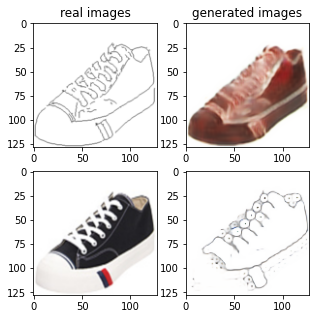

Train Epoch: 1 54% 	Total Loss: 1.334746 	Loss_G_AB: 0.334758	Loss_G_BA: 0.953748	Loss_cycle: 0.446980	Loss_D_A: 0.014032	Loss_D_B: 0.229481
0 27009 T:  1.5886616706848145
Train Epoch: 1 54% 	Total Loss: 1.454004 	Loss_G_AB: 0.294382	Loss_G_BA: 0.974430	Loss_cycle: 0.535933	Loss_D_A: 0.014247	Loss_D_B: 0.269418
0 27019 T:  0.9168779850006104
Train Epoch: 1 54% 	Total Loss: 1.320303 	Loss_G_AB: 0.281562	Loss_G_BA: 0.988104	Loss_cycle: 0.419594	Loss_D_A: 0.018234	Loss_D_B: 0.247642
0 27029 T:  0.9874887466430664
Train Epoch: 1 54% 	Total Loss: 1.330511 	Loss_G_AB: 0.291997	Loss_G_BA: 0.982925	Loss_cycle: 0.414717	Loss_D_A: 0.006655	Loss_D_B: 0.271678
0 27039 T:  1.0083189010620117
Train Epoch: 1 54% 	Total Loss: 1.339891 	Loss_G_AB: 0.347621	Loss_G_BA: 0.873125	Loss_cycle: 0.364683	Loss_D_A: 0.121046	Loss_D_B: 0.243790
0 27049 T:  0.8876004219055176
Train Epoch: 1 54% 	Total Loss: 1.407606 	Loss_G_AB: 0.285506	Loss_G_BA: 0.567820	Loss_cycle: 0.561605	Loss_D_A: 0.166503	Loss_D_B: 0.252834

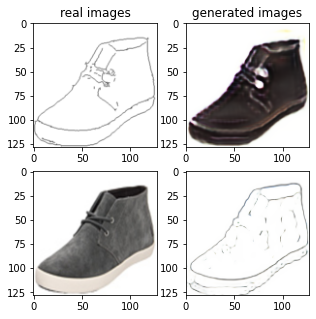

Train Epoch: 1 56% 	Total Loss: 1.333588 	Loss_G_AB: 0.303453	Loss_G_BA: 0.965841	Loss_cycle: 0.420387	Loss_D_A: 0.021017	Loss_D_B: 0.257538
0 28009 T:  1.595407247543335
Train Epoch: 1 56% 	Total Loss: 1.307473 	Loss_G_AB: 0.296212	Loss_G_BA: 1.015812	Loss_cycle: 0.400665	Loss_D_A: 0.009080	Loss_D_B: 0.241716
0 28019 T:  0.9080386161804199
Train Epoch: 1 56% 	Total Loss: 1.421381 	Loss_G_AB: 0.263853	Loss_G_BA: 0.962846	Loss_cycle: 0.543616	Loss_D_A: 0.005613	Loss_D_B: 0.258801
0 28029 T:  0.9015145301818848
Train Epoch: 1 56% 	Total Loss: 1.308167 	Loss_G_AB: 0.314500	Loss_G_BA: 1.000285	Loss_cycle: 0.425711	Loss_D_A: 0.017689	Loss_D_B: 0.207375
0 28039 T:  0.9191441535949707
Train Epoch: 1 56% 	Total Loss: 1.482520 	Loss_G_AB: 0.262388	Loss_G_BA: 0.937136	Loss_cycle: 0.582388	Loss_D_A: 0.014139	Loss_D_B: 0.286231
0 28049 T:  0.9005095958709717
Train Epoch: 1 56% 	Total Loss: 1.305186 	Loss_G_AB: 0.272604	Loss_G_BA: 0.984064	Loss_cycle: 0.413387	Loss_D_A: 0.011000	Loss_D_B: 0.252465


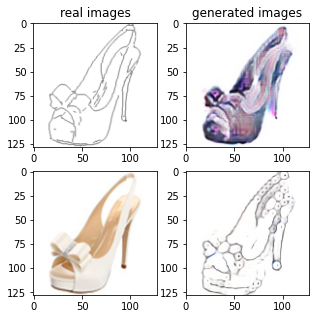

Train Epoch: 1 58% 	Total Loss: 1.402797 	Loss_G_AB: 0.332133	Loss_G_BA: 0.978040	Loss_cycle: 0.481611	Loss_D_A: 0.008909	Loss_D_B: 0.257191
0 29009 T:  1.560873031616211
Train Epoch: 1 58% 	Total Loss: 1.516005 	Loss_G_AB: 0.282040	Loss_G_BA: 1.004317	Loss_cycle: 0.604558	Loss_D_A: 0.003810	Loss_D_B: 0.264458
0 29019 T:  0.9010915756225586
Train Epoch: 1 58% 	Total Loss: 1.434734 	Loss_G_AB: 0.354076	Loss_G_BA: 0.980687	Loss_cycle: 0.522956	Loss_D_A: 0.005995	Loss_D_B: 0.238401
0 29029 T:  0.9290134906768799
Train Epoch: 1 58% 	Total Loss: 1.267172 	Loss_G_AB: 0.306715	Loss_G_BA: 0.982677	Loss_cycle: 0.389217	Loss_D_A: 0.005366	Loss_D_B: 0.227893
0 29039 T:  1.0037012100219727
Train Epoch: 1 58% 	Total Loss: 1.418777 	Loss_G_AB: 0.311845	Loss_G_BA: 1.022419	Loss_cycle: 0.519297	Loss_D_A: 0.005007	Loss_D_B: 0.227341
0 29049 T:  0.9107828140258789
Train Epoch: 1 58% 	Total Loss: 1.424882 	Loss_G_AB: 0.258462	Loss_G_BA: 0.985602	Loss_cycle: 0.516569	Loss_D_A: 0.002876	Loss_D_B: 0.283404


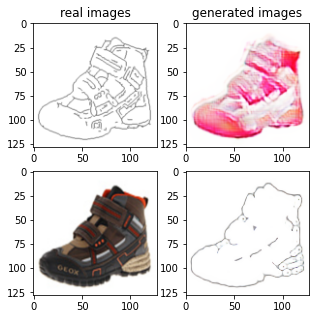

Train Epoch: 1 60% 	Total Loss: 1.447725 	Loss_G_AB: 0.314742	Loss_G_BA: 0.700446	Loss_cycle: 0.441554	Loss_D_A: 0.247785	Loss_D_B: 0.250792
0 30009 T:  1.5218358039855957
Train Epoch: 1 60% 	Total Loss: 1.345747 	Loss_G_AB: 0.297003	Loss_G_BA: 0.518055	Loss_cycle: 0.484742	Loss_D_A: 0.190545	Loss_D_B: 0.262931
0 30019 T:  0.9107980728149414
Train Epoch: 1 60% 	Total Loss: 1.329620 	Loss_G_AB: 0.279137	Loss_G_BA: 0.611297	Loss_cycle: 0.497816	Loss_D_A: 0.152288	Loss_D_B: 0.234298
0 30029 T:  1.0382108688354492
Train Epoch: 1 60% 	Total Loss: 1.465093 	Loss_G_AB: 0.350307	Loss_G_BA: 0.720858	Loss_cycle: 0.617987	Loss_D_A: 0.107972	Loss_D_B: 0.203551
0 30039 T:  0.9311659336090088
Train Epoch: 1 60% 	Total Loss: 1.424467 	Loss_G_AB: 0.365397	Loss_G_BA: 0.811499	Loss_cycle: 0.533483	Loss_D_A: 0.064613	Loss_D_B: 0.237922
0 30049 T:  0.913273811340332
Train Epoch: 1 60% 	Total Loss: 1.267956 	Loss_G_AB: 0.304063	Loss_G_BA: 0.663348	Loss_cycle: 0.389236	Loss_D_A: 0.136438	Loss_D_B: 0.258576


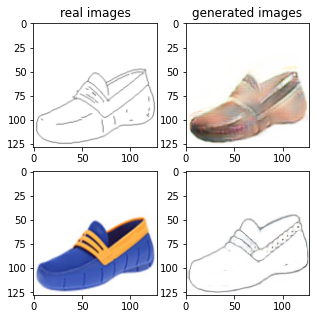

Train Epoch: 1 62% 	Total Loss: 1.319150 	Loss_G_AB: 0.293019	Loss_G_BA: 0.760310	Loss_cycle: 0.497461	Loss_D_A: 0.041073	Loss_D_B: 0.253951
0 31009 T:  1.5058841705322266
Train Epoch: 1 62% 	Total Loss: 1.408883 	Loss_G_AB: 0.319200	Loss_G_BA: 0.827852	Loss_cycle: 0.480353	Loss_D_A: 0.102659	Loss_D_B: 0.252345
0 31019 T:  0.9007894992828369
Train Epoch: 1 62% 	Total Loss: 1.350439 	Loss_G_AB: 0.278091	Loss_G_BA: 0.963235	Loss_cycle: 0.444770	Loss_D_A: 0.045135	Loss_D_B: 0.239871
0 31029 T:  0.8884232044219971
Train Epoch: 1 62% 	Total Loss: 1.371325 	Loss_G_AB: 0.273789	Loss_G_BA: 1.016870	Loss_cycle: 0.450711	Loss_D_A: 0.016534	Loss_D_B: 0.258750
0 31039 T:  0.8881206512451172
Train Epoch: 1 62% 	Total Loss: 1.320227 	Loss_G_AB: 0.289811	Loss_G_BA: 1.020064	Loss_cycle: 0.422710	Loss_D_A: 0.005333	Loss_D_B: 0.237246
0 31049 T:  0.9001555442810059
Train Epoch: 1 62% 	Total Loss: 1.315059 	Loss_G_AB: 0.280432	Loss_G_BA: 1.004897	Loss_cycle: 0.429256	Loss_D_A: 0.005861	Loss_D_B: 0.237279

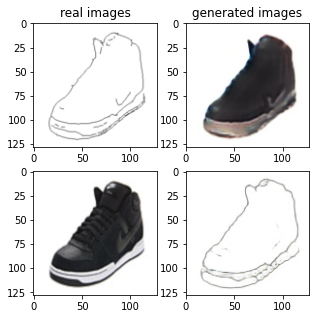

Train Epoch: 1 64% 	Total Loss: 1.372630 	Loss_G_AB: 0.307245	Loss_G_BA: 0.973296	Loss_cycle: 0.449100	Loss_D_A: 0.012742	Loss_D_B: 0.270518
0 32009 T:  1.5097579956054688
Train Epoch: 1 64% 	Total Loss: 1.423947 	Loss_G_AB: 0.316661	Loss_G_BA: 0.998913	Loss_cycle: 0.471704	Loss_D_A: 0.020759	Loss_D_B: 0.273696
0 32019 T:  1.0818188190460205
Train Epoch: 1 64% 	Total Loss: 1.365457 	Loss_G_AB: 0.313749	Loss_G_BA: 0.948907	Loss_cycle: 0.463077	Loss_D_A: 0.028316	Loss_D_B: 0.242736
0 32029 T:  0.8881218433380127
Train Epoch: 1 64% 	Total Loss: 1.356902 	Loss_G_AB: 0.351599	Loss_G_BA: 0.928275	Loss_cycle: 0.484780	Loss_D_A: 0.011809	Loss_D_B: 0.220377
0 32039 T:  0.9751555919647217
Train Epoch: 1 64% 	Total Loss: 1.414713 	Loss_G_AB: 0.291211	Loss_G_BA: 0.983613	Loss_cycle: 0.483145	Loss_D_A: 0.026689	Loss_D_B: 0.267468
0 32049 T:  0.9859592914581299
Train Epoch: 1 64% 	Total Loss: 1.497781 	Loss_G_AB: 0.269726	Loss_G_BA: 0.957164	Loss_cycle: 0.593297	Loss_D_A: 0.024081	Loss_D_B: 0.266958

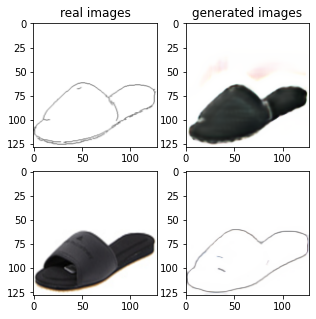

Train Epoch: 1 66% 	Total Loss: 1.394719 	Loss_G_AB: 0.243664	Loss_G_BA: 0.873583	Loss_cycle: 0.513563	Loss_D_A: 0.040065	Loss_D_B: 0.282467
0 33009 T:  1.5287351608276367
Train Epoch: 1 66% 	Total Loss: 1.337435 	Loss_G_AB: 0.278324	Loss_G_BA: 0.960185	Loss_cycle: 0.430580	Loss_D_A: 0.033692	Loss_D_B: 0.253908
0 33019 T:  0.8937113285064697
Train Epoch: 1 66% 	Total Loss: 1.368064 	Loss_G_AB: 0.294395	Loss_G_BA: 0.912762	Loss_cycle: 0.397757	Loss_D_A: 0.123715	Loss_D_B: 0.243013
0 33029 T:  0.9050025939941406
Train Epoch: 1 66% 	Total Loss: 1.468429 	Loss_G_AB: 0.320866	Loss_G_BA: 0.993177	Loss_cycle: 0.538571	Loss_D_A: 0.016776	Loss_D_B: 0.256061
0 33039 T:  0.9170918464660645
Train Epoch: 1 66% 	Total Loss: 1.344935 	Loss_G_AB: 0.269488	Loss_G_BA: 0.970302	Loss_cycle: 0.471696	Loss_D_A: 0.010669	Loss_D_B: 0.242675
0 33049 T:  0.8883516788482666
Train Epoch: 1 66% 	Total Loss: 1.337788 	Loss_G_AB: 0.273025	Loss_G_BA: 0.975539	Loss_cycle: 0.436959	Loss_D_A: 0.017325	Loss_D_B: 0.259221

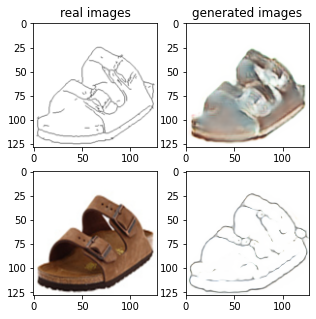

Train Epoch: 1 68% 	Total Loss: 1.327056 	Loss_G_AB: 0.287785	Loss_G_BA: 0.986728	Loss_cycle: 0.436216	Loss_D_A: 0.005765	Loss_D_B: 0.247818
0 34009 T:  1.5975663661956787
Train Epoch: 1 68% 	Total Loss: 1.319749 	Loss_G_AB: 0.331982	Loss_G_BA: 0.999966	Loss_cycle: 0.434641	Loss_D_A: 0.003010	Loss_D_B: 0.216124
0 34019 T:  0.9074978828430176
Train Epoch: 1 68% 	Total Loss: 1.292583 	Loss_G_AB: 0.278986	Loss_G_BA: 0.982178	Loss_cycle: 0.386437	Loss_D_A: 0.003663	Loss_D_B: 0.271901
0 34029 T:  0.9558615684509277
Train Epoch: 1 68% 	Total Loss: 1.251459 	Loss_G_AB: 0.284286	Loss_G_BA: 0.761626	Loss_cycle: 0.340865	Loss_D_A: 0.144948	Loss_D_B: 0.242689
0 34039 T:  0.9019834995269775
Train Epoch: 1 68% 	Total Loss: 1.245543 	Loss_G_AB: 0.325340	Loss_G_BA: 0.779022	Loss_cycle: 0.400498	Loss_D_A: 0.053822	Loss_D_B: 0.239041
0 34049 T:  0.8997139930725098
Train Epoch: 1 68% 	Total Loss: 1.397961 	Loss_G_AB: 0.294913	Loss_G_BA: 0.848258	Loss_cycle: 0.420945	Loss_D_A: 0.140736	Loss_D_B: 0.264695

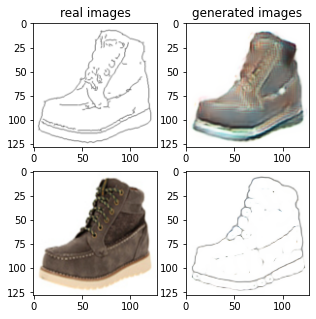

Train Epoch: 1 70% 	Total Loss: 1.244659 	Loss_G_AB: 0.283903	Loss_G_BA: 0.963868	Loss_cycle: 0.383473	Loss_D_A: 0.005255	Loss_D_B: 0.232046
0 35009 T:  1.5762372016906738
Train Epoch: 1 70% 	Total Loss: 1.302575 	Loss_G_AB: 0.335716	Loss_G_BA: 1.021564	Loss_cycle: 0.386940	Loss_D_A: 0.004977	Loss_D_B: 0.232018
0 35019 T:  0.9376888275146484
Train Epoch: 1 70% 	Total Loss: 1.368557 	Loss_G_AB: 0.268837	Loss_G_BA: 1.018644	Loss_cycle: 0.451384	Loss_D_A: 0.005088	Loss_D_B: 0.268344
0 35029 T:  0.8870162963867188
Train Epoch: 1 70% 	Total Loss: 1.344565 	Loss_G_AB: 0.317448	Loss_G_BA: 0.978833	Loss_cycle: 0.454786	Loss_D_A: 0.003375	Loss_D_B: 0.238263
0 35039 T:  0.8985393047332764
Train Epoch: 1 70% 	Total Loss: 1.478356 	Loss_G_AB: 0.308239	Loss_G_BA: 0.985508	Loss_cycle: 0.578006	Loss_D_A: 0.008052	Loss_D_B: 0.245425
0 35049 T:  0.91172194480896
Train Epoch: 1 70% 	Total Loss: 1.408522 	Loss_G_AB: 0.280843	Loss_G_BA: 0.989191	Loss_cycle: 0.503143	Loss_D_A: 0.005165	Loss_D_B: 0.265196
0

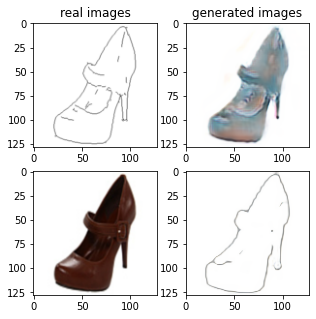

Train Epoch: 1 72% 	Total Loss: 1.367079 	Loss_G_AB: 0.321670	Loss_G_BA: 0.873172	Loss_cycle: 0.472422	Loss_D_A: 0.056900	Loss_D_B: 0.240336
0 36009 T:  1.5536561012268066
Train Epoch: 1 72% 	Total Loss: 1.363789 	Loss_G_AB: 0.342779	Loss_G_BA: 0.817803	Loss_cycle: 0.482269	Loss_D_A: 0.074575	Loss_D_B: 0.226654
0 36019 T:  0.9077892303466797
Train Epoch: 1 72% 	Total Loss: 1.512246 	Loss_G_AB: 0.313431	Loss_G_BA: 1.075325	Loss_cycle: 0.575699	Loss_D_A: 0.014217	Loss_D_B: 0.227952
0 36029 T:  0.9107427597045898
Train Epoch: 1 72% 	Total Loss: 1.461253 	Loss_G_AB: 0.339781	Loss_G_BA: 0.931514	Loss_cycle: 0.565283	Loss_D_A: 0.022022	Loss_D_B: 0.238300
0 36039 T:  0.9401662349700928
Train Epoch: 1 72% 	Total Loss: 1.377002 	Loss_G_AB: 0.296803	Loss_G_BA: 0.837888	Loss_cycle: 0.479386	Loss_D_A: 0.052310	Loss_D_B: 0.277961
0 36049 T:  0.9043314456939697
Train Epoch: 1 72% 	Total Loss: 1.296980 	Loss_G_AB: 0.281138	Loss_G_BA: 0.775736	Loss_cycle: 0.415406	Loss_D_A: 0.098529	Loss_D_B: 0.254607

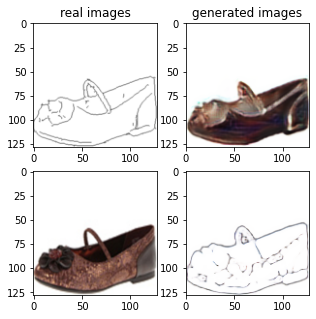

Train Epoch: 1 74% 	Total Loss: 1.362200 	Loss_G_AB: 0.297719	Loss_G_BA: 0.984812	Loss_cycle: 0.428006	Loss_D_A: 0.001947	Loss_D_B: 0.290982
0 37009 T:  1.5138049125671387
Train Epoch: 1 74% 	Total Loss: 1.309838 	Loss_G_AB: 0.265601	Loss_G_BA: 0.999074	Loss_cycle: 0.426106	Loss_D_A: 0.002105	Loss_D_B: 0.249290
0 37019 T:  0.9154000282287598
Train Epoch: 1 74% 	Total Loss: 1.366491 	Loss_G_AB: 0.322057	Loss_G_BA: 1.004243	Loss_cycle: 0.480621	Loss_D_A: 0.002978	Loss_D_B: 0.219742
0 37029 T:  0.9721989631652832
Train Epoch: 1 74% 	Total Loss: 1.350165 	Loss_G_AB: 0.269350	Loss_G_BA: 0.957101	Loss_cycle: 0.485653	Loss_D_A: 0.005198	Loss_D_B: 0.246089
0 37039 T:  0.8730678558349609
Train Epoch: 1 74% 	Total Loss: 1.415546 	Loss_G_AB: 0.314906	Loss_G_BA: 1.016254	Loss_cycle: 0.484065	Loss_D_A: 0.004172	Loss_D_B: 0.261728
0 37049 T:  0.8955996036529541
Train Epoch: 1 74% 	Total Loss: 1.352187 	Loss_G_AB: 0.319711	Loss_G_BA: 1.000344	Loss_cycle: 0.437696	Loss_D_A: 0.005547	Loss_D_B: 0.248917

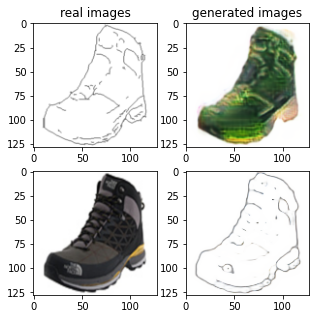

Train Epoch: 1 76% 	Total Loss: 1.332381 	Loss_G_AB: 0.270840	Loss_G_BA: 1.014797	Loss_cycle: 0.423918	Loss_D_A: 0.003833	Loss_D_B: 0.261811
0 38009 T:  1.5102410316467285
Train Epoch: 1 76% 	Total Loss: 1.316443 	Loss_G_AB: 0.261364	Loss_G_BA: 0.951707	Loss_cycle: 0.426721	Loss_D_A: 0.010745	Loss_D_B: 0.272442
0 38019 T:  0.9828932285308838
Train Epoch: 1 76% 	Total Loss: 1.344157 	Loss_G_AB: 0.272303	Loss_G_BA: 1.034665	Loss_cycle: 0.418461	Loss_D_A: 0.006682	Loss_D_B: 0.265531
0 38029 T:  0.9072554111480713
Train Epoch: 1 76% 	Total Loss: 1.269138 	Loss_G_AB: 0.282018	Loss_G_BA: 0.990921	Loss_cycle: 0.380426	Loss_D_A: 0.006377	Loss_D_B: 0.245865
0 38039 T:  0.9562427997589111
Train Epoch: 1 76% 	Total Loss: 1.328733 	Loss_G_AB: 0.295186	Loss_G_BA: 1.017017	Loss_cycle: 0.443903	Loss_D_A: 0.003414	Loss_D_B: 0.225314
0 38049 T:  0.8827950954437256
Train Epoch: 1 76% 	Total Loss: 1.254449 	Loss_G_AB: 0.324047	Loss_G_BA: 0.981034	Loss_cycle: 0.398385	Loss_D_A: 0.004068	Loss_D_B: 0.199456

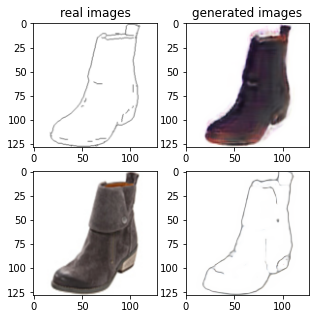

Train Epoch: 1 78% 	Total Loss: 1.290780 	Loss_G_AB: 0.295184	Loss_G_BA: 0.883149	Loss_cycle: 0.417521	Loss_D_A: 0.033041	Loss_D_B: 0.251051
0 39009 T:  1.505199670791626
Train Epoch: 1 78% 	Total Loss: 1.358962 	Loss_G_AB: 0.290391	Loss_G_BA: 0.989180	Loss_cycle: 0.453162	Loss_D_A: 0.010009	Loss_D_B: 0.256006
0 39019 T:  0.9055094718933105
Train Epoch: 1 78% 	Total Loss: 1.429013 	Loss_G_AB: 0.301278	Loss_G_BA: 1.008151	Loss_cycle: 0.529159	Loss_D_A: 0.009474	Loss_D_B: 0.235666
0 39029 T:  0.8871815204620361
Train Epoch: 1 78% 	Total Loss: 1.292410 	Loss_G_AB: 0.292878	Loss_G_BA: 0.987896	Loss_cycle: 0.399196	Loss_D_A: 0.018888	Loss_D_B: 0.233940
0 39039 T:  0.8848705291748047
Train Epoch: 1 78% 	Total Loss: 1.478000 	Loss_G_AB: 0.318836	Loss_G_BA: 0.926552	Loss_cycle: 0.606405	Loss_D_A: 0.024579	Loss_D_B: 0.224322
0 39049 T:  0.8884625434875488
Train Epoch: 1 78% 	Total Loss: 1.400559 	Loss_G_AB: 0.310734	Loss_G_BA: 0.914216	Loss_cycle: 0.464355	Loss_D_A: 0.064781	Loss_D_B: 0.258948


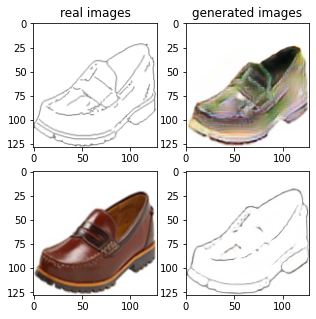

Train Epoch: 1 80% 	Total Loss: 1.338468 	Loss_G_AB: 0.280911	Loss_G_BA: 1.010387	Loss_cycle: 0.436165	Loss_D_A: 0.003300	Loss_D_B: 0.253354
0 40009 T:  1.5042614936828613
Train Epoch: 1 80% 	Total Loss: 1.333769 	Loss_G_AB: 0.283847	Loss_G_BA: 0.987112	Loss_cycle: 0.445692	Loss_D_A: 0.003061	Loss_D_B: 0.249537
0 40019 T:  0.9165115356445312
Train Epoch: 1 80% 	Total Loss: 1.413162 	Loss_G_AB: 0.288134	Loss_G_BA: 0.783408	Loss_cycle: 0.548676	Loss_D_A: 0.079229	Loss_D_B: 0.249487
0 40029 T:  0.9488823413848877
Train Epoch: 1 80% 	Total Loss: 1.221577 	Loss_G_AB: 0.358851	Loss_G_BA: 0.820492	Loss_cycle: 0.390035	Loss_D_A: 0.036959	Loss_D_B: 0.204911
0 40039 T:  0.90671706199646
Train Epoch: 1 80% 	Total Loss: 1.421426 	Loss_G_AB: 0.288822	Loss_G_BA: 0.775980	Loss_cycle: 0.487633	Loss_D_A: 0.169509	Loss_D_B: 0.231882
0 40049 T:  0.8704774379730225
Train Epoch: 1 80% 	Total Loss: 1.232666 	Loss_G_AB: 0.308310	Loss_G_BA: 0.535494	Loss_cycle: 0.355237	Loss_D_A: 0.180158	Loss_D_B: 0.275369
0

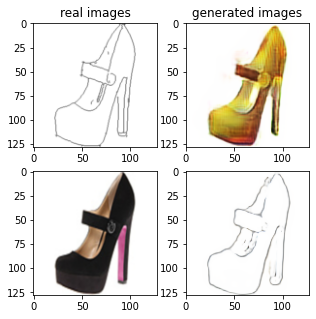

Train Epoch: 1 82% 	Total Loss: 1.402297 	Loss_G_AB: 0.339922	Loss_G_BA: 0.988970	Loss_cycle: 0.486957	Loss_D_A: 0.002639	Loss_D_B: 0.248255
0 41009 T:  1.5917298793792725
Train Epoch: 1 82% 	Total Loss: 1.373181 	Loss_G_AB: 0.326978	Loss_G_BA: 1.007660	Loss_cycle: 0.457670	Loss_D_A: 0.003048	Loss_D_B: 0.245144
0 41019 T:  0.9611794948577881
Train Epoch: 1 82% 	Total Loss: 1.368522 	Loss_G_AB: 0.294790	Loss_G_BA: 1.003222	Loss_cycle: 0.471278	Loss_D_A: 0.006220	Loss_D_B: 0.242018
0 41029 T:  0.8884015083312988
Train Epoch: 1 82% 	Total Loss: 1.320165 	Loss_G_AB: 0.285238	Loss_G_BA: 1.002151	Loss_cycle: 0.430125	Loss_D_A: 0.002646	Loss_D_B: 0.243700
0 41039 T:  0.8938095569610596
Train Epoch: 1 82% 	Total Loss: 1.393479 	Loss_G_AB: 0.326080	Loss_G_BA: 1.000817	Loss_cycle: 0.476144	Loss_D_A: 0.002611	Loss_D_B: 0.251275
0 41049 T:  0.8802740573883057
Train Epoch: 1 82% 	Total Loss: 1.305599 	Loss_G_AB: 0.269635	Loss_G_BA: 0.986505	Loss_cycle: 0.412216	Loss_D_A: 0.004393	Loss_D_B: 0.260920

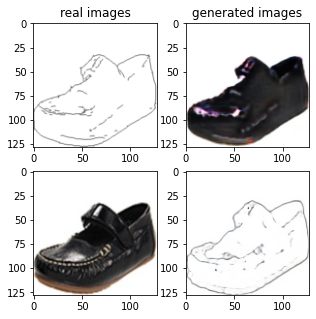

Train Epoch: 1 84% 	Total Loss: 1.348200 	Loss_G_AB: 0.315478	Loss_G_BA: 0.982546	Loss_cycle: 0.461760	Loss_D_A: 0.003764	Loss_D_B: 0.233663
0 42009 T:  1.524003028869629
Train Epoch: 1 84% 	Total Loss: 1.318479 	Loss_G_AB: 0.321664	Loss_G_BA: 0.989973	Loss_cycle: 0.425543	Loss_D_A: 0.009468	Loss_D_B: 0.227650
0 42019 T:  0.9354126453399658
Train Epoch: 1 84% 	Total Loss: 1.305618 	Loss_G_AB: 0.341909	Loss_G_BA: 0.997532	Loss_cycle: 0.408850	Loss_D_A: 0.004302	Loss_D_B: 0.222745
0 42029 T:  0.8917691707611084
Train Epoch: 1 84% 	Total Loss: 1.410047 	Loss_G_AB: 0.258452	Loss_G_BA: 1.005026	Loss_cycle: 0.471988	Loss_D_A: 0.002646	Loss_D_B: 0.303674
0 42039 T:  0.8985545635223389
Train Epoch: 1 84% 	Total Loss: 1.334616 	Loss_G_AB: 0.282934	Loss_G_BA: 0.967298	Loss_cycle: 0.441865	Loss_D_A: 0.006979	Loss_D_B: 0.260656
0 42049 T:  0.9353475570678711
Train Epoch: 1 84% 	Total Loss: 1.307670 	Loss_G_AB: 0.294497	Loss_G_BA: 0.993892	Loss_cycle: 0.432026	Loss_D_A: 0.002976	Loss_D_B: 0.228473


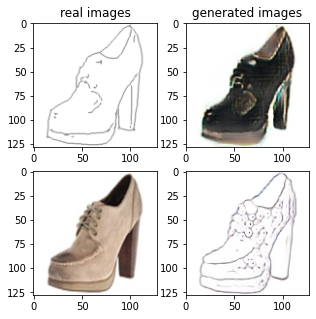

Train Epoch: 1 86% 	Total Loss: 1.278695 	Loss_G_AB: 0.311955	Loss_G_BA: 0.970445	Loss_cycle: 0.377147	Loss_D_A: 0.016376	Loss_D_B: 0.243972
0 43009 T:  1.5945005416870117
Train Epoch: 1 86% 	Total Loss: 1.353522 	Loss_G_AB: 0.281284	Loss_G_BA: 0.940742	Loss_cycle: 0.442664	Loss_D_A: 0.040111	Loss_D_B: 0.259735
0 43019 T:  0.8985321521759033
Train Epoch: 1 86% 	Total Loss: 1.415706 	Loss_G_AB: 0.313253	Loss_G_BA: 0.971451	Loss_cycle: 0.509905	Loss_D_A: 0.013272	Loss_D_B: 0.250178
0 43029 T:  0.892143964767456
Train Epoch: 1 86% 	Total Loss: 1.298270 	Loss_G_AB: 0.294106	Loss_G_BA: 0.942434	Loss_cycle: 0.420543	Loss_D_A: 0.012040	Loss_D_B: 0.247417
0 43039 T:  0.9136221408843994
Train Epoch: 1 86% 	Total Loss: 1.274333 	Loss_G_AB: 0.295366	Loss_G_BA: 0.767138	Loss_cycle: 0.378291	Loss_D_A: 0.099957	Loss_D_B: 0.264832
0 43049 T:  0.8897790908813477
Train Epoch: 1 86% 	Total Loss: 1.239494 	Loss_G_AB: 0.329165	Loss_G_BA: 0.777106	Loss_cycle: 0.363073	Loss_D_A: 0.097888	Loss_D_B: 0.225397


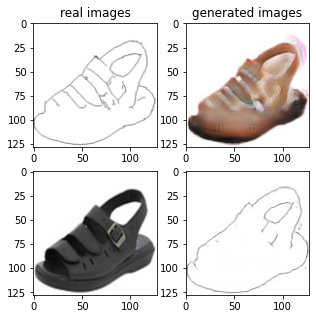

Train Epoch: 1 88% 	Total Loss: 1.333628 	Loss_G_AB: 0.260799	Loss_G_BA: 0.483909	Loss_cycle: 0.483452	Loss_D_A: 0.192944	Loss_D_B: 0.284879
0 44009 T:  1.5839793682098389
Train Epoch: 1 88% 	Total Loss: 1.296431 	Loss_G_AB: 0.290346	Loss_G_BA: 0.630029	Loss_cycle: 0.410276	Loss_D_A: 0.161694	Loss_D_B: 0.264274
0 44019 T:  0.8757123947143555
Train Epoch: 1 88% 	Total Loss: 1.312556 	Loss_G_AB: 0.283155	Loss_G_BA: 0.683395	Loss_cycle: 0.497042	Loss_D_A: 0.078732	Loss_D_B: 0.253508
0 44029 T:  0.921900749206543
Train Epoch: 1 88% 	Total Loss: 1.345613 	Loss_G_AB: 0.307540	Loss_G_BA: 0.586027	Loss_cycle: 0.417429	Loss_D_A: 0.233754	Loss_D_B: 0.247647
0 44039 T:  0.8925058841705322
Train Epoch: 1 88% 	Total Loss: 1.269074 	Loss_G_AB: 0.298862	Loss_G_BA: 0.636475	Loss_cycle: 0.431675	Loss_D_A: 0.111708	Loss_D_B: 0.258023
0 44049 T:  0.8845541477203369
Train Epoch: 1 88% 	Total Loss: 1.333151 	Loss_G_AB: 0.319142	Loss_G_BA: 0.629227	Loss_cycle: 0.505942	Loss_D_A: 0.124406	Loss_D_B: 0.228619


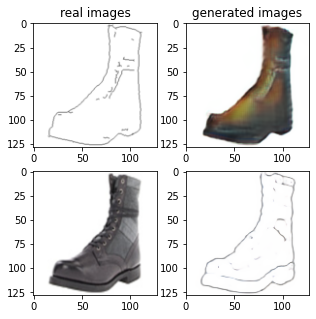

Train Epoch: 1 90% 	Total Loss: 1.362720 	Loss_G_AB: 0.354837	Loss_G_BA: 0.993626	Loss_cycle: 0.409265	Loss_D_A: 0.004724	Loss_D_B: 0.274499
0 45009 T:  1.5285148620605469
Train Epoch: 1 90% 	Total Loss: 1.414726 	Loss_G_AB: 0.360726	Loss_G_BA: 0.999563	Loss_cycle: 0.481840	Loss_D_A: 0.003225	Loss_D_B: 0.249516
0 45019 T:  0.937354326248169
Train Epoch: 1 90% 	Total Loss: 1.314276 	Loss_G_AB: 0.297972	Loss_G_BA: 0.992249	Loss_cycle: 0.408626	Loss_D_A: 0.002855	Loss_D_B: 0.257686
0 45029 T:  0.9270505905151367
Train Epoch: 1 90% 	Total Loss: 1.391634 	Loss_G_AB: 0.312400	Loss_G_BA: 0.994203	Loss_cycle: 0.504869	Loss_D_A: 0.002873	Loss_D_B: 0.230591
0 45039 T:  0.9736528396606445
Train Epoch: 1 90% 	Total Loss: 1.291293 	Loss_G_AB: 0.328689	Loss_G_BA: 1.013575	Loss_cycle: 0.386440	Loss_D_A: 0.004324	Loss_D_B: 0.229396
0 45049 T:  0.8840806484222412
Train Epoch: 1 90% 	Total Loss: 1.457451 	Loss_G_AB: 0.305078	Loss_G_BA: 1.001941	Loss_cycle: 0.556036	Loss_D_A: 0.004092	Loss_D_B: 0.243813


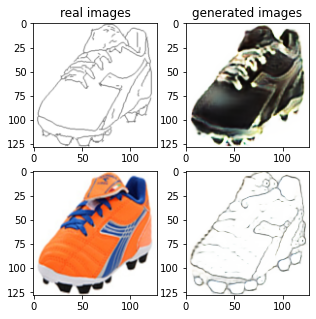

Train Epoch: 1 92% 	Total Loss: 1.387034 	Loss_G_AB: 0.338611	Loss_G_BA: 1.014055	Loss_cycle: 0.484745	Loss_D_A: 0.002462	Loss_D_B: 0.223494
0 46009 T:  1.5090975761413574
Train Epoch: 1 92% 	Total Loss: 1.234002 	Loss_G_AB: 0.259061	Loss_G_BA: 0.970841	Loss_cycle: 0.358840	Loss_D_A: 0.004336	Loss_D_B: 0.255875
0 46019 T:  0.8966078758239746
Train Epoch: 1 92% 	Total Loss: 1.242142 	Loss_G_AB: 0.344408	Loss_G_BA: 1.007298	Loss_cycle: 0.356357	Loss_D_A: 0.006938	Loss_D_B: 0.202994
0 46029 T:  0.9125032424926758
Train Epoch: 1 92% 	Total Loss: 1.261801 	Loss_G_AB: 0.270152	Loss_G_BA: 0.991996	Loss_cycle: 0.339214	Loss_D_A: 0.003740	Loss_D_B: 0.287773
0 46039 T:  0.8929657936096191
Train Epoch: 1 92% 	Total Loss: 1.313960 	Loss_G_AB: 0.313746	Loss_G_BA: 1.020435	Loss_cycle: 0.410564	Loss_D_A: 0.002928	Loss_D_B: 0.233378
0 46049 T:  0.8815515041351318
Train Epoch: 1 92% 	Total Loss: 1.360200 	Loss_G_AB: 0.288994	Loss_G_BA: 0.991003	Loss_cycle: 0.456317	Loss_D_A: 0.002548	Loss_D_B: 0.261336

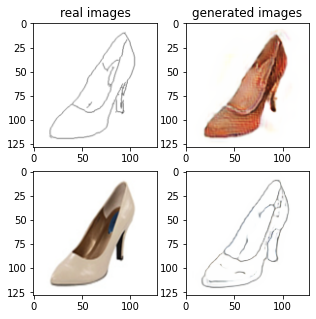

Train Epoch: 1 94% 	Total Loss: 1.245126 	Loss_G_AB: 0.299395	Loss_G_BA: 0.981777	Loss_cycle: 0.336778	Loss_D_A: 0.005301	Loss_D_B: 0.262460
0 47009 T:  1.6295297145843506
Train Epoch: 1 94% 	Total Loss: 1.366912 	Loss_G_AB: 0.289335	Loss_G_BA: 0.992447	Loss_cycle: 0.457521	Loss_D_A: 0.005240	Loss_D_B: 0.263260
0 47019 T:  0.8859207630157471
Train Epoch: 1 94% 	Total Loss: 1.303332 	Loss_G_AB: 0.274530	Loss_G_BA: 1.035489	Loss_cycle: 0.398596	Loss_D_A: 0.006734	Loss_D_B: 0.242993
0 47029 T:  0.8821654319763184
Train Epoch: 1 94% 	Total Loss: 1.351904 	Loss_G_AB: 0.358783	Loss_G_BA: 1.014480	Loss_cycle: 0.405373	Loss_D_A: 0.003132	Loss_D_B: 0.256768
0 47039 T:  0.8985614776611328
Train Epoch: 1 94% 	Total Loss: 1.168755 	Loss_G_AB: 0.296459	Loss_G_BA: 0.972620	Loss_cycle: 0.298579	Loss_D_A: 0.004356	Loss_D_B: 0.231280
0 47049 T:  0.8924248218536377
Train Epoch: 1 94% 	Total Loss: 1.308696 	Loss_G_AB: 0.273270	Loss_G_BA: 1.001984	Loss_cycle: 0.388392	Loss_D_A: 0.003503	Loss_D_B: 0.279174

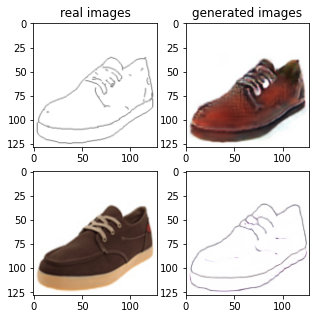

Train Epoch: 1 96% 	Total Loss: 1.333481 	Loss_G_AB: 0.288654	Loss_G_BA: 1.005736	Loss_cycle: 0.423301	Loss_D_A: 0.001937	Loss_D_B: 0.261048
0 48009 T:  1.6759650707244873
Train Epoch: 1 96% 	Total Loss: 1.247994 	Loss_G_AB: 0.246349	Loss_G_BA: 1.003868	Loss_cycle: 0.342907	Loss_D_A: 0.001707	Loss_D_B: 0.278271
0 48019 T:  0.9348852634429932
Train Epoch: 1 96% 	Total Loss: 1.276877 	Loss_G_AB: 0.306889	Loss_G_BA: 0.990539	Loss_cycle: 0.390791	Loss_D_A: 0.003140	Loss_D_B: 0.234232
0 48029 T:  0.8973066806793213
Train Epoch: 1 96% 	Total Loss: 1.465684 	Loss_G_AB: 0.273318	Loss_G_BA: 0.998431	Loss_cycle: 0.550665	Loss_D_A: 0.002889	Loss_D_B: 0.276256
0 48039 T:  0.9519667625427246
Train Epoch: 1 96% 	Total Loss: 1.387863 	Loss_G_AB: 0.270960	Loss_G_BA: 1.004873	Loss_cycle: 0.474772	Loss_D_A: 0.003670	Loss_D_B: 0.271505
0 48049 T:  0.8934290409088135
Train Epoch: 1 96% 	Total Loss: 1.150296 	Loss_G_AB: 0.268259	Loss_G_BA: 1.006909	Loss_cycle: 0.274906	Loss_D_A: 0.001236	Loss_D_B: 0.236570

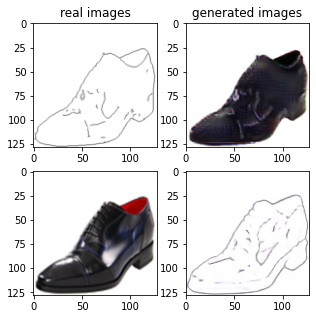

Train Epoch: 1 98% 	Total Loss: 1.290156 	Loss_G_AB: 0.283510	Loss_G_BA: 1.004141	Loss_cycle: 0.386057	Loss_D_A: 0.001728	Loss_D_B: 0.258545
0 49009 T:  1.6020174026489258
Train Epoch: 1 98% 	Total Loss: 1.274256 	Loss_G_AB: 0.261072	Loss_G_BA: 0.995113	Loss_cycle: 0.384322	Loss_D_A: 0.004222	Loss_D_B: 0.257620
0 49019 T:  0.8984582424163818
Train Epoch: 1 98% 	Total Loss: 1.340901 	Loss_G_AB: 0.294892	Loss_G_BA: 0.997673	Loss_cycle: 0.451629	Loss_D_A: 0.002427	Loss_D_B: 0.240562
0 49029 T:  0.9316651821136475
Train Epoch: 1 98% 	Total Loss: 1.428726 	Loss_G_AB: 0.296460	Loss_G_BA: 0.998103	Loss_cycle: 0.539610	Loss_D_A: 0.001981	Loss_D_B: 0.239854
0 49039 T:  1.013669490814209
Train Epoch: 1 98% 	Total Loss: 1.307934 	Loss_G_AB: 0.281823	Loss_G_BA: 1.014782	Loss_cycle: 0.378771	Loss_D_A: 0.006477	Loss_D_B: 0.274384
0 49049 T:  0.8809103965759277
Train Epoch: 1 98% 	Total Loss: 1.300563 	Loss_G_AB: 0.268575	Loss_G_BA: 0.993250	Loss_cycle: 0.382349	Loss_D_A: 0.002224	Loss_D_B: 0.285078


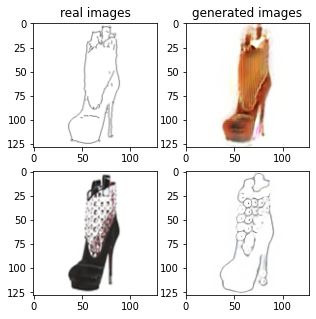

Train Epoch: 2 0% 	Total Loss: 1.230613 	Loss_G_AB: 0.269494	Loss_G_BA: 1.012684	Loss_cycle: 0.338781	Loss_D_A: 0.002418	Loss_D_B: 0.248324
1 50009 T:  1.4761004447937012
Train Epoch: 2 0% 	Total Loss: 1.132659 	Loss_G_AB: 0.299487	Loss_G_BA: 0.970939	Loss_cycle: 0.259742	Loss_D_A: 0.006055	Loss_D_B: 0.231649
1 50019 T:  0.9196426868438721
Train Epoch: 2 0% 	Total Loss: 1.329203 	Loss_G_AB: 0.256748	Loss_G_BA: 1.013771	Loss_cycle: 0.423111	Loss_D_A: 0.004267	Loss_D_B: 0.266566
1 50029 T:  0.9078061580657959
Train Epoch: 2 0% 	Total Loss: 1.292950 	Loss_G_AB: 0.292558	Loss_G_BA: 0.987491	Loss_cycle: 0.400875	Loss_D_A: 0.004052	Loss_D_B: 0.247999
1 50039 T:  0.9474127292633057
Train Epoch: 2 0% 	Total Loss: 1.282292 	Loss_G_AB: 0.297453	Loss_G_BA: 1.004446	Loss_cycle: 0.396214	Loss_D_A: 0.007186	Loss_D_B: 0.227941
1 50049 T:  0.9211690425872803
Train Epoch: 2 0% 	Total Loss: 1.347056 	Loss_G_AB: 0.353352	Loss_G_BA: 0.965370	Loss_cycle: 0.453036	Loss_D_A: 0.009595	Loss_D_B: 0.225064
1 500

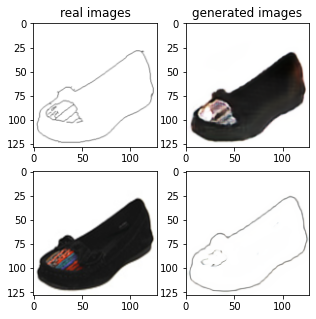

Train Epoch: 2 2% 	Total Loss: 1.194261 	Loss_G_AB: 0.276240	Loss_G_BA: 1.016632	Loss_cycle: 0.283442	Loss_D_A: 0.017504	Loss_D_B: 0.246878
1 51009 T:  1.5266690254211426
Train Epoch: 2 2% 	Total Loss: 1.332914 	Loss_G_AB: 0.298681	Loss_G_BA: 0.987609	Loss_cycle: 0.436726	Loss_D_A: 0.012028	Loss_D_B: 0.241015
1 51019 T:  0.8737101554870605
Train Epoch: 2 2% 	Total Loss: 1.353655 	Loss_G_AB: 0.305654	Loss_G_BA: 0.747403	Loss_cycle: 0.445906	Loss_D_A: 0.152311	Loss_D_B: 0.228910
1 51029 T:  0.9474167823791504
Train Epoch: 2 2% 	Total Loss: 1.392156 	Loss_G_AB: 0.290435	Loss_G_BA: 0.903294	Loss_cycle: 0.479180	Loss_D_A: 0.032885	Loss_D_B: 0.283226
1 51039 T:  0.934149980545044
Train Epoch: 2 2% 	Total Loss: 1.353358 	Loss_G_AB: 0.332865	Loss_G_BA: 0.923924	Loss_cycle: 0.460924	Loss_D_A: 0.031333	Loss_D_B: 0.232707
1 51049 T:  0.9748411178588867
Train Epoch: 2 2% 	Total Loss: 1.408777 	Loss_G_AB: 0.309246	Loss_G_BA: 1.066767	Loss_cycle: 0.484266	Loss_D_A: 0.017014	Loss_D_B: 0.219490
1 5105

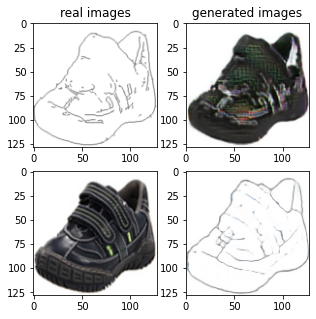

Train Epoch: 2 4% 	Total Loss: 1.240841 	Loss_G_AB: 0.285801	Loss_G_BA: 1.000876	Loss_cycle: 0.352523	Loss_D_A: 0.001686	Loss_D_B: 0.243294
1 52009 T:  1.5232479572296143
Train Epoch: 2 4% 	Total Loss: 1.273118 	Loss_G_AB: 0.311226	Loss_G_BA: 1.012086	Loss_cycle: 0.397541	Loss_D_A: 0.001856	Loss_D_B: 0.212065
1 52019 T:  0.9759018421173096
Train Epoch: 2 4% 	Total Loss: 1.177294 	Loss_G_AB: 0.274587	Loss_G_BA: 0.972477	Loss_cycle: 0.300978	Loss_D_A: 0.002226	Loss_D_B: 0.250558
1 52029 T:  0.865412712097168
Train Epoch: 2 4% 	Total Loss: 1.292217 	Loss_G_AB: 0.289034	Loss_G_BA: 1.008866	Loss_cycle: 0.376311	Loss_D_A: 0.007378	Loss_D_B: 0.259579
1 52039 T:  0.8706598281860352
Train Epoch: 2 4% 	Total Loss: 1.218521 	Loss_G_AB: 0.257027	Loss_G_BA: 1.006376	Loss_cycle: 0.306859	Loss_D_A: 0.003875	Loss_D_B: 0.276086
1 52049 T:  0.904470682144165
Train Epoch: 2 4% 	Total Loss: 1.203358 	Loss_G_AB: 0.292580	Loss_G_BA: 1.000412	Loss_cycle: 0.308694	Loss_D_A: 0.002361	Loss_D_B: 0.245807
1 52059

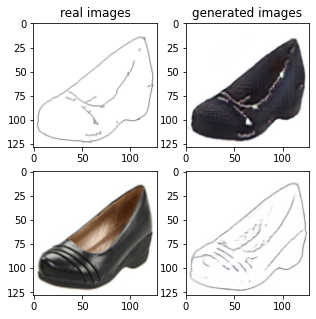

Train Epoch: 2 6% 	Total Loss: 1.190797 	Loss_G_AB: 0.275931	Loss_G_BA: 1.013514	Loss_cycle: 0.299803	Loss_D_A: 0.004380	Loss_D_B: 0.241892
1 53009 T:  1.5382463932037354
Train Epoch: 2 6% 	Total Loss: 1.340012 	Loss_G_AB: 0.316215	Loss_G_BA: 0.994486	Loss_cycle: 0.419477	Loss_D_A: 0.002439	Loss_D_B: 0.262744
1 53019 T:  0.9168179035186768
Train Epoch: 2 6% 	Total Loss: 1.242939 	Loss_G_AB: 0.280402	Loss_G_BA: 1.000935	Loss_cycle: 0.344749	Loss_D_A: 0.004652	Loss_D_B: 0.252868
1 53029 T:  0.8814253807067871
Train Epoch: 2 6% 	Total Loss: 1.283610 	Loss_G_AB: 0.279466	Loss_G_BA: 0.990307	Loss_cycle: 0.416826	Loss_D_A: 0.002656	Loss_D_B: 0.229242
1 53039 T:  0.9234840869903564
Train Epoch: 2 6% 	Total Loss: 1.203353 	Loss_G_AB: 0.280892	Loss_G_BA: 1.002160	Loss_cycle: 0.325189	Loss_D_A: 0.002502	Loss_D_B: 0.234137
1 53049 T:  0.9565749168395996
Train Epoch: 2 6% 	Total Loss: 1.305831 	Loss_G_AB: 0.267693	Loss_G_BA: 1.016109	Loss_cycle: 0.406509	Loss_D_A: 0.003707	Loss_D_B: 0.253714
1 530

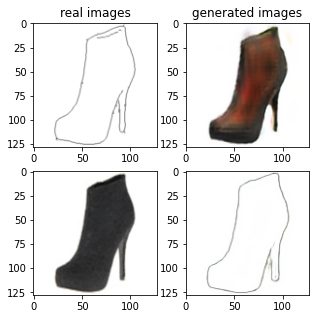

Train Epoch: 2 8% 	Total Loss: 1.268507 	Loss_G_AB: 0.257281	Loss_G_BA: 0.994198	Loss_cycle: 0.370786	Loss_D_A: 0.004209	Loss_D_B: 0.267772
1 54009 T:  1.5564544200897217
Train Epoch: 2 8% 	Total Loss: 1.223273 	Loss_G_AB: 0.401648	Loss_G_BA: 1.004288	Loss_cycle: 0.329259	Loss_D_A: 0.002886	Loss_D_B: 0.188160
1 54019 T:  0.866508960723877
Train Epoch: 2 8% 	Total Loss: 1.314731 	Loss_G_AB: 0.305924	Loss_G_BA: 0.986739	Loss_cycle: 0.407041	Loss_D_A: 0.002056	Loss_D_B: 0.259302
1 54029 T:  0.9001154899597168
Train Epoch: 2 8% 	Total Loss: 1.441525 	Loss_G_AB: 0.246604	Loss_G_BA: 1.008684	Loss_cycle: 0.524307	Loss_D_A: 0.001493	Loss_D_B: 0.288081
1 54039 T:  0.925574541091919
Train Epoch: 2 8% 	Total Loss: 1.335475 	Loss_G_AB: 0.319465	Loss_G_BA: 0.977855	Loss_cycle: 0.437439	Loss_D_A: 0.001816	Loss_D_B: 0.247560
1 54049 T:  0.9944159984588623
Train Epoch: 2 8% 	Total Loss: 1.319194 	Loss_G_AB: 0.289515	Loss_G_BA: 1.005850	Loss_cycle: 0.441605	Loss_D_A: 0.001504	Loss_D_B: 0.228402
1 54059

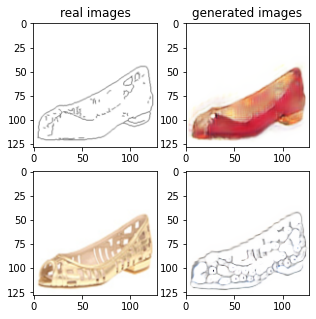

Train Epoch: 2 10% 	Total Loss: 1.293642 	Loss_G_AB: 0.328924	Loss_G_BA: 0.974322	Loss_cycle: 0.385216	Loss_D_A: 0.003094	Loss_D_B: 0.253709
1 55009 T:  1.5240318775177002
Train Epoch: 2 10% 	Total Loss: 1.263905 	Loss_G_AB: 0.296712	Loss_G_BA: 0.996518	Loss_cycle: 0.365568	Loss_D_A: 0.004967	Loss_D_B: 0.246755
1 55019 T:  0.9824841022491455
Train Epoch: 2 10% 	Total Loss: 1.290516 	Loss_G_AB: 0.281386	Loss_G_BA: 1.004068	Loss_cycle: 0.404654	Loss_D_A: 0.002213	Loss_D_B: 0.240922
1 55029 T:  0.9151418209075928
Train Epoch: 2 10% 	Total Loss: 1.285743 	Loss_G_AB: 0.309554	Loss_G_BA: 1.013180	Loss_cycle: 0.403722	Loss_D_A: 0.001898	Loss_D_B: 0.218755
1 55039 T:  0.8900163173675537
Train Epoch: 2 10% 	Total Loss: 1.390301 	Loss_G_AB: 0.310676	Loss_G_BA: 0.975388	Loss_cycle: 0.496831	Loss_D_A: 0.002855	Loss_D_B: 0.247584
1 55049 T:  0.8833489418029785
Train Epoch: 2 11% 	Total Loss: 1.235811 	Loss_G_AB: 0.359251	Loss_G_BA: 1.016199	Loss_cycle: 0.330312	Loss_D_A: 0.001910	Loss_D_B: 0.215864

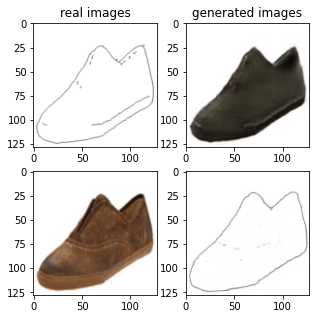

Train Epoch: 2 12% 	Total Loss: 1.218815 	Loss_G_AB: 0.285903	Loss_G_BA: 0.995536	Loss_cycle: 0.323860	Loss_D_A: 0.014878	Loss_D_B: 0.239359
1 56009 T:  1.521944522857666
Train Epoch: 2 12% 	Total Loss: 1.273551 	Loss_G_AB: 0.299782	Loss_G_BA: 0.918446	Loss_cycle: 0.416823	Loss_D_A: 0.010407	Loss_D_B: 0.237207
1 56019 T:  0.9022257328033447
Train Epoch: 2 12% 	Total Loss: 1.343668 	Loss_G_AB: 0.311989	Loss_G_BA: 1.004862	Loss_cycle: 0.453003	Loss_D_A: 0.005001	Loss_D_B: 0.227238
1 56029 T:  0.883014440536499
Train Epoch: 2 12% 	Total Loss: 1.404188 	Loss_G_AB: 0.298910	Loss_G_BA: 0.968911	Loss_cycle: 0.513444	Loss_D_A: 0.003293	Loss_D_B: 0.253540
1 56039 T:  0.8699033260345459
Train Epoch: 2 12% 	Total Loss: 1.381312 	Loss_G_AB: 0.267284	Loss_G_BA: 1.013911	Loss_cycle: 0.471904	Loss_D_A: 0.002504	Loss_D_B: 0.266307
1 56049 T:  0.8793833255767822
Train Epoch: 2 13% 	Total Loss: 1.300918 	Loss_G_AB: 0.378064	Loss_G_BA: 1.017555	Loss_cycle: 0.354196	Loss_D_A: 0.003578	Loss_D_B: 0.245334
1

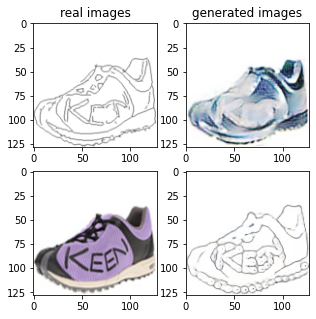

Train Epoch: 2 14% 	Total Loss: 1.362358 	Loss_G_AB: 0.316928	Loss_G_BA: 0.931478	Loss_cycle: 0.423805	Loss_D_A: 0.067872	Loss_D_B: 0.246478
1 57009 T:  1.5456693172454834
Train Epoch: 2 14% 	Total Loss: 1.237341 	Loss_G_AB: 0.261718	Loss_G_BA: 0.844643	Loss_cycle: 0.384772	Loss_D_A: 0.040870	Loss_D_B: 0.258518
1 57019 T:  0.8796727657318115
Train Epoch: 2 14% 	Total Loss: 1.366590 	Loss_G_AB: 0.263413	Loss_G_BA: 1.016153	Loss_cycle: 0.428823	Loss_D_A: 0.035744	Loss_D_B: 0.262240
1 57029 T:  0.8708808422088623
Train Epoch: 2 14% 	Total Loss: 1.292505 	Loss_G_AB: 0.308929	Loss_G_BA: 1.006886	Loss_cycle: 0.384427	Loss_D_A: 0.005489	Loss_D_B: 0.244680
1 57039 T:  0.861208438873291
Train Epoch: 2 14% 	Total Loss: 1.290267 	Loss_G_AB: 0.294123	Loss_G_BA: 0.983223	Loss_cycle: 0.405159	Loss_D_A: 0.004990	Loss_D_B: 0.241445
1 57049 T:  0.8748323917388916
Train Epoch: 2 15% 	Total Loss: 1.346673 	Loss_G_AB: 0.367919	Loss_G_BA: 1.002665	Loss_cycle: 0.463772	Loss_D_A: 0.004180	Loss_D_B: 0.193429


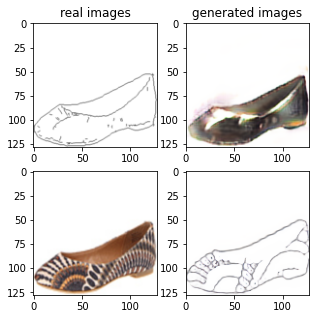

Train Epoch: 2 16% 	Total Loss: 1.315712 	Loss_G_AB: 0.316936	Loss_G_BA: 0.985645	Loss_cycle: 0.420026	Loss_D_A: 0.004190	Loss_D_B: 0.240206
1 58009 T:  1.4795818328857422
Train Epoch: 2 16% 	Total Loss: 1.284557 	Loss_G_AB: 0.313288	Loss_G_BA: 0.917649	Loss_cycle: 0.401943	Loss_D_A: 0.014395	Loss_D_B: 0.252751
1 58019 T:  0.8966951370239258
Train Epoch: 2 16% 	Total Loss: 1.287201 	Loss_G_AB: 0.287254	Loss_G_BA: 0.975850	Loss_cycle: 0.349328	Loss_D_A: 0.062380	Loss_D_B: 0.243941
1 58029 T:  0.890740156173706
Train Epoch: 2 16% 	Total Loss: 1.265331 	Loss_G_AB: 0.306081	Loss_G_BA: 0.984717	Loss_cycle: 0.344340	Loss_D_A: 0.017403	Loss_D_B: 0.258188
1 58039 T:  0.9930083751678467
Train Epoch: 2 17% 	Total Loss: 1.350614 	Loss_G_AB: 0.262145	Loss_G_BA: 0.994304	Loss_cycle: 0.449563	Loss_D_A: 0.015476	Loss_D_B: 0.257350
1 58049 T:  0.9258637428283691
Train Epoch: 2 17% 	Total Loss: 1.296939 	Loss_G_AB: 0.273928	Loss_G_BA: 1.007754	Loss_cycle: 0.396091	Loss_D_A: 0.007933	Loss_D_B: 0.252073


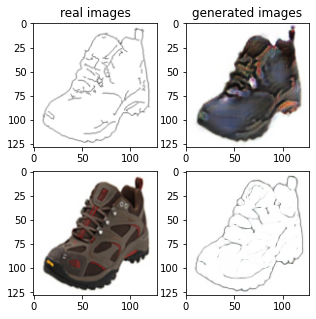

Train Epoch: 2 18% 	Total Loss: 1.279020 	Loss_G_AB: 0.274517	Loss_G_BA: 0.993149	Loss_cycle: 0.387687	Loss_D_A: 0.007396	Loss_D_B: 0.250104
1 59009 T:  1.5266878604888916
Train Epoch: 2 18% 	Total Loss: 1.291538 	Loss_G_AB: 0.271474	Loss_G_BA: 1.015689	Loss_cycle: 0.402689	Loss_D_A: 0.007638	Loss_D_B: 0.237629
1 59019 T:  0.8831582069396973
Train Epoch: 2 18% 	Total Loss: 1.213591 	Loss_G_AB: 0.322603	Loss_G_BA: 0.985626	Loss_cycle: 0.335799	Loss_D_A: 0.003965	Loss_D_B: 0.219714
1 59029 T:  0.9285376071929932
Train Epoch: 2 18% 	Total Loss: 1.304918 	Loss_G_AB: 0.288018	Loss_G_BA: 1.005671	Loss_cycle: 0.383770	Loss_D_A: 0.002028	Loss_D_B: 0.272275
1 59039 T:  0.9061264991760254
Train Epoch: 2 19% 	Total Loss: 1.278775 	Loss_G_AB: 0.317938	Loss_G_BA: 1.004483	Loss_cycle: 0.391317	Loss_D_A: 0.002482	Loss_D_B: 0.223765
1 59049 T:  0.88435959815979
Train Epoch: 2 19% 	Total Loss: 1.395615 	Loss_G_AB: 0.346837	Loss_G_BA: 0.978101	Loss_cycle: 0.495784	Loss_D_A: 0.002439	Loss_D_B: 0.234923
1

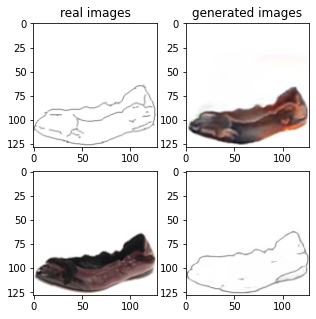

Train Epoch: 2 20% 	Total Loss: 1.231458 	Loss_G_AB: 0.317072	Loss_G_BA: 0.942795	Loss_cycle: 0.323927	Loss_D_A: 0.039412	Loss_D_B: 0.238186
1 60009 T:  1.5923964977264404
Train Epoch: 2 20% 	Total Loss: 1.192471 	Loss_G_AB: 0.351479	Loss_G_BA: 0.895786	Loss_cycle: 0.312300	Loss_D_A: 0.037651	Loss_D_B: 0.218888
1 60019 T:  0.9146661758422852
Train Epoch: 2 20% 	Total Loss: 1.206870 	Loss_G_AB: 0.316057	Loss_G_BA: 0.976284	Loss_cycle: 0.305953	Loss_D_A: 0.009502	Loss_D_B: 0.245245
1 60029 T:  0.9000844955444336
Train Epoch: 2 20% 	Total Loss: 1.200444 	Loss_G_AB: 0.322300	Loss_G_BA: 0.857787	Loss_cycle: 0.273768	Loss_D_A: 0.069096	Loss_D_B: 0.267537
1 60039 T:  0.9171826839447021
Train Epoch: 2 21% 	Total Loss: 1.456484 	Loss_G_AB: 0.395141	Loss_G_BA: 0.965270	Loss_cycle: 0.491853	Loss_D_A: 0.023930	Loss_D_B: 0.260495
1 60049 T:  0.9225356578826904
Train Epoch: 2 21% 	Total Loss: 1.456230 	Loss_G_AB: 0.363858	Loss_G_BA: 1.053229	Loss_cycle: 0.476002	Loss_D_A: 0.007455	Loss_D_B: 0.264230

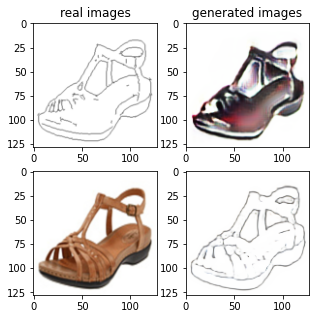

Train Epoch: 2 22% 	Total Loss: 1.310172 	Loss_G_AB: 0.259258	Loss_G_BA: 1.028837	Loss_cycle: 0.392257	Loss_D_A: 0.003543	Loss_D_B: 0.270325
1 61009 T:  1.5277175903320312
Train Epoch: 2 22% 	Total Loss: 1.371450 	Loss_G_AB: 0.296293	Loss_G_BA: 1.005808	Loss_cycle: 0.461802	Loss_D_A: 0.006194	Loss_D_B: 0.252404
1 61019 T:  0.9033734798431396
Train Epoch: 2 22% 	Total Loss: 1.201672 	Loss_G_AB: 0.303274	Loss_G_BA: 1.025089	Loss_cycle: 0.297916	Loss_D_A: 0.004938	Loss_D_B: 0.234637
1 61029 T:  0.891895055770874
Train Epoch: 2 23% 	Total Loss: 1.267883 	Loss_G_AB: 0.311048	Loss_G_BA: 0.980697	Loss_cycle: 0.376139	Loss_D_A: 0.002128	Loss_D_B: 0.243743
1 61039 T:  0.86051344871521
Train Epoch: 2 23% 	Total Loss: 1.269515 	Loss_G_AB: 0.303171	Loss_G_BA: 0.999159	Loss_cycle: 0.378555	Loss_D_A: 0.003997	Loss_D_B: 0.235798
1 61049 T:  0.8726651668548584
Train Epoch: 2 23% 	Total Loss: 1.327373 	Loss_G_AB: 0.313329	Loss_G_BA: 0.997407	Loss_cycle: 0.401588	Loss_D_A: 0.006075	Loss_D_B: 0.264342
1 

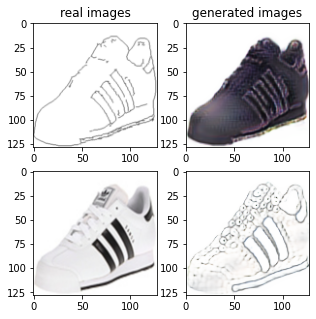

Train Epoch: 2 24% 	Total Loss: 1.401713 	Loss_G_AB: 0.382732	Loss_G_BA: 0.991400	Loss_cycle: 0.486889	Loss_D_A: 0.002873	Loss_D_B: 0.224884
1 62009 T:  1.4723577499389648
Train Epoch: 2 24% 	Total Loss: 1.182935 	Loss_G_AB: 0.284315	Loss_G_BA: 0.954732	Loss_cycle: 0.273623	Loss_D_A: 0.036468	Loss_D_B: 0.253321
1 62019 T:  0.906120777130127
Train Epoch: 2 24% 	Total Loss: 1.349656 	Loss_G_AB: 0.362931	Loss_G_BA: 0.971487	Loss_cycle: 0.455635	Loss_D_A: 0.005022	Loss_D_B: 0.221790
1 62029 T:  0.9648571014404297
Train Epoch: 2 25% 	Total Loss: 1.160248 	Loss_G_AB: 0.280840	Loss_G_BA: 1.011321	Loss_cycle: 0.257488	Loss_D_A: 0.002740	Loss_D_B: 0.253939
1 62039 T:  0.939408540725708
Train Epoch: 2 25% 	Total Loss: 1.260065 	Loss_G_AB: 0.273106	Loss_G_BA: 0.994548	Loss_cycle: 0.376724	Loss_D_A: 0.005305	Loss_D_B: 0.244208
1 62049 T:  0.8642675876617432
Train Epoch: 2 25% 	Total Loss: 1.291348 	Loss_G_AB: 0.381769	Loss_G_BA: 1.013603	Loss_cycle: 0.346748	Loss_D_A: 0.001818	Loss_D_B: 0.245095
1

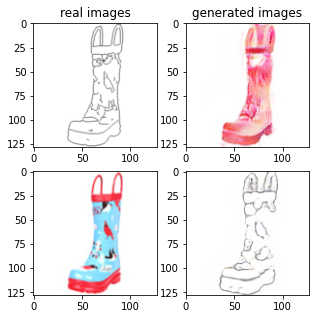

Train Epoch: 2 26% 	Total Loss: 1.267171 	Loss_G_AB: 0.281615	Loss_G_BA: 0.995829	Loss_cycle: 0.349156	Loss_D_A: 0.005496	Loss_D_B: 0.273797
1 63009 T:  1.543816089630127
Train Epoch: 2 26% 	Total Loss: 1.332757 	Loss_G_AB: 0.289546	Loss_G_BA: 0.989859	Loss_cycle: 0.416117	Loss_D_A: 0.009430	Loss_D_B: 0.267508
1 63019 T:  0.8880963325500488
Train Epoch: 2 27% 	Total Loss: 1.251387 	Loss_G_AB: 0.317981	Loss_G_BA: 0.990774	Loss_cycle: 0.336366	Loss_D_A: 0.005876	Loss_D_B: 0.254767
1 63029 T:  0.8699870109558105
Train Epoch: 2 27% 	Total Loss: 1.364284 	Loss_G_AB: 0.278223	Loss_G_BA: 1.006604	Loss_cycle: 0.464833	Loss_D_A: 0.003011	Loss_D_B: 0.254027
1 63039 T:  0.9449539184570312
Train Epoch: 2 27% 	Total Loss: 1.222014 	Loss_G_AB: 0.313739	Loss_G_BA: 1.007114	Loss_cycle: 0.328760	Loss_D_A: 0.004967	Loss_D_B: 0.227860
1 63049 T:  0.8861336708068848
Train Epoch: 2 27% 	Total Loss: 1.285467 	Loss_G_AB: 0.262693	Loss_G_BA: 1.007662	Loss_cycle: 0.371459	Loss_D_A: 0.003458	Loss_D_B: 0.275372


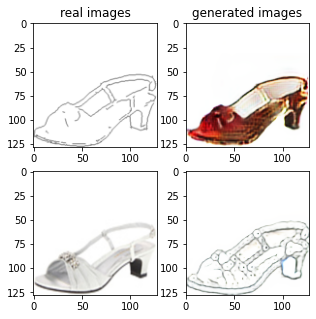

Train Epoch: 2 28% 	Total Loss: 1.304057 	Loss_G_AB: 0.371385	Loss_G_BA: 1.012596	Loss_cycle: 0.368403	Loss_D_A: 0.001751	Loss_D_B: 0.241913
1 64009 T:  1.496739387512207
Train Epoch: 2 28% 	Total Loss: 1.296454 	Loss_G_AB: 0.282490	Loss_G_BA: 0.991857	Loss_cycle: 0.383320	Loss_D_A: 0.003182	Loss_D_B: 0.272778
1 64019 T:  0.9514963626861572
Train Epoch: 2 29% 	Total Loss: 1.386865 	Loss_G_AB: 0.280534	Loss_G_BA: 0.990184	Loss_cycle: 0.462583	Loss_D_A: 0.003069	Loss_D_B: 0.285853
1 64029 T:  0.8842706680297852
Train Epoch: 2 29% 	Total Loss: 1.316991 	Loss_G_AB: 0.297163	Loss_G_BA: 0.987160	Loss_cycle: 0.435643	Loss_D_A: 0.002779	Loss_D_B: 0.236408
1 64039 T:  0.9067363739013672
Train Epoch: 2 29% 	Total Loss: 1.178876 	Loss_G_AB: 0.305682	Loss_G_BA: 1.015223	Loss_cycle: 0.282023	Loss_D_A: 0.004244	Loss_D_B: 0.232156
1 64049 T:  0.914874792098999
Train Epoch: 2 29% 	Total Loss: 1.207071 	Loss_G_AB: 0.296420	Loss_G_BA: 0.981601	Loss_cycle: 0.316954	Loss_D_A: 0.002988	Loss_D_B: 0.248120
1

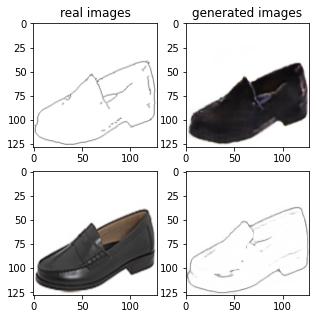

Train Epoch: 2 30% 	Total Loss: 1.237795 	Loss_G_AB: 0.287513	Loss_G_BA: 1.010539	Loss_cycle: 0.348248	Loss_D_A: 0.001737	Loss_D_B: 0.238783
1 65009 T:  1.4938702583312988
Train Epoch: 2 30% 	Total Loss: 1.185446 	Loss_G_AB: 0.269076	Loss_G_BA: 0.997198	Loss_cycle: 0.300697	Loss_D_A: 0.001727	Loss_D_B: 0.249884
1 65019 T:  0.9495048522949219
Train Epoch: 2 31% 	Total Loss: 1.200943 	Loss_G_AB: 0.319634	Loss_G_BA: 0.993527	Loss_cycle: 0.316866	Loss_D_A: 0.001392	Loss_D_B: 0.226105
1 65029 T:  0.9619042873382568
Train Epoch: 2 31% 	Total Loss: 1.297249 	Loss_G_AB: 0.317348	Loss_G_BA: 0.994795	Loss_cycle: 0.409699	Loss_D_A: 0.001838	Loss_D_B: 0.229640
1 65039 T:  0.9049079418182373
Train Epoch: 2 31% 	Total Loss: 1.157793 	Loss_G_AB: 0.324855	Loss_G_BA: 0.984527	Loss_cycle: 0.254181	Loss_D_A: 0.001513	Loss_D_B: 0.247409
1 65049 T:  0.9068031311035156
Train Epoch: 2 31% 	Total Loss: 1.259231 	Loss_G_AB: 0.296581	Loss_G_BA: 1.034996	Loss_cycle: 0.335322	Loss_D_A: 0.003493	Loss_D_B: 0.254627

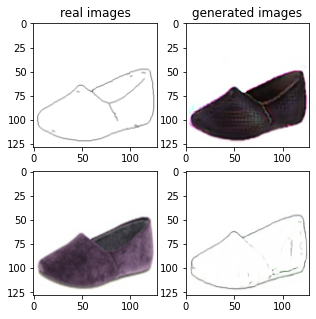

Train Epoch: 2 32% 	Total Loss: 1.263616 	Loss_G_AB: 0.255280	Loss_G_BA: 0.995527	Loss_cycle: 0.363807	Loss_D_A: 0.002248	Loss_D_B: 0.272158
1 66009 T:  1.5685820579528809
Train Epoch: 2 33% 	Total Loss: 1.282664 	Loss_G_AB: 0.290881	Loss_G_BA: 0.997703	Loss_cycle: 0.395998	Loss_D_A: 0.001992	Loss_D_B: 0.240381
1 66019 T:  0.9077174663543701
Train Epoch: 2 33% 	Total Loss: 1.302821 	Loss_G_AB: 0.382000	Loss_G_BA: 0.996863	Loss_cycle: 0.391592	Loss_D_A: 0.001814	Loss_D_B: 0.219984
1 66029 T:  0.878974437713623
Train Epoch: 2 33% 	Total Loss: 1.292132 	Loss_G_AB: 0.322163	Loss_G_BA: 1.009255	Loss_cycle: 0.407333	Loss_D_A: 0.001920	Loss_D_B: 0.217170
1 66039 T:  0.9536511898040771
Train Epoch: 2 33% 	Total Loss: 1.213594 	Loss_G_AB: 0.373636	Loss_G_BA: 1.000531	Loss_cycle: 0.290153	Loss_D_A: 0.006448	Loss_D_B: 0.229910
1 66049 T:  0.9202680587768555
Train Epoch: 2 33% 	Total Loss: 1.294641 	Loss_G_AB: 0.282319	Loss_G_BA: 0.999707	Loss_cycle: 0.397293	Loss_D_A: 0.001692	Loss_D_B: 0.254644


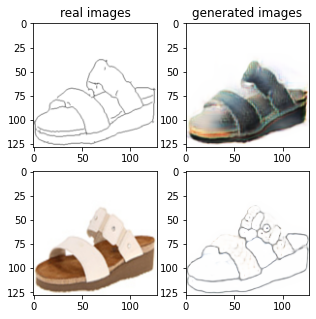

Train Epoch: 2 34% 	Total Loss: 1.198458 	Loss_G_AB: 0.303425	Loss_G_BA: 0.911679	Loss_cycle: 0.340843	Loss_D_A: 0.035652	Loss_D_B: 0.214412
1 67009 T:  1.7046809196472168
Train Epoch: 2 35% 	Total Loss: 1.397737 	Loss_G_AB: 0.310874	Loss_G_BA: 1.003325	Loss_cycle: 0.481524	Loss_D_A: 0.022765	Loss_D_B: 0.236348
1 67019 T:  0.9144511222839355
Train Epoch: 2 35% 	Total Loss: 1.261205 	Loss_G_AB: 0.346837	Loss_G_BA: 0.989784	Loss_cycle: 0.360855	Loss_D_A: 0.003812	Loss_D_B: 0.228228
1 67029 T:  0.9396216869354248
Train Epoch: 2 35% 	Total Loss: 1.405156 	Loss_G_AB: 0.306171	Loss_G_BA: 0.987777	Loss_cycle: 0.473336	Loss_D_A: 0.002706	Loss_D_B: 0.282139
1 67039 T:  0.891054630279541
Train Epoch: 2 35% 	Total Loss: 1.291546 	Loss_G_AB: 0.372151	Loss_G_BA: 1.000170	Loss_cycle: 0.337383	Loss_D_A: 0.005717	Loss_D_B: 0.262285
1 67049 T:  0.8677165508270264
Train Epoch: 2 35% 	Total Loss: 1.314462 	Loss_G_AB: 0.295758	Loss_G_BA: 0.981108	Loss_cycle: 0.380732	Loss_D_A: 0.023477	Loss_D_B: 0.271820


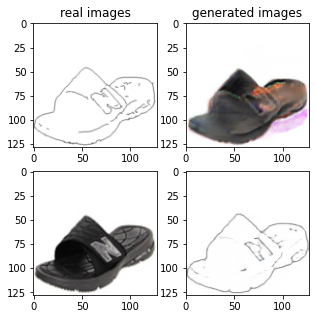

Train Epoch: 2 36% 	Total Loss: 1.232527 	Loss_G_AB: 0.277912	Loss_G_BA: 0.988004	Loss_cycle: 0.348579	Loss_D_A: 0.003109	Loss_D_B: 0.247880
1 68009 T:  1.5226316452026367
Train Epoch: 2 37% 	Total Loss: 1.266930 	Loss_G_AB: 0.317464	Loss_G_BA: 1.016357	Loss_cycle: 0.356868	Loss_D_A: 0.004502	Loss_D_B: 0.238650
1 68019 T:  0.93770432472229
Train Epoch: 2 37% 	Total Loss: 1.351440 	Loss_G_AB: 0.350383	Loss_G_BA: 0.991019	Loss_cycle: 0.467634	Loss_D_A: 0.001833	Loss_D_B: 0.211272
1 68029 T:  0.9062445163726807
Train Epoch: 2 37% 	Total Loss: 1.398402 	Loss_G_AB: 0.286511	Loss_G_BA: 0.976299	Loss_cycle: 0.505692	Loss_D_A: 0.002428	Loss_D_B: 0.258877
1 68039 T:  0.9147369861602783
Train Epoch: 2 37% 	Total Loss: 1.284649 	Loss_G_AB: 0.320654	Loss_G_BA: 1.014578	Loss_cycle: 0.377033	Loss_D_A: 0.005492	Loss_D_B: 0.234508
1 68049 T:  0.906804084777832
Train Epoch: 2 37% 	Total Loss: 1.267730 	Loss_G_AB: 0.247692	Loss_G_BA: 1.002011	Loss_cycle: 0.364061	Loss_D_A: 0.001847	Loss_D_B: 0.276971
1 

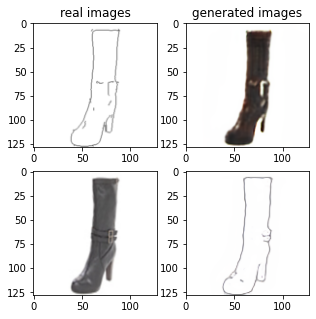

Train Epoch: 2 39% 	Total Loss: 1.264148 	Loss_G_AB: 0.358490	Loss_G_BA: 0.991468	Loss_cycle: 0.357449	Loss_D_A: 0.002550	Loss_D_B: 0.229171
1 69009 T:  1.5353119373321533
Train Epoch: 2 39% 	Total Loss: 1.157904 	Loss_G_AB: 0.279841	Loss_G_BA: 0.978152	Loss_cycle: 0.250347	Loss_D_A: 0.002588	Loss_D_B: 0.275973
1 69019 T:  0.9152767658233643
Train Epoch: 2 39% 	Total Loss: 1.321871 	Loss_G_AB: 0.301121	Loss_G_BA: 0.991863	Loss_cycle: 0.425543	Loss_D_A: 0.002968	Loss_D_B: 0.246868
1 69029 T:  0.9158401489257812
Train Epoch: 2 39% 	Total Loss: 1.254400 	Loss_G_AB: 0.273649	Loss_G_BA: 0.968694	Loss_cycle: 0.362905	Loss_D_A: 0.019073	Loss_D_B: 0.251251
1 69039 T:  0.9122664928436279
Train Epoch: 2 39% 	Total Loss: 1.305806 	Loss_G_AB: 0.292052	Loss_G_BA: 0.986297	Loss_cycle: 0.423363	Loss_D_A: 0.005974	Loss_D_B: 0.237294
1 69049 T:  0.8856172561645508
Train Epoch: 2 39% 	Total Loss: 1.295761 	Loss_G_AB: 0.287668	Loss_G_BA: 0.939379	Loss_cycle: 0.372084	Loss_D_A: 0.057553	Loss_D_B: 0.252600

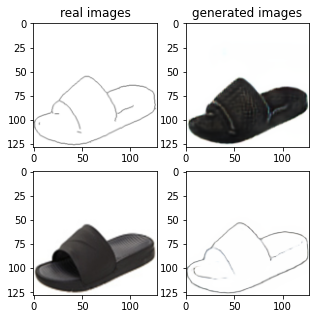

Train Epoch: 2 41% 	Total Loss: 1.165148 	Loss_G_AB: 0.308365	Loss_G_BA: 1.018150	Loss_cycle: 0.272053	Loss_D_A: 0.001764	Loss_D_B: 0.228073
1 70009 T:  1.581453561782837
Train Epoch: 2 41% 	Total Loss: 1.234591 	Loss_G_AB: 0.279291	Loss_G_BA: 0.994561	Loss_cycle: 0.343211	Loss_D_A: 0.001684	Loss_D_B: 0.252770
1 70019 T:  0.950932502746582
Train Epoch: 2 41% 	Total Loss: 1.302582 	Loss_G_AB: 0.300357	Loss_G_BA: 0.998652	Loss_cycle: 0.423963	Loss_D_A: 0.002266	Loss_D_B: 0.226848
1 70029 T:  0.9284141063690186
Train Epoch: 2 41% 	Total Loss: 1.242003 	Loss_G_AB: 0.305579	Loss_G_BA: 0.990542	Loss_cycle: 0.368300	Loss_D_A: 0.001938	Loss_D_B: 0.223705
1 70039 T:  0.9317796230316162
Train Epoch: 2 41% 	Total Loss: 1.180506 	Loss_G_AB: 0.298250	Loss_G_BA: 1.006713	Loss_cycle: 0.288699	Loss_D_A: 0.002266	Loss_D_B: 0.237059
1 70049 T:  1.0458190441131592
Train Epoch: 2 41% 	Total Loss: 1.242398 	Loss_G_AB: 0.420558	Loss_G_BA: 0.998457	Loss_cycle: 0.365777	Loss_D_A: 0.004798	Loss_D_B: 0.162315
1

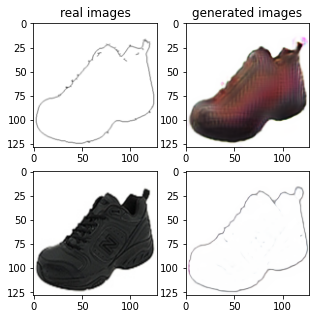

Train Epoch: 2 43% 	Total Loss: 1.237682 	Loss_G_AB: 0.306579	Loss_G_BA: 0.986209	Loss_cycle: 0.326547	Loss_D_A: 0.005723	Loss_D_B: 0.259019
1 71009 T:  1.5960347652435303
Train Epoch: 2 43% 	Total Loss: 1.212147 	Loss_G_AB: 0.335583	Loss_G_BA: 0.993649	Loss_cycle: 0.307165	Loss_D_A: 0.003618	Loss_D_B: 0.236747
1 71019 T:  0.9130885601043701
Train Epoch: 2 43% 	Total Loss: 1.324394 	Loss_G_AB: 0.369487	Loss_G_BA: 1.009296	Loss_cycle: 0.431562	Loss_D_A: 0.003419	Loss_D_B: 0.200021
1 71029 T:  0.923616886138916
Train Epoch: 2 43% 	Total Loss: 1.182875 	Loss_G_AB: 0.290736	Loss_G_BA: 0.991397	Loss_cycle: 0.295395	Loss_D_A: 0.003743	Loss_D_B: 0.242670
1 71039 T:  0.9326064586639404
Train Epoch: 2 43% 	Total Loss: 1.309411 	Loss_G_AB: 0.284286	Loss_G_BA: 0.972338	Loss_cycle: 0.423328	Loss_D_A: 0.006708	Loss_D_B: 0.251063
1 71049 T:  0.8926551342010498
Train Epoch: 2 43% 	Total Loss: 1.326534 	Loss_G_AB: 0.304583	Loss_G_BA: 1.024291	Loss_cycle: 0.366264	Loss_D_A: 0.003077	Loss_D_B: 0.292756


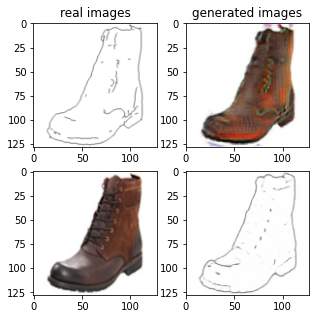

Train Epoch: 2 45% 	Total Loss: 1.279115 	Loss_G_AB: 0.367786	Loss_G_BA: 0.992894	Loss_cycle: 0.364541	Loss_D_A: 0.008286	Loss_D_B: 0.225948
1 72009 T:  1.6109509468078613
Train Epoch: 2 45% 	Total Loss: 1.168725 	Loss_G_AB: 0.314125	Loss_G_BA: 0.983786	Loss_cycle: 0.305917	Loss_D_A: 0.005076	Loss_D_B: 0.208777
1 72019 T:  0.9463348388671875
Train Epoch: 2 45% 	Total Loss: 1.148472 	Loss_G_AB: 0.304925	Loss_G_BA: 0.808709	Loss_cycle: 0.288395	Loss_D_A: 0.052849	Loss_D_B: 0.250412
1 72029 T:  0.8876936435699463
Train Epoch: 2 45% 	Total Loss: 1.257420 	Loss_G_AB: 0.282551	Loss_G_BA: 1.013893	Loss_cycle: 0.358842	Loss_D_A: 0.016456	Loss_D_B: 0.233899
1 72039 T:  0.8984813690185547
Train Epoch: 2 45% 	Total Loss: 1.301467 	Loss_G_AB: 0.270678	Loss_G_BA: 1.010625	Loss_cycle: 0.382984	Loss_D_A: 0.002831	Loss_D_B: 0.275000
1 72049 T:  0.9736316204071045
Train Epoch: 2 45% 	Total Loss: 1.309773 	Loss_G_AB: 0.264926	Loss_G_BA: 0.979640	Loss_cycle: 0.399204	Loss_D_A: 0.011089	Loss_D_B: 0.277197

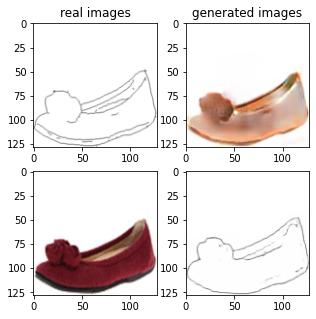

Train Epoch: 2 47% 	Total Loss: 1.351843 	Loss_G_AB: 0.287914	Loss_G_BA: 0.995280	Loss_cycle: 0.418674	Loss_D_A: 0.004054	Loss_D_B: 0.287519
1 73009 T:  1.7448742389678955
Train Epoch: 2 47% 	Total Loss: 1.423437 	Loss_G_AB: 0.323340	Loss_G_BA: 0.973563	Loss_cycle: 0.502611	Loss_D_A: 0.003596	Loss_D_B: 0.268779
1 73019 T:  0.9229068756103516
Train Epoch: 2 47% 	Total Loss: 1.176705 	Loss_G_AB: 0.286410	Loss_G_BA: 0.993570	Loss_cycle: 0.287013	Loss_D_A: 0.003591	Loss_D_B: 0.246112
1 73029 T:  0.9915037155151367
Train Epoch: 2 47% 	Total Loss: 1.277346 	Loss_G_AB: 0.326115	Loss_G_BA: 0.971791	Loss_cycle: 0.394635	Loss_D_A: 0.005362	Loss_D_B: 0.228396
1 73039 T:  0.9433367252349854
Train Epoch: 2 47% 	Total Loss: 1.173370 	Loss_G_AB: 0.286637	Loss_G_BA: 0.970769	Loss_cycle: 0.288076	Loss_D_A: 0.009394	Loss_D_B: 0.247197
1 73049 T:  0.9461495876312256
Train Epoch: 2 47% 	Total Loss: 1.253464 	Loss_G_AB: 0.268230	Loss_G_BA: 1.017531	Loss_cycle: 0.332955	Loss_D_A: 0.008930	Loss_D_B: 0.268698

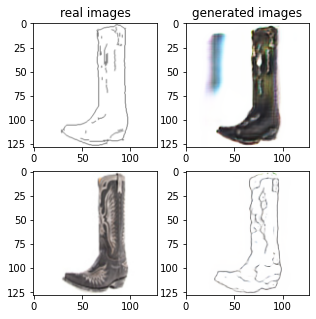

Train Epoch: 2 49% 	Total Loss: 1.274893 	Loss_G_AB: 0.280232	Loss_G_BA: 0.985488	Loss_cycle: 0.384854	Loss_D_A: 0.003691	Loss_D_B: 0.253488
1 74009 T:  1.516139030456543
Train Epoch: 2 49% 	Total Loss: 1.244859 	Loss_G_AB: 0.295952	Loss_G_BA: 1.009031	Loss_cycle: 0.350640	Loss_D_A: 0.002175	Loss_D_B: 0.239552
1 74019 T:  0.9239397048950195
Train Epoch: 2 49% 	Total Loss: 1.221468 	Loss_G_AB: 0.305211	Loss_G_BA: 0.984038	Loss_cycle: 0.340348	Loss_D_A: 0.001691	Loss_D_B: 0.234804
1 74029 T:  0.9414961338043213
Train Epoch: 2 49% 	Total Loss: 1.312311 	Loss_G_AB: 0.334804	Loss_G_BA: 1.005895	Loss_cycle: 0.420965	Loss_D_A: 0.004192	Loss_D_B: 0.216804
1 74039 T:  0.9297020435333252
Train Epoch: 2 49% 	Total Loss: 1.422463 	Loss_G_AB: 0.318621	Loss_G_BA: 1.018541	Loss_cycle: 0.477746	Loss_D_A: 0.002342	Loss_D_B: 0.273794
1 74049 T:  0.8965201377868652
Train Epoch: 2 49% 	Total Loss: 1.216731 	Loss_G_AB: 0.335308	Loss_G_BA: 0.994571	Loss_cycle: 0.318256	Loss_D_A: 0.001520	Loss_D_B: 0.232016


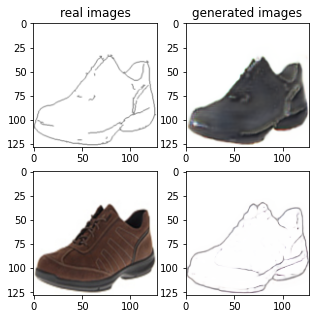

Train Epoch: 2 51% 	Total Loss: 1.228585 	Loss_G_AB: 0.303176	Loss_G_BA: 1.000209	Loss_cycle: 0.331441	Loss_D_A: 0.002864	Loss_D_B: 0.242588
1 75009 T:  1.6037213802337646
Train Epoch: 2 51% 	Total Loss: 1.274629 	Loss_G_AB: 0.325501	Loss_G_BA: 0.996971	Loss_cycle: 0.347808	Loss_D_A: 0.003492	Loss_D_B: 0.262093
1 75019 T:  0.9516808986663818
Train Epoch: 2 51% 	Total Loss: 1.290140 	Loss_G_AB: 0.310372	Loss_G_BA: 0.977484	Loss_cycle: 0.410483	Loss_D_A: 0.002402	Loss_D_B: 0.233327
1 75029 T:  0.9224588871002197
Train Epoch: 2 51% 	Total Loss: 1.299764 	Loss_G_AB: 0.325293	Loss_G_BA: 0.992313	Loss_cycle: 0.405250	Loss_D_A: 0.002917	Loss_D_B: 0.232794
1 75039 T:  0.9068756103515625
Train Epoch: 2 51% 	Total Loss: 1.268605 	Loss_G_AB: 0.394932	Loss_G_BA: 1.016496	Loss_cycle: 0.331836	Loss_D_A: 0.003940	Loss_D_B: 0.227116
1 75049 T:  0.9224941730499268
Train Epoch: 2 51% 	Total Loss: 1.180100 	Loss_G_AB: 0.295264	Loss_G_BA: 0.900147	Loss_cycle: 0.338958	Loss_D_A: 0.011308	Loss_D_B: 0.232129

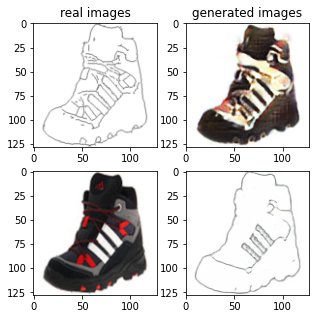

Train Epoch: 2 53% 	Total Loss: 1.169329 	Loss_G_AB: 0.302779	Loss_G_BA: 0.979961	Loss_cycle: 0.303393	Loss_D_A: 0.002595	Loss_D_B: 0.221971
1 76009 T:  1.5181231498718262
Train Epoch: 2 53% 	Total Loss: 1.353751 	Loss_G_AB: 0.309513	Loss_G_BA: 0.999247	Loss_cycle: 0.432796	Loss_D_A: 0.001506	Loss_D_B: 0.265068
1 76019 T:  0.9246976375579834
Train Epoch: 2 53% 	Total Loss: 1.227610 	Loss_G_AB: 0.328260	Loss_G_BA: 1.010921	Loss_cycle: 0.300052	Loss_D_A: 0.004154	Loss_D_B: 0.253814
1 76029 T:  0.9272396564483643
Train Epoch: 2 53% 	Total Loss: 1.406476 	Loss_G_AB: 0.303194	Loss_G_BA: 1.005784	Loss_cycle: 0.446084	Loss_D_A: 0.004344	Loss_D_B: 0.301559
1 76039 T:  0.8970739841461182
Train Epoch: 2 53% 	Total Loss: 1.281485 	Loss_G_AB: 0.348211	Loss_G_BA: 0.986283	Loss_cycle: 0.367785	Loss_D_A: 0.002842	Loss_D_B: 0.243610
1 76049 T:  0.8992657661437988
Train Epoch: 2 53% 	Total Loss: 1.307424 	Loss_G_AB: 0.306791	Loss_G_BA: 0.993286	Loss_cycle: 0.405576	Loss_D_A: 0.001600	Loss_D_B: 0.250209

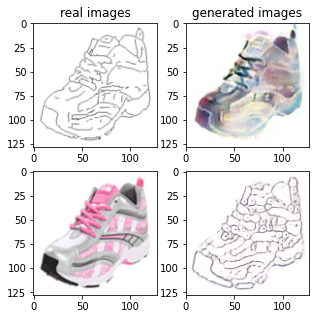

Train Epoch: 2 55% 	Total Loss: 1.362054 	Loss_G_AB: 0.275629	Loss_G_BA: 1.027087	Loss_cycle: 0.449126	Loss_D_A: 0.002800	Loss_D_B: 0.258770
1 77009 T:  1.585984468460083
Train Epoch: 2 55% 	Total Loss: 1.241778 	Loss_G_AB: 0.291649	Loss_G_BA: 1.001099	Loss_cycle: 0.354563	Loss_D_A: 0.001561	Loss_D_B: 0.239280
1 77019 T:  0.902850866317749
Train Epoch: 2 55% 	Total Loss: 1.332752 	Loss_G_AB: 0.325186	Loss_G_BA: 1.009594	Loss_cycle: 0.436740	Loss_D_A: 0.001713	Loss_D_B: 0.226909
1 77029 T:  0.8757178783416748
Train Epoch: 2 55% 	Total Loss: 1.221714 	Loss_G_AB: 0.275002	Loss_G_BA: 0.988598	Loss_cycle: 0.329414	Loss_D_A: 0.002033	Loss_D_B: 0.258467
1 77039 T:  0.943974494934082
Train Epoch: 2 55% 	Total Loss: 1.159082 	Loss_G_AB: 0.300816	Loss_G_BA: 1.019203	Loss_cycle: 0.260935	Loss_D_A: 0.002419	Loss_D_B: 0.235719
1 77049 T:  0.8995969295501709
Train Epoch: 2 55% 	Total Loss: 1.266178 	Loss_G_AB: 0.354184	Loss_G_BA: 0.978148	Loss_cycle: 0.352348	Loss_D_A: 0.002464	Loss_D_B: 0.245199
1 

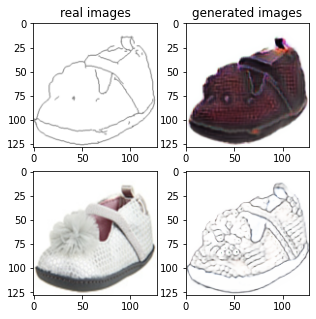

Train Epoch: 2 57% 	Total Loss: 1.235829 	Loss_G_AB: 0.281972	Loss_G_BA: 1.020663	Loss_cycle: 0.303971	Loss_D_A: 0.001949	Loss_D_B: 0.278591
1 78009 T:  1.5346481800079346
Train Epoch: 2 57% 	Total Loss: 1.201473 	Loss_G_AB: 0.295343	Loss_G_BA: 0.984063	Loss_cycle: 0.316445	Loss_D_A: 0.002061	Loss_D_B: 0.243264
1 78019 T:  0.9021890163421631
Train Epoch: 2 57% 	Total Loss: 1.174374 	Loss_G_AB: 0.301068	Loss_G_BA: 1.009253	Loss_cycle: 0.294882	Loss_D_A: 0.001512	Loss_D_B: 0.222820
1 78029 T:  0.9069511890411377
Train Epoch: 2 57% 	Total Loss: 1.256900 	Loss_G_AB: 0.319418	Loss_G_BA: 0.990672	Loss_cycle: 0.358728	Loss_D_A: 0.001271	Loss_D_B: 0.241856
1 78039 T:  0.893216609954834
Train Epoch: 2 57% 	Total Loss: 1.206743 	Loss_G_AB: 0.286518	Loss_G_BA: 1.004940	Loss_cycle: 0.304965	Loss_D_A: 0.001918	Loss_D_B: 0.254131
1 78049 T:  0.9103949069976807
Train Epoch: 2 57% 	Total Loss: 1.232924 	Loss_G_AB: 0.306801	Loss_G_BA: 1.005173	Loss_cycle: 0.341599	Loss_D_A: 0.001229	Loss_D_B: 0.234109


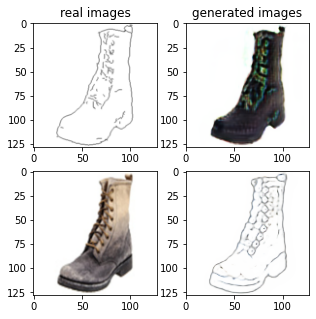

Train Epoch: 2 59% 	Total Loss: 1.234592 	Loss_G_AB: 0.315480	Loss_G_BA: 1.008646	Loss_cycle: 0.330002	Loss_D_A: 0.002134	Loss_D_B: 0.240393
1 79009 T:  1.5415241718292236
Train Epoch: 2 59% 	Total Loss: 1.182464 	Loss_G_AB: 0.290012	Loss_G_BA: 0.987482	Loss_cycle: 0.299876	Loss_D_A: 0.001419	Loss_D_B: 0.242422
1 79019 T:  1.014385461807251
Train Epoch: 2 59% 	Total Loss: 1.169398 	Loss_G_AB: 0.307599	Loss_G_BA: 1.004311	Loss_cycle: 0.285154	Loss_D_A: 0.001073	Loss_D_B: 0.227216
1 79029 T:  0.914412260055542
Train Epoch: 2 59% 	Total Loss: 1.193664 	Loss_G_AB: 0.233205	Loss_G_BA: 0.976566	Loss_cycle: 0.271630	Loss_D_A: 0.020347	Loss_D_B: 0.296802
1 79039 T:  0.9953687191009521
Train Epoch: 2 59% 	Total Loss: 1.231125 	Loss_G_AB: 0.336805	Loss_G_BA: 0.999744	Loss_cycle: 0.353999	Loss_D_A: 0.003054	Loss_D_B: 0.205798
1 79049 T:  0.928159236907959
Train Epoch: 2 59% 	Total Loss: 1.152274 	Loss_G_AB: 0.321064	Loss_G_BA: 1.003989	Loss_cycle: 0.271663	Loss_D_A: 0.002185	Loss_D_B: 0.215900
1 

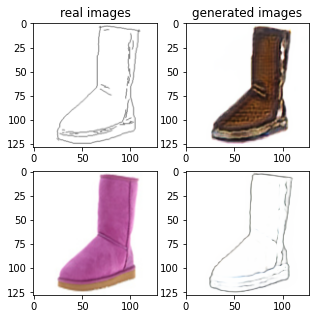

Train Epoch: 2 61% 	Total Loss: 1.280186 	Loss_G_AB: 0.293134	Loss_G_BA: 1.012767	Loss_cycle: 0.371660	Loss_D_A: 0.003855	Loss_D_B: 0.251720
1 80009 T:  1.7138583660125732
Train Epoch: 2 61% 	Total Loss: 1.215503 	Loss_G_AB: 0.332974	Loss_G_BA: 1.010361	Loss_cycle: 0.327917	Loss_D_A: 0.002275	Loss_D_B: 0.213643
1 80019 T:  0.9261155128479004
Train Epoch: 2 61% 	Total Loss: 1.218176 	Loss_G_AB: 0.324150	Loss_G_BA: 1.001903	Loss_cycle: 0.323433	Loss_D_A: 0.001302	Loss_D_B: 0.230414
1 80029 T:  0.9407942295074463
Train Epoch: 2 61% 	Total Loss: 1.209261 	Loss_G_AB: 0.295481	Loss_G_BA: 0.991914	Loss_cycle: 0.324740	Loss_D_A: 0.001660	Loss_D_B: 0.239163
1 80039 T:  0.9327390193939209
Train Epoch: 2 61% 	Total Loss: 1.192428 	Loss_G_AB: 0.288194	Loss_G_BA: 0.995847	Loss_cycle: 0.304835	Loss_D_A: 0.003626	Loss_D_B: 0.241946
1 80049 T:  0.936995267868042
Train Epoch: 2 61% 	Total Loss: 1.260476 	Loss_G_AB: 0.315975	Loss_G_BA: 0.985205	Loss_cycle: 0.373181	Loss_D_A: 0.013640	Loss_D_B: 0.223064


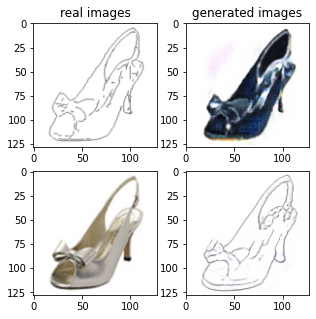

Train Epoch: 2 63% 	Total Loss: 1.296273 	Loss_G_AB: 0.334367	Loss_G_BA: 0.995215	Loss_cycle: 0.361682	Loss_D_A: 0.001819	Loss_D_B: 0.267981
1 81009 T:  1.6131470203399658
Train Epoch: 2 63% 	Total Loss: 1.165786 	Loss_G_AB: 0.298648	Loss_G_BA: 0.991552	Loss_cycle: 0.270902	Loss_D_A: 0.008273	Loss_D_B: 0.241510
1 81019 T:  0.9008255004882812
Train Epoch: 2 63% 	Total Loss: 1.146977 	Loss_G_AB: 0.265036	Loss_G_BA: 0.995205	Loss_cycle: 0.252881	Loss_D_A: 0.002777	Loss_D_B: 0.261200
1 81029 T:  0.9770808219909668
Train Epoch: 2 63% 	Total Loss: 1.238563 	Loss_G_AB: 0.286749	Loss_G_BA: 1.012629	Loss_cycle: 0.349020	Loss_D_A: 0.001865	Loss_D_B: 0.237989
1 81039 T:  0.9101657867431641
Train Epoch: 2 63% 	Total Loss: 1.220965 	Loss_G_AB: 0.263526	Loss_G_BA: 1.001293	Loss_cycle: 0.339333	Loss_D_A: 0.002050	Loss_D_B: 0.247172
1 81049 T:  0.9527726173400879
Train Epoch: 2 63% 	Total Loss: 1.166636 	Loss_G_AB: 0.309345	Loss_G_BA: 0.994988	Loss_cycle: 0.277821	Loss_D_A: 0.001186	Loss_D_B: 0.235462

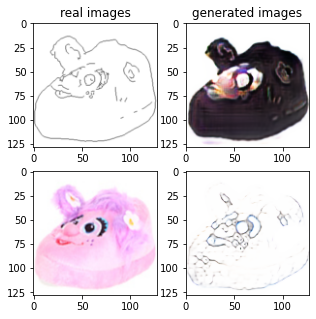

Train Epoch: 2 65% 	Total Loss: 1.363224 	Loss_G_AB: 0.320264	Loss_G_BA: 1.034668	Loss_cycle: 0.406187	Loss_D_A: 0.006949	Loss_D_B: 0.272622
1 82009 T:  1.5961060523986816
Train Epoch: 2 65% 	Total Loss: 1.269691 	Loss_G_AB: 0.268079	Loss_G_BA: 0.983830	Loss_cycle: 0.378141	Loss_D_A: 0.005311	Loss_D_B: 0.260286
1 82019 T:  0.8741953372955322
Train Epoch: 2 65% 	Total Loss: 1.175691 	Loss_G_AB: 0.287513	Loss_G_BA: 0.989765	Loss_cycle: 0.296822	Loss_D_A: 0.002037	Loss_D_B: 0.238193
1 82029 T:  0.8870112895965576
Train Epoch: 2 65% 	Total Loss: 1.276283 	Loss_G_AB: 0.317037	Loss_G_BA: 0.995097	Loss_cycle: 0.350169	Loss_D_A: 0.002601	Loss_D_B: 0.267446
1 82039 T:  0.8767063617706299
Train Epoch: 2 65% 	Total Loss: 1.249069 	Loss_G_AB: 0.283032	Loss_G_BA: 1.003193	Loss_cycle: 0.361336	Loss_D_A: 0.004275	Loss_D_B: 0.240345
1 82049 T:  0.9309046268463135
Train Epoch: 2 65% 	Total Loss: 1.254519 	Loss_G_AB: 0.318135	Loss_G_BA: 0.985915	Loss_cycle: 0.337186	Loss_D_A: 0.003354	Loss_D_B: 0.261954

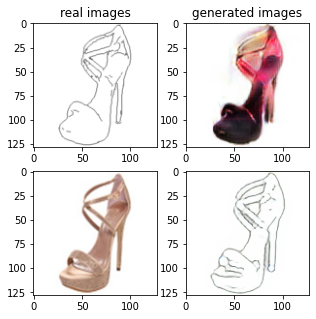

Train Epoch: 2 67% 	Total Loss: 1.212977 	Loss_G_AB: 0.339681	Loss_G_BA: 1.007732	Loss_cycle: 0.308902	Loss_D_A: 0.001106	Loss_D_B: 0.229263
1 83009 T:  1.6332004070281982
Train Epoch: 2 67% 	Total Loss: 1.105907 	Loss_G_AB: 0.267482	Loss_G_BA: 0.984313	Loss_cycle: 0.224430	Loss_D_A: 0.001284	Loss_D_B: 0.254296
1 83019 T:  0.9879922866821289
Train Epoch: 2 67% 	Total Loss: 1.210947 	Loss_G_AB: 0.313305	Loss_G_BA: 1.016322	Loss_cycle: 0.306230	Loss_D_A: 0.001221	Loss_D_B: 0.238683
1 83029 T:  0.901681661605835
Train Epoch: 2 67% 	Total Loss: 1.321723 	Loss_G_AB: 0.354745	Loss_G_BA: 0.990593	Loss_cycle: 0.421805	Loss_D_A: 0.001095	Loss_D_B: 0.226153
1 83039 T:  1.0267555713653564
Train Epoch: 2 67% 	Total Loss: 1.356855 	Loss_G_AB: 0.384554	Loss_G_BA: 0.999977	Loss_cycle: 0.416759	Loss_D_A: 0.000954	Loss_D_B: 0.246877
1 83049 T:  0.9500160217285156
Train Epoch: 2 67% 	Total Loss: 1.237475 	Loss_G_AB: 0.298700	Loss_G_BA: 0.994589	Loss_cycle: 0.334845	Loss_D_A: 0.001335	Loss_D_B: 0.254650


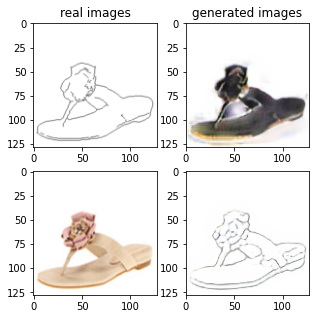

Train Epoch: 2 69% 	Total Loss: 1.267642 	Loss_G_AB: 0.277886	Loss_G_BA: 0.893603	Loss_cycle: 0.363460	Loss_D_A: 0.045658	Loss_D_B: 0.272780
1 84009 T:  1.479661226272583
Train Epoch: 2 69% 	Total Loss: 1.373854 	Loss_G_AB: 0.344761	Loss_G_BA: 1.026508	Loss_cycle: 0.436966	Loss_D_A: 0.008580	Loss_D_B: 0.242673
1 84019 T:  0.9977767467498779
Train Epoch: 2 69% 	Total Loss: 1.179699 	Loss_G_AB: 0.302897	Loss_G_BA: 0.988871	Loss_cycle: 0.286051	Loss_D_A: 0.013131	Loss_D_B: 0.234633
1 84029 T:  0.956810474395752
Train Epoch: 2 69% 	Total Loss: 1.301829 	Loss_G_AB: 0.326078	Loss_G_BA: 0.806494	Loss_cycle: 0.444770	Loss_D_A: 0.054379	Loss_D_B: 0.236394
1 84039 T:  0.8790445327758789
Train Epoch: 2 69% 	Total Loss: 1.349495 	Loss_G_AB: 0.306608	Loss_G_BA: 0.960774	Loss_cycle: 0.427154	Loss_D_A: 0.028101	Loss_D_B: 0.260550
1 84049 T:  0.8955256938934326
Train Epoch: 2 69% 	Total Loss: 1.316962 	Loss_G_AB: 0.307525	Loss_G_BA: 1.013471	Loss_cycle: 0.435078	Loss_D_A: 0.008675	Loss_D_B: 0.212711
1

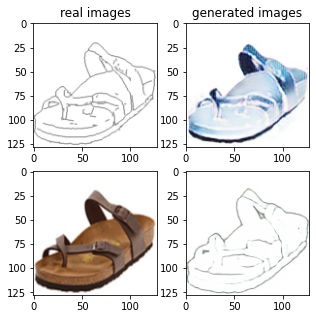

Train Epoch: 2 71% 	Total Loss: 1.232255 	Loss_G_AB: 0.257762	Loss_G_BA: 1.008288	Loss_cycle: 0.327916	Loss_D_A: 0.001418	Loss_D_B: 0.269896
1 85009 T:  1.5156536102294922
Train Epoch: 2 71% 	Total Loss: 1.417225 	Loss_G_AB: 0.363373	Loss_G_BA: 1.007299	Loss_cycle: 0.473305	Loss_D_A: 0.001328	Loss_D_B: 0.257256
1 85019 T:  0.916895866394043
Train Epoch: 2 71% 	Total Loss: 1.220569 	Loss_G_AB: 0.285760	Loss_G_BA: 0.995131	Loss_cycle: 0.329274	Loss_D_A: 0.001539	Loss_D_B: 0.249311
1 85029 T:  0.9474146366119385
Train Epoch: 2 71% 	Total Loss: 1.193606 	Loss_G_AB: 0.331779	Loss_G_BA: 0.997021	Loss_cycle: 0.306661	Loss_D_A: 0.001151	Loss_D_B: 0.221394
1 85039 T:  0.8952522277832031
Train Epoch: 2 71% 	Total Loss: 1.209095 	Loss_G_AB: 0.331648	Loss_G_BA: 1.000067	Loss_cycle: 0.311689	Loss_D_A: 0.001129	Loss_D_B: 0.230420
1 85049 T:  0.923851490020752
Train Epoch: 2 71% 	Total Loss: 1.124334 	Loss_G_AB: 0.272810	Loss_G_BA: 0.994597	Loss_cycle: 0.237593	Loss_D_A: 0.001226	Loss_D_B: 0.251812
1

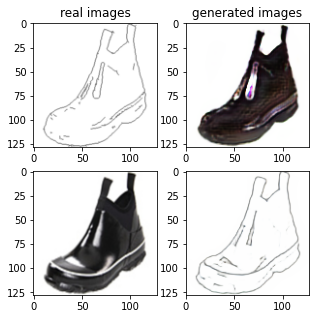

Train Epoch: 2 73% 	Total Loss: 1.197787 	Loss_G_AB: 0.311514	Loss_G_BA: 0.984851	Loss_cycle: 0.321125	Loss_D_A: 0.001479	Loss_D_B: 0.227000
1 86009 T:  1.6165714263916016
Train Epoch: 2 73% 	Total Loss: 1.283848 	Loss_G_AB: 0.266326	Loss_G_BA: 0.991644	Loss_cycle: 0.392091	Loss_D_A: 0.001707	Loss_D_B: 0.261065
1 86019 T:  0.903362512588501
Train Epoch: 2 73% 	Total Loss: 1.263782 	Loss_G_AB: 0.355820	Loss_G_BA: 0.989589	Loss_cycle: 0.380751	Loss_D_A: 0.001163	Loss_D_B: 0.209164
1 86029 T:  0.9266788959503174
Train Epoch: 2 73% 	Total Loss: 1.243380 	Loss_G_AB: 0.290024	Loss_G_BA: 1.000157	Loss_cycle: 0.337207	Loss_D_A: 0.002334	Loss_D_B: 0.258749
1 86039 T:  0.8688809871673584
Train Epoch: 2 73% 	Total Loss: 1.268051 	Loss_G_AB: 0.302731	Loss_G_BA: 0.967545	Loss_cycle: 0.341020	Loss_D_A: 0.019964	Loss_D_B: 0.271929
1 86049 T:  0.8803501129150391
Train Epoch: 2 73% 	Total Loss: 1.198905 	Loss_G_AB: 0.277392	Loss_G_BA: 0.981812	Loss_cycle: 0.325875	Loss_D_A: 0.007469	Loss_D_B: 0.235960


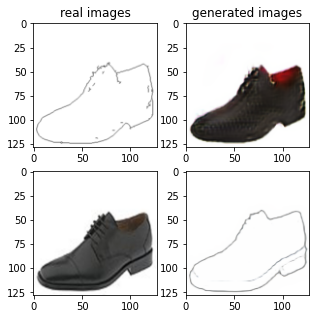

Train Epoch: 2 75% 	Total Loss: 1.151873 	Loss_G_AB: 0.293559	Loss_G_BA: 0.993243	Loss_cycle: 0.270537	Loss_D_A: 0.001804	Loss_D_B: 0.236131
1 87009 T:  1.5413246154785156
Train Epoch: 2 75% 	Total Loss: 1.209001 	Loss_G_AB: 0.282486	Loss_G_BA: 0.951021	Loss_cycle: 0.346095	Loss_D_A: 0.004203	Loss_D_B: 0.241951
1 87019 T:  0.8738007545471191
Train Epoch: 2 75% 	Total Loss: 1.242372 	Loss_G_AB: 0.329185	Loss_G_BA: 1.032801	Loss_cycle: 0.347368	Loss_D_A: 0.005491	Loss_D_B: 0.208520
1 87029 T:  0.9117670059204102
Train Epoch: 2 75% 	Total Loss: 1.316962 	Loss_G_AB: 0.285243	Loss_G_BA: 1.016001	Loss_cycle: 0.386815	Loss_D_A: 0.001139	Loss_D_B: 0.278386
1 87039 T:  0.8802444934844971
Train Epoch: 2 75% 	Total Loss: 1.246214 	Loss_G_AB: 0.268111	Loss_G_BA: 1.003441	Loss_cycle: 0.357391	Loss_D_A: 0.001065	Loss_D_B: 0.251982
1 87049 T:  0.8777644634246826
Train Epoch: 2 75% 	Total Loss: 1.324901 	Loss_G_AB: 0.280053	Loss_G_BA: 1.005636	Loss_cycle: 0.418228	Loss_D_A: 0.001084	Loss_D_B: 0.262744

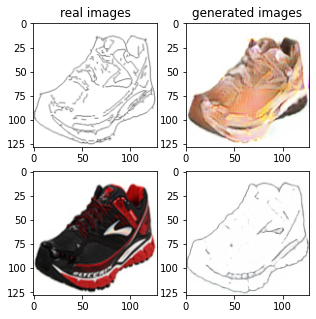

Train Epoch: 2 77% 	Total Loss: 1.299049 	Loss_G_AB: 0.405673	Loss_G_BA: 1.002135	Loss_cycle: 0.390332	Loss_D_A: 0.005325	Loss_D_B: 0.199487
1 88009 T:  1.4964241981506348
Train Epoch: 2 77% 	Total Loss: 1.337462 	Loss_G_AB: 0.354262	Loss_G_BA: 0.990887	Loss_cycle: 0.399251	Loss_D_A: 0.002942	Loss_D_B: 0.262694
1 88019 T:  0.9007523059844971
Train Epoch: 2 77% 	Total Loss: 1.327759 	Loss_G_AB: 0.350184	Loss_G_BA: 1.000239	Loss_cycle: 0.388276	Loss_D_A: 0.002219	Loss_D_B: 0.262052
1 88029 T:  0.9548158645629883
Train Epoch: 2 77% 	Total Loss: 1.227866 	Loss_G_AB: 0.358462	Loss_G_BA: 0.998600	Loss_cycle: 0.304357	Loss_D_A: 0.001685	Loss_D_B: 0.243293
1 88039 T:  0.8994076251983643
Train Epoch: 2 77% 	Total Loss: 1.237572 	Loss_G_AB: 0.291566	Loss_G_BA: 0.986601	Loss_cycle: 0.342382	Loss_D_A: 0.003422	Loss_D_B: 0.252684
1 88049 T:  0.903174877166748
Train Epoch: 2 77% 	Total Loss: 1.227920 	Loss_G_AB: 0.300145	Loss_G_BA: 1.025322	Loss_cycle: 0.326650	Loss_D_A: 0.003110	Loss_D_B: 0.235426


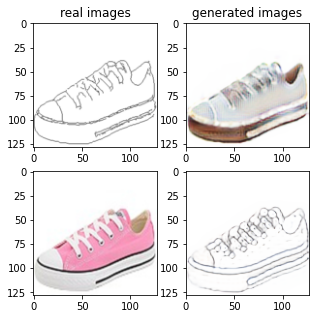

Train Epoch: 2 79% 	Total Loss: 1.219926 	Loss_G_AB: 0.257841	Loss_G_BA: 1.000674	Loss_cycle: 0.304919	Loss_D_A: 0.001442	Loss_D_B: 0.284308
1 89009 T:  1.4838721752166748
Train Epoch: 2 79% 	Total Loss: 1.259150 	Loss_G_AB: 0.277826	Loss_G_BA: 0.999304	Loss_cycle: 0.373573	Loss_D_A: 0.001045	Loss_D_B: 0.245966
1 89019 T:  0.8498055934906006
Train Epoch: 2 79% 	Total Loss: 1.202740 	Loss_G_AB: 0.331096	Loss_G_BA: 0.995400	Loss_cycle: 0.329136	Loss_D_A: 0.001203	Loss_D_B: 0.209153
1 89029 T:  0.8591129779815674
Train Epoch: 2 79% 	Total Loss: 1.213629 	Loss_G_AB: 0.291092	Loss_G_BA: 0.987406	Loss_cycle: 0.316080	Loss_D_A: 0.003996	Loss_D_B: 0.254305
1 89039 T:  0.8761272430419922
Train Epoch: 2 79% 	Total Loss: 1.156548 	Loss_G_AB: 0.287285	Loss_G_BA: 1.004948	Loss_cycle: 0.231336	Loss_D_A: 0.002424	Loss_D_B: 0.276671
1 89049 T:  0.8947665691375732
Train Epoch: 2 79% 	Total Loss: 1.249494 	Loss_G_AB: 0.255750	Loss_G_BA: 0.981512	Loss_cycle: 0.354072	Loss_D_A: 0.005405	Loss_D_B: 0.271386

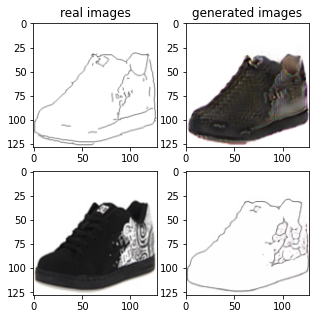

Train Epoch: 2 81% 	Total Loss: 1.251881 	Loss_G_AB: 0.300610	Loss_G_BA: 1.001361	Loss_cycle: 0.343521	Loss_D_A: 0.001802	Loss_D_B: 0.255572
1 90009 T:  1.4432504177093506
Train Epoch: 2 81% 	Total Loss: 1.361057 	Loss_G_AB: 0.365888	Loss_G_BA: 0.996024	Loss_cycle: 0.455295	Loss_D_A: 0.002394	Loss_D_B: 0.222412
1 90019 T:  0.9352414608001709
Train Epoch: 2 81% 	Total Loss: 1.427894 	Loss_G_AB: 0.409041	Loss_G_BA: 1.000577	Loss_cycle: 0.392051	Loss_D_A: 0.001476	Loss_D_B: 0.329558
1 90029 T:  0.9559488296508789
Train Epoch: 2 81% 	Total Loss: 1.159834 	Loss_G_AB: 0.289931	Loss_G_BA: 0.985952	Loss_cycle: 0.263450	Loss_D_A: 0.002627	Loss_D_B: 0.255816
1 90039 T:  0.8831710815429688
Train Epoch: 2 81% 	Total Loss: 1.172041 	Loss_G_AB: 0.283056	Loss_G_BA: 0.966216	Loss_cycle: 0.299821	Loss_D_A: 0.003131	Loss_D_B: 0.244452
1 90049 T:  0.8803138732910156
Train Epoch: 2 81% 	Total Loss: 1.202492 	Loss_G_AB: 0.289575	Loss_G_BA: 1.005795	Loss_cycle: 0.294669	Loss_D_A: 0.012772	Loss_D_B: 0.247366

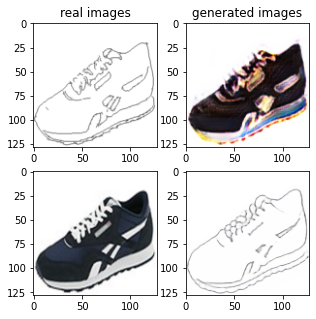

Train Epoch: 2 83% 	Total Loss: 1.184801 	Loss_G_AB: 0.314699	Loss_G_BA: 0.999297	Loss_cycle: 0.293804	Loss_D_A: 0.001431	Loss_D_B: 0.232567
1 91009 T:  1.53135347366333
Train Epoch: 2 83% 	Total Loss: 1.181674 	Loss_G_AB: 0.307494	Loss_G_BA: 0.992908	Loss_cycle: 0.281399	Loss_D_A: 0.001130	Loss_D_B: 0.248944
1 91019 T:  0.9406418800354004
Train Epoch: 2 83% 	Total Loss: 1.201326 	Loss_G_AB: 0.299000	Loss_G_BA: 1.005268	Loss_cycle: 0.306275	Loss_D_A: 0.004222	Loss_D_B: 0.238695
1 91029 T:  0.8299829959869385
Train Epoch: 2 83% 	Total Loss: 1.116019 	Loss_G_AB: 0.330400	Loss_G_BA: 1.002937	Loss_cycle: 0.239766	Loss_D_A: 0.001177	Loss_D_B: 0.208408
1 91039 T:  0.8517742156982422
Train Epoch: 2 83% 	Total Loss: 1.249349 	Loss_G_AB: 0.327806	Loss_G_BA: 1.003587	Loss_cycle: 0.329623	Loss_D_A: 0.001523	Loss_D_B: 0.252506
1 91049 T:  0.866605281829834
Train Epoch: 2 83% 	Total Loss: 1.220343 	Loss_G_AB: 0.332909	Loss_G_BA: 1.000277	Loss_cycle: 0.329281	Loss_D_A: 0.002344	Loss_D_B: 0.222125
1 

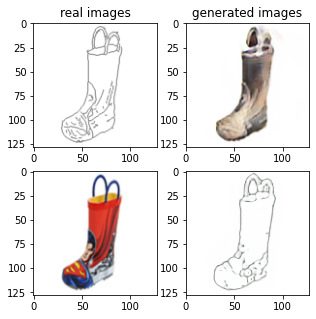

Train Epoch: 2 85% 	Total Loss: 1.250572 	Loss_G_AB: 0.295978	Loss_G_BA: 0.990586	Loss_cycle: 0.376915	Loss_D_A: 0.003834	Loss_D_B: 0.226541
1 92009 T:  1.4443981647491455
Train Epoch: 2 85% 	Total Loss: 1.236035 	Loss_G_AB: 0.356976	Loss_G_BA: 0.947928	Loss_cycle: 0.325932	Loss_D_A: 0.010575	Loss_D_B: 0.247076
1 92019 T:  0.844031572341919
Train Epoch: 2 85% 	Total Loss: 1.239329 	Loss_G_AB: 0.312858	Loss_G_BA: 1.018581	Loss_cycle: 0.344077	Loss_D_A: 0.011706	Loss_D_B: 0.217826
1 92029 T:  0.8511803150177002
Train Epoch: 2 85% 	Total Loss: 1.355869 	Loss_G_AB: 0.348106	Loss_G_BA: 0.997939	Loss_cycle: 0.396499	Loss_D_A: 0.002526	Loss_D_B: 0.283821
1 92039 T:  0.8521304130554199
Train Epoch: 2 85% 	Total Loss: 1.168146 	Loss_G_AB: 0.301341	Loss_G_BA: 1.008769	Loss_cycle: 0.283407	Loss_D_A: 0.001525	Loss_D_B: 0.228158
1 92049 T:  0.8626418113708496
Train Epoch: 2 85% 	Total Loss: 1.227619 	Loss_G_AB: 0.305564	Loss_G_BA: 1.010437	Loss_cycle: 0.337278	Loss_D_A: 0.001434	Loss_D_B: 0.230907


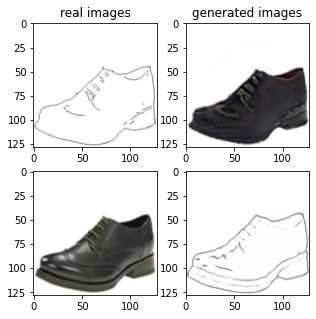

Train Epoch: 2 87% 	Total Loss: 1.179700 	Loss_G_AB: 0.295630	Loss_G_BA: 1.000343	Loss_cycle: 0.277836	Loss_D_A: 0.001477	Loss_D_B: 0.252401
1 93009 T:  1.562330961227417
Train Epoch: 2 87% 	Total Loss: 1.170074 	Loss_G_AB: 0.282087	Loss_G_BA: 0.976947	Loss_cycle: 0.287087	Loss_D_A: 0.008118	Loss_D_B: 0.245352
1 93019 T:  0.9386513233184814
Train Epoch: 2 87% 	Total Loss: 1.246595 	Loss_G_AB: 0.362858	Loss_G_BA: 0.993592	Loss_cycle: 0.287647	Loss_D_A: 0.002577	Loss_D_B: 0.278145
1 93029 T:  0.9116294384002686
Train Epoch: 2 87% 	Total Loss: 1.261147 	Loss_G_AB: 0.301753	Loss_G_BA: 1.007879	Loss_cycle: 0.342498	Loss_D_A: 0.002118	Loss_D_B: 0.261716
1 93039 T:  0.9125688076019287
Train Epoch: 2 87% 	Total Loss: 1.194161 	Loss_G_AB: 0.278833	Loss_G_BA: 0.988238	Loss_cycle: 0.316568	Loss_D_A: 0.001770	Loss_D_B: 0.242288
1 93049 T:  0.8800046443939209
Train Epoch: 2 87% 	Total Loss: 1.252308 	Loss_G_AB: 0.305899	Loss_G_BA: 1.002870	Loss_cycle: 0.367992	Loss_D_A: 0.001574	Loss_D_B: 0.228358


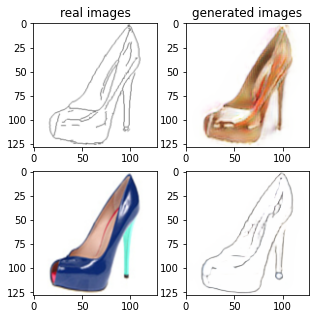

Train Epoch: 2 89% 	Total Loss: 1.377355 	Loss_G_AB: 0.347219	Loss_G_BA: 0.847511	Loss_cycle: 0.403687	Loss_D_A: 0.161871	Loss_D_B: 0.214431
1 94009 T:  1.4662418365478516
Train Epoch: 2 89% 	Total Loss: 1.241663 	Loss_G_AB: 0.285209	Loss_G_BA: 1.010653	Loss_cycle: 0.306194	Loss_D_A: 0.017105	Loss_D_B: 0.270433
1 94019 T:  0.8915817737579346
Train Epoch: 2 89% 	Total Loss: 1.136798 	Loss_G_AB: 0.272845	Loss_G_BA: 0.985552	Loss_cycle: 0.242660	Loss_D_A: 0.008173	Loss_D_B: 0.256767
1 94029 T:  0.8324005603790283
Train Epoch: 2 89% 	Total Loss: 1.249736 	Loss_G_AB: 0.334437	Loss_G_BA: 0.940436	Loss_cycle: 0.313551	Loss_D_A: 0.025510	Loss_D_B: 0.273239
1 94039 T:  0.8158290386199951
Train Epoch: 2 89% 	Total Loss: 1.188952 	Loss_G_AB: 0.339300	Loss_G_BA: 0.984460	Loss_cycle: 0.319097	Loss_D_A: 0.011146	Loss_D_B: 0.196829
1 94049 T:  0.9226253032684326
Train Epoch: 2 89% 	Total Loss: 1.215077 	Loss_G_AB: 0.315622	Loss_G_BA: 0.981828	Loss_cycle: 0.324403	Loss_D_A: 0.013109	Loss_D_B: 0.228840

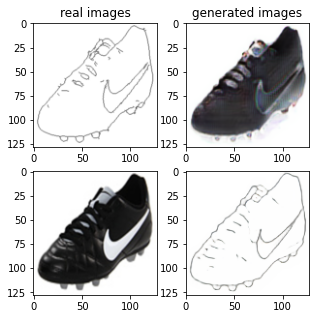

Train Epoch: 2 91% 	Total Loss: 1.200145 	Loss_G_AB: 0.266717	Loss_G_BA: 1.004713	Loss_cycle: 0.306239	Loss_D_A: 0.001458	Loss_D_B: 0.256734
1 95009 T:  1.4492690563201904
Train Epoch: 2 91% 	Total Loss: 1.193340 	Loss_G_AB: 0.364402	Loss_G_BA: 1.005641	Loss_cycle: 0.314787	Loss_D_A: 0.001473	Loss_D_B: 0.192059
1 95019 T:  0.8166847229003906
Train Epoch: 2 91% 	Total Loss: 1.132982 	Loss_G_AB: 0.300414	Loss_G_BA: 0.984840	Loss_cycle: 0.274691	Loss_D_A: 0.001252	Loss_D_B: 0.214412
1 95029 T:  0.8187642097473145
Train Epoch: 2 91% 	Total Loss: 1.242260 	Loss_G_AB: 0.334303	Loss_G_BA: 1.000432	Loss_cycle: 0.315077	Loss_D_A: 0.004836	Loss_D_B: 0.254980
1 95039 T:  0.8368759155273438
Train Epoch: 2 91% 	Total Loss: 1.208403 	Loss_G_AB: 0.369276	Loss_G_BA: 0.993618	Loss_cycle: 0.321759	Loss_D_A: 0.001917	Loss_D_B: 0.203280
1 95049 T:  0.9549849033355713
Train Epoch: 2 91% 	Total Loss: 1.190439 	Loss_G_AB: 0.310719	Loss_G_BA: 1.011026	Loss_cycle: 0.281907	Loss_D_A: 0.001566	Loss_D_B: 0.246094

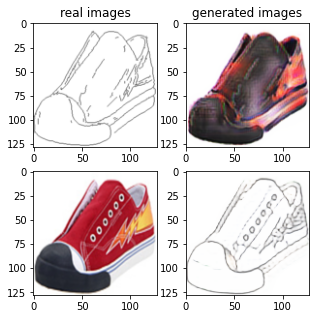

Train Epoch: 2 93% 	Total Loss: 1.227287 	Loss_G_AB: 0.250595	Loss_G_BA: 0.988875	Loss_cycle: 0.323351	Loss_D_A: 0.002221	Loss_D_B: 0.281979
1 96009 T:  1.4217264652252197
Train Epoch: 2 93% 	Total Loss: 1.108891 	Loss_G_AB: 0.309480	Loss_G_BA: 1.004626	Loss_cycle: 0.227019	Loss_D_A: 0.001425	Loss_D_B: 0.223393
1 96019 T:  0.8617103099822998
Train Epoch: 2 93% 	Total Loss: 1.188894 	Loss_G_AB: 0.269793	Loss_G_BA: 1.004491	Loss_cycle: 0.285899	Loss_D_A: 0.001658	Loss_D_B: 0.264195
1 96029 T:  0.9219152927398682
Train Epoch: 2 93% 	Total Loss: 1.225392 	Loss_G_AB: 0.286997	Loss_G_BA: 0.994767	Loss_cycle: 0.340232	Loss_D_A: 0.002009	Loss_D_B: 0.242270
1 96039 T:  0.86098313331604
Train Epoch: 2 93% 	Total Loss: 1.292687 	Loss_G_AB: 0.321394	Loss_G_BA: 0.998361	Loss_cycle: 0.385243	Loss_D_A: 0.002155	Loss_D_B: 0.245412
1 96049 T:  0.8410556316375732
Train Epoch: 2 93% 	Total Loss: 1.201708 	Loss_G_AB: 0.312954	Loss_G_BA: 0.999269	Loss_cycle: 0.299031	Loss_D_A: 0.002643	Loss_D_B: 0.243922
1

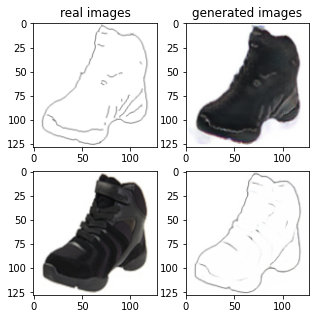

Train Epoch: 2 95% 	Total Loss: 1.220356 	Loss_G_AB: 0.274581	Loss_G_BA: 0.999419	Loss_cycle: 0.323769	Loss_D_A: 0.002371	Loss_D_B: 0.257215
1 97009 T:  1.4589431285858154
Train Epoch: 2 95% 	Total Loss: 1.234104 	Loss_G_AB: 0.302613	Loss_G_BA: 0.995981	Loss_cycle: 0.331344	Loss_D_A: 0.001725	Loss_D_B: 0.251739
1 97019 T:  0.8804624080657959
Train Epoch: 2 95% 	Total Loss: 1.203157 	Loss_G_AB: 0.332977	Loss_G_BA: 0.999704	Loss_cycle: 0.303476	Loss_D_A: 0.002020	Loss_D_B: 0.231320
1 97029 T:  0.8639512062072754
Train Epoch: 2 95% 	Total Loss: 1.212151 	Loss_G_AB: 0.338889	Loss_G_BA: 1.003732	Loss_cycle: 0.315308	Loss_D_A: 0.001935	Loss_D_B: 0.223599
1 97039 T:  0.893430233001709
Train Epoch: 2 95% 	Total Loss: 1.241686 	Loss_G_AB: 0.278533	Loss_G_BA: 1.000474	Loss_cycle: 0.347348	Loss_D_A: 0.001543	Loss_D_B: 0.253292
1 97049 T:  0.901238203048706
Train Epoch: 2 95% 	Total Loss: 1.252810 	Loss_G_AB: 0.289475	Loss_G_BA: 0.993316	Loss_cycle: 0.357891	Loss_D_A: 0.002373	Loss_D_B: 0.251151
1

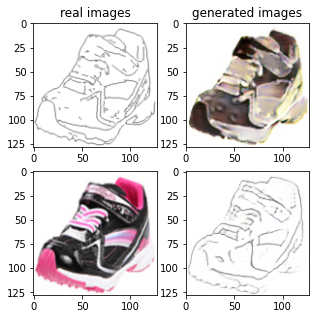

Train Epoch: 2 97% 	Total Loss: 1.357464 	Loss_G_AB: 0.288915	Loss_G_BA: 0.976256	Loss_cycle: 0.450333	Loss_D_A: 0.003718	Loss_D_B: 0.270827
1 98009 T:  1.4734318256378174
Train Epoch: 2 97% 	Total Loss: 1.261927 	Loss_G_AB: 0.296506	Loss_G_BA: 1.015961	Loss_cycle: 0.374402	Loss_D_A: 0.004711	Loss_D_B: 0.226582
1 98019 T:  0.9499847888946533
Train Epoch: 2 97% 	Total Loss: 1.273087 	Loss_G_AB: 0.279255	Loss_G_BA: 1.010464	Loss_cycle: 0.355351	Loss_D_A: 0.001863	Loss_D_B: 0.271013
1 98029 T:  0.8884282112121582
Train Epoch: 2 97% 	Total Loss: 1.210708 	Loss_G_AB: 0.273601	Loss_G_BA: 0.994159	Loss_cycle: 0.343060	Loss_D_A: 0.001679	Loss_D_B: 0.232089
1 98039 T:  0.8691308498382568
Train Epoch: 2 97% 	Total Loss: 1.360995 	Loss_G_AB: 0.345839	Loss_G_BA: 0.987759	Loss_cycle: 0.465233	Loss_D_A: 0.002052	Loss_D_B: 0.226911
1 98049 T:  0.8518226146697998
Train Epoch: 2 97% 	Total Loss: 1.179786 	Loss_G_AB: 0.268255	Loss_G_BA: 1.002996	Loss_cycle: 0.291583	Loss_D_A: 0.001611	Loss_D_B: 0.250967

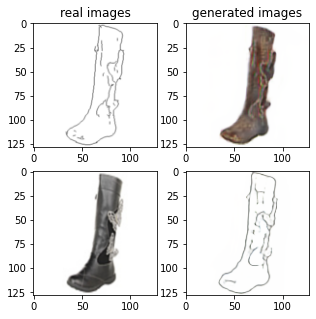

Train Epoch: 2 99% 	Total Loss: 1.188657 	Loss_G_AB: 0.333972	Loss_G_BA: 0.858288	Loss_cycle: 0.314843	Loss_D_A: 0.038153	Loss_D_B: 0.239531
1 99009 T:  1.731672763824463
Train Epoch: 2 99% 	Total Loss: 1.307611 	Loss_G_AB: 0.367127	Loss_G_BA: 1.015679	Loss_cycle: 0.397900	Loss_D_A: 0.010763	Loss_D_B: 0.207545
1 99019 T:  0.9839918613433838
Train Epoch: 2 99% 	Total Loss: 1.210878 	Loss_G_AB: 0.259894	Loss_G_BA: 0.869055	Loss_cycle: 0.245771	Loss_D_A: 0.145653	Loss_D_B: 0.254980
1 99029 T:  0.8973574638366699
Train Epoch: 2 99% 	Total Loss: 1.159183 	Loss_G_AB: 0.348179	Loss_G_BA: 0.802540	Loss_cycle: 0.280789	Loss_D_A: 0.084711	Loss_D_B: 0.218323
1 99039 T:  0.8691372871398926
Train Epoch: 2 99% 	Total Loss: 1.227123 	Loss_G_AB: 0.325059	Loss_G_BA: 0.866769	Loss_cycle: 0.352109	Loss_D_A: 0.040986	Loss_D_B: 0.238113
1 99049 T:  0.8695821762084961
Train Epoch: 2 99% 	Total Loss: 1.348083 	Loss_G_AB: 0.296883	Loss_G_BA: 0.894836	Loss_cycle: 0.393600	Loss_D_A: 0.095853	Loss_D_B: 0.262770


In [ ]:
import warnings
warnings.filterwarnings("ignore")
from torch.autograd import Variable
from torch.utils import data
from torch.utils.data import DataLoader, TensorDataset
from torch import nn, optim
from datasets import *
from models import *
import argparse, os
import itertools
import torch
import time
import pdb
import matplotlib.pyplot as plt


# Training Configurations
# (You may put your needed configuration here. Please feel free to add more or use argparse. )
train_img_dir = './edges2shoes/train/'
img_shape = (3, 128, 128)
n_residual_blocks = 6
num_epochs = 2
batch_size = 1
lr_rate = 0.0002      # Adam optimizer learning rate
betas = (0.5, 0.999)  # Adam optimizer beta 1, beta 2
lambda_cyc = 10.0 	  # cycle loss weight
latent_dim = 8        # latent dimension for the encoded images from domain B
report_feq = 10        # Visualize image every 'report_feq' iters
visual_feq = 1000
save_feq = 1000      # Save models every 'save_feq' iters

# Random seeds (optional)
torch.manual_seed(1); np.random.seed(1)

# set device
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

# Normalize image tensor
def norm(image):
    return (image/255.0-0.5)*2.0

# Denormalize image tensor
def denorm(tensor):
    return ((tensor+1.0)/2.0)*255.0

train_dataset = Edge2Shoe(train_img_dir)
train_loader = data.DataLoader(train_dataset, batch_size=batch_size)
print('the length of training data:', len(train_dataset))
# Losses
criterion_GAN = torch.nn.MSELoss()
criterion_cycle = torch.nn.L1Loss()

cuda = torch.cuda.is_available()

input_shape = img_shape

# Initialize generator and discriminator
G_AB = GeneratorResNet(input_shape, n_residual_blocks)
G_BA = GeneratorResNet(input_shape, n_residual_blocks)
D_A = Discriminator(input_shape)
D_B = Discriminator(input_shape)


if cuda:
    G_AB = G_AB.to(device)
    G_BA = G_BA.to(device)
    D_A = D_A.to(device)
    D_B = D_B.to(device)
    criterion_GAN.to(device)
    criterion_cycle.to(device)

# Initialize weights
G_AB.apply(weights_init_normal)
G_BA.apply(weights_init_normal)
D_A.apply(weights_init_normal)
D_B.apply(weights_init_normal)



# Define optimizer
optimizer_G = torch.optim.Adam(itertools.chain(G_AB.parameters(), G_BA.parameters()), lr=lr_rate, betas=betas)
optimizer_D_A = torch.optim.Adam(D_A.parameters(), lr=lr_rate, betas=betas)
optimizer_D_B = torch.optim.Adam(D_B.parameters(), lr=lr_rate, betas=betas)

# For adversarial loss
Tensor = torch.cuda.FloatTensor if cuda else torch.Tensor

# loss recorder
running_loss_D_A = 0
running_loss_D_B = 0
running_loss_GAN_AB = 0
running_loss_GAN_BA = 0
running_loss_cycle = 0
running_total_loss = 0

loss_D_A_list = []
loss_D_B_list = []
loss_GAN_AB_list = []
loss_GAN_BA_list = []
loss_cycle_list = []
total_loss_list = []
steps_list = []

# Training
total_steps = len(train_loader)*num_epochs; step = 0
for e in range(num_epochs):
    start = time.time()
    for idx, data in enumerate(train_loader):
        ########## Process Inputs ##########
        edge_tensor, rgb_tensor = data
        edge_tensor, rgb_tensor = norm(edge_tensor).to(device), norm(rgb_tensor).to(device)
        real_A = edge_tensor; real_B = rgb_tensor;

        # Adversarial ground truths
        valid = Variable(Tensor(np.ones((real_A.size(0), *D_A.output_shape))), requires_grad=False)
        fake = Variable(Tensor(np.zeros((real_A.size(0), *D_A.output_shape))), requires_grad=False)

        # ------------------
        #  Train Generators
        # ------------------
        G_AB.train(); G_BA.train()
        optimizer_G.zero_grad()

        # Generator loss
        loss_GAN_AB, fake_B = loss_generator(G_AB, real_A, D_B, valid, criterion_GAN)
        loss_GAN_BA, fake_A = loss_generator(G_BA, real_B, D_A, valid, criterion_GAN)
        loss_GAN = (loss_GAN_AB + loss_GAN_BA) / 2

        # Cycle loss
        loss_cycle_A = loss_cycle_consis(G_BA, fake_B, real_A, criterion_cycle)
        loss_cycle_B = loss_cycle_consis(G_AB, fake_A, real_B, criterion_cycle)
        loss_cycle = (loss_cycle_A + loss_cycle_B) / 2

        # Total loss
        loss_G = loss_GAN + lambda_cyc * loss_cycle

        loss_G.backward()
        optimizer_G.step()


        # -----------------------
        #  Train Discriminator A
        # -----------------------

        optimizer_D_A.zero_grad()

        # function to compute loss_D_A
        fake_A_ = fake_A.detach()
        loss_D_A = loss_discriminator(fake_A_, D_A, real_A, valid, fake, criterion_GAN)
        loss_D_A = loss_D_A / 2
        # update the D_A network
        loss_D_A.backward(retain_graph=True)
        optimizer_D_A.step()


        # -----------------------
        #  Train Discriminator B
        # -----------------------
        optimizer_D_B.zero_grad()

        # function to compute loss_D_A
        fake_B_ = fake_B.detach()
        loss_D_B = loss_discriminator(fake_B_, D_B, real_B, valid, fake, criterion_GAN)
        loss_D_B = loss_D_B / 2
        # update the D_B network
        loss_D_B.backward()
        optimizer_D_B.step()


        



        running_total_loss += (loss_GAN + lambda_cyc * loss_cycle + loss_D_A + loss_D_B).item()

        running_loss_GAN_AB += loss_GAN_AB.item()
        running_loss_GAN_BA += loss_GAN_BA.item()
        running_loss_D_A += loss_D_A.item()
        running_loss_D_B += loss_D_B.item()
        running_loss_cycle += lambda_cyc * loss_cycle.item()
        ########## Visualization ##########
        if step % report_feq == report_feq-1:
            print('Train Epoch: {} {:.0f}% \tTotal Loss: {:.6f} \tLoss_G_AB: {:.6f}\tLoss_G_BA: {:.6f}\tLoss_cycle: {:.6f}\tLoss_D_A: {:.6f}\tLoss_D_B: {:.6f}'.format
                    (e+1, 100. * idx / len(train_loader), running_total_loss / report_feq, 
                    running_loss_GAN_AB/report_feq, running_loss_GAN_BA/report_feq, 
                    running_loss_cycle/report_feq, running_loss_D_A/report_feq, 
                    running_loss_D_B/report_feq))
            
            loss_D_A_list.append(running_loss_D_A/report_feq)
            loss_D_B_list.append(running_loss_D_B/report_feq)
            loss_GAN_AB_list.append(running_loss_GAN_AB/report_feq)
            loss_GAN_BA_list.append(running_loss_GAN_BA/report_feq)
            loss_cycle_list.append(running_loss_cycle/report_feq)
            total_loss_list.append(running_total_loss / report_feq)
            steps_list.append(step)
            running_loss_D_A = 0
            running_loss_D_B = 0
            running_loss_GAN_AB = 0
            running_loss_GAN_BA = 0
            running_loss_cycle = 0
            running_total_loss = 0
            end = time.time()
            print(e, step, 'T: ', end-start)
            start = end
        ########## Visualize Generated images ##########
        if step % visual_feq == 0:
            vis_fake_A = denorm(fake_A[0].detach()).cpu().data.numpy().astype(np.uint8)
            vis_fake_B = denorm(fake_B[0].detach()).cpu().data.numpy().astype(np.uint8)
            vis_real_B = denorm(real_B[0].detach()).cpu().data.numpy().astype(np.uint8)
            vis_real_A = denorm(real_A[0].detach()).cpu().data.numpy().astype(np.uint8)
            fig, axs = plt.subplots(2,2, figsize = (5,5))	
            
            axs[0,0].imshow(vis_real_A.transpose(1,2,0))
            axs[0,0].set_title('real images')
            axs[0,1].imshow(vis_fake_B.transpose(1,2,0))
            axs[0,1].set_title('generated images')
            axs[1,0].imshow(vis_real_B.transpose(1,2,0))
            axs[1,1].imshow(vis_fake_A.transpose(1,2,0))
            plt.show()
        ########## Save Generators ##########
        if step % save_feq == save_feq-1:
            if not os.path.exists('models'): os.mkdir('models')
            torch.save(G_AB, '/content/models/G_AB.pt')
            torch.save(G_BA, '/content/models/G_BA.pt')
            # feel free to save checkpoint if you need retrain the model...

        step += 1

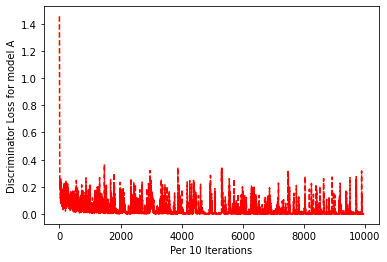

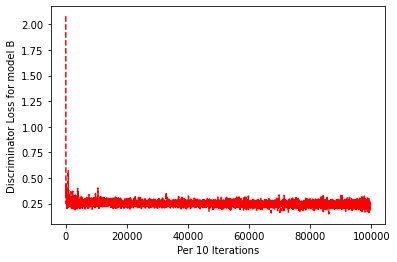

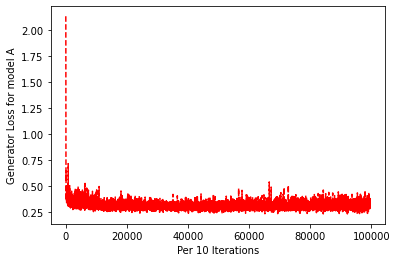

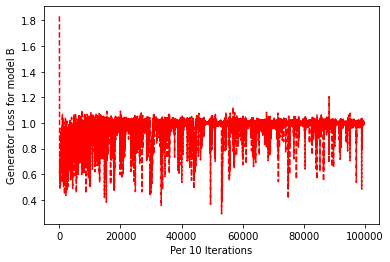

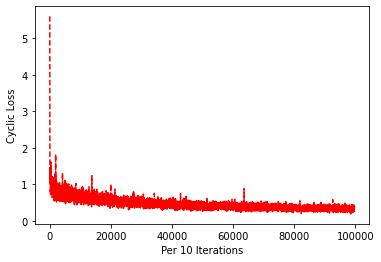

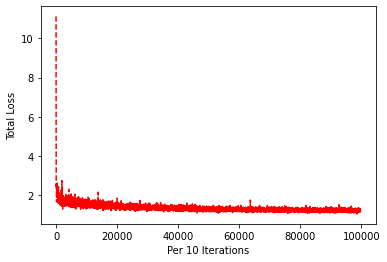

In [ ]:
#Plotting

import matplotlib.pyplot as plt
plt.plot(loss_D_A_list, 'r--')
plt.xlabel('Per 10 Iterations')
plt.ylabel('Discriminator Loss for model A')
plt.show()

plt.plot(steps_list, loss_D_B_list, 'r--')
plt.xlabel('Per 10 Iterations')
plt.ylabel('Discriminator Loss for model B')
plt.show()

plt.plot(steps_list, loss_GAN_AB_list, 'r--')
plt.xlabel('Per 10 Iterations')
plt.ylabel('Generator Loss for model A')
plt.show()

plt.plot(steps_list, loss_GAN_BA_list, 'r--')
plt.xlabel('Per 10 Iterations')
plt.ylabel('Generator Loss for model B')
plt.show()

plt.plot(steps_list, loss_cycle_list, 'r--')
plt.xlabel('Per 10 Iterations')
plt.ylabel('Cyclic Loss')
plt.show()

plt.plot(steps_list, total_loss_list, 'r--')
plt.xlabel('Per 10 Iterations')
plt.ylabel('Total Loss')
plt.show()

In [ ]:
  !zip -r /content/models.zip /content/models

  adding: content/models/ (stored 0%)
  adding: content/models/G_BA.pt (deflated 7%)
  adding: content/models/D_VAE.pt (deflated 7%)
  adding: content/models/.DS_Store (deflated 97%)
  adding: content/models/encoder.pt (deflated 8%)
  adding: content/models/generator.pt (deflated 7%)
  adding: content/models/D_LR.pt (deflated 8%)
  adding: content/models/G_AB.pt (deflated 7%)


In [ ]:
from google.colab import files
files.download("models.zip")

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

# CycleGAN Testing

In [ ]:
from google.colab import files
# files.download("/content/models.zip")
! unzip -q models.zip

replace content/models/G_BA.pt? [y]es, [n]o, [A]ll, [N]one, [r]ename: N


In [ ]:
from torch.utils.data import DataLoader, TensorDataset
test_batch_size = 1
test_img_dir = './edges2shoes/val/'
test_dataset = Edge2Shoe(test_img_dir)
test_loader = DataLoader(test_dataset, batch_size=test_batch_size)

In [ ]:
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
cuda = torch.cuda.is_available()
G_AB = torch.load('/content/content/models/G_AB.pt')
G_BA = torch.load('/content/content/models/G_BA.pt')
if cuda:
    G_AB = G_AB.to(device)
    G_BA = G_BA.to(device)

In [ ]:
# Normalize image tensor
def norm(image):
    return (image/255.0-0.5)*2.0

# Denormalize image tensor
def denorm(tensor):
    return ((tensor+1.0)/2.0)*255.0

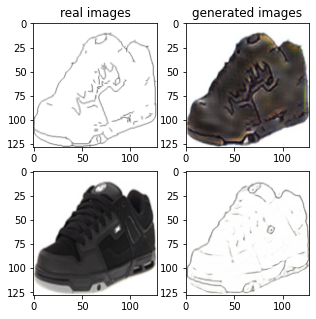

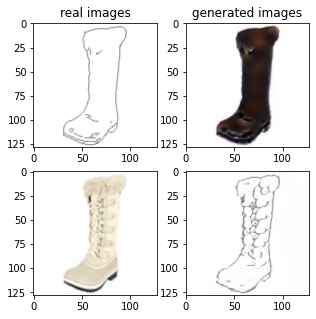

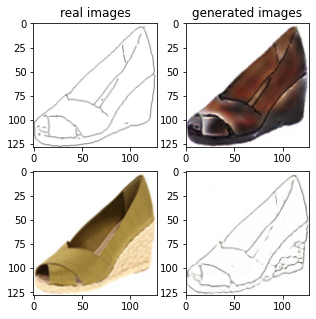

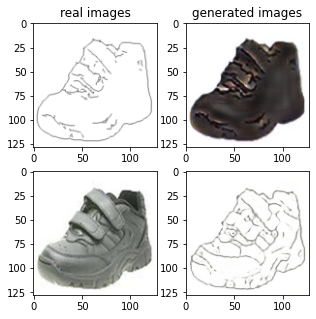

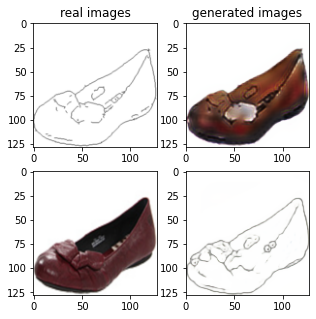

...

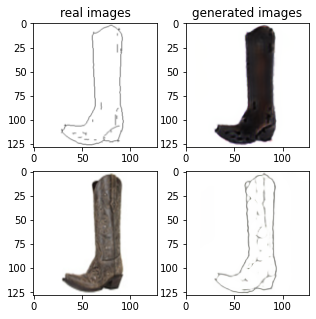

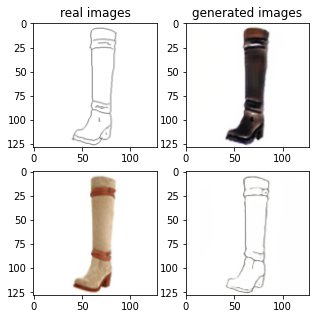

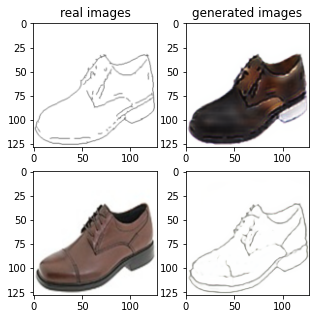

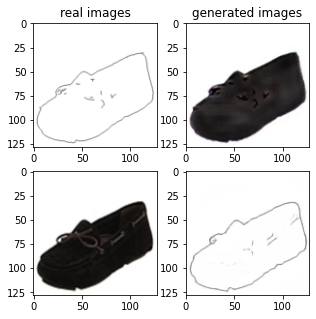

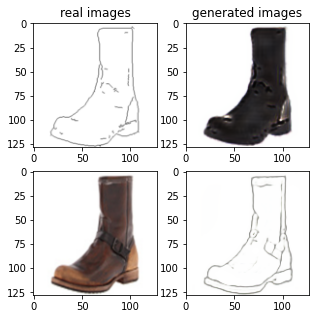

KeyboardInterrupt: ignored

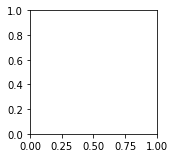

In [ ]:
G_AB.eval()
G_BA.eval()
# For adversarial loss
Tensor = torch.cuda.FloatTensor if cuda else torch.Tensor
################################
# Please visualize real_edge, fake_shoe, real_shoe, fake_edge in 2-by-2 grids:

################################        
for idx, data in enumerate(test_loader):
    ########## Process Inputs ##########
    edge_tensor, rgb_tensor = data
    edge_tensor, rgb_tensor = norm(edge_tensor).to(device), norm(rgb_tensor).to(device)
    real_A = edge_tensor; real_B = rgb_tensor; 
    # Adversarial ground truths
    valid = Variable(Tensor(np.ones((real_A.size(0), *D_A.output_shape))), requires_grad=False)
    fake = Variable(Tensor(np.zeros((real_A.size(0), *D_A.output_shape))), requires_grad=False)
    fake_B = G_AB(real_A)
    fake_A = G_BA(real_B)
    vis_fake_A = denorm(fake_A[0].detach()).cpu().data.numpy().astype(np.uint8)
    vis_fake_B = denorm(fake_B[0].detach()).cpu().data.numpy().astype(np.uint8)
    vis_real_B = denorm(real_B[0].detach()).cpu().data.numpy().astype(np.uint8)
    vis_real_A = denorm(real_A[0].detach()).cpu().data.numpy().astype(np.uint8)
    fig, axs = plt.subplots(2,2, figsize = (5,5))	
    
    axs[0,0].imshow(vis_real_A.transpose(1,2,0))
    axs[0,0].set_title('real images')
    axs[0,1].imshow(vis_fake_B.transpose(1,2,0))
    axs[0,1].set_title('generated images')
    axs[1,0].imshow(vis_real_B.transpose(1,2,0))
    axs[1,1].imshow(vis_fake_A.transpose(1,2,0))
    plt.show()

In [ ]:
! mkdir real_A_1 real_A_2 gen_A
! mkdir real_B_1 real_B_2 gen_B

In [ ]:
! pip install pytorch-fid

  Created wheel for pytorch-fid: filename=pytorch_fid-0.1.1-cp36-none-any.whl size=10188 sha256=458dbfd915a6fe07a271a2da2c401aa50c16d2f75acb162b4e2bdbe072faf6af
  Stored in directory: /root/.cache/pip/wheels/b8/93/92/a6a8add9047b97dcb2470d2d1642450e6b76b5988e9744e3f0
Successfully built pytorch-fid


In [ ]:
print('computing FID score between real_edge_1 and real_edge_2')
! python -m pytorch_fid '/content/real_A_1' '/content/real_A_2' --gpu 0

print('computing FID score between real_edge_1 and gen_edge')
! python -m pytorch_fid '/content/real_A_1' '/content/gen_A' --gpu 0

print('computing FID score between real_shoe_1 and real_shoe_2')
! python -m pytorch_fid '/content/real_B_1' '/content/real_B_2' --gpu 0

print('computing FID score between real_shoe_1 and gen_shoe')
! python -m pytorch_fid '/content/real_B_1' '/content/gen_B' --gpu 0

computing FID score between real_edge_1 and real_edge_2
Downloading: "https://github.com/mseitzer/pytorch-fid/releases/download/fid_weights/pt_inception-2015-12-05-6726825d.pth" to /root/.cache/torch/hub/checkpoints/pt_inception-2015-12-05-6726825d.pth
100% 91.2M/91.2M [00:06<00:00, 14.0MB/s]
100% 2/2 [00:00<00:00,  9.27it/s]
100% 2/2 [00:00<00:00,  9.58it/s]
FID:  51.65125472373556
computing FID score between real_edge_1 and gen_edge
100% 2/2 [00:00<00:00,  9.63it/s]
100% 2/2 [00:00<00:00,  8.65it/s]
FID:  78.8811051424135
computing FID score between real_shoe_1 and real_shoe_2
100% 2/2 [00:00<00:00,  8.02it/s]
100% 2/2 [00:00<00:00,  7.80it/s]
FID:  58.85457114374489
computing FID score between real_shoe_1 and gen_shoe
100% 2/2 [00:00<00:00,  8.18it/s]
100% 2/2 [00:00<00:00,  7.74it/s]
FID:  125.83913882311951


In [ ]:
from inception_score import inception_score
import warnings
warnings.filterwarnings("ignore")

print('IS score for real_edge_1 data set:')
print(inception_score(real_A_dataset_1, cuda=True, batch_size=64, resize=True, splits=1))
print('IS score for gen_edge data set:')
print(inception_score(gen_dataset_A, cuda=True, batch_size=64, resize=True, splits=1))


print('IS score for real_shoe_1:')
print(inception_score(real_B_dataset_1, cuda=True, batch_size=64, resize=True, splits=1))
print('IS score for gen_shoe data set:')
print(inception_score(gen_dataset_B, cuda=True, batch_size=64, resize=True, splits=1))

IS score for real_edge_1 data set:


Downloading: "https://download.pytorch.org/models/inception_v3_google-1a9a5a14.pth" to /root/.cache/torch/hub/checkpoints/inception_v3_google-1a9a5a14.pth



1.001472220463397
IS score for gen_edge data set:
1.0015487378867645
IS score for real_shoe_1:
3.342128280677282
IS score for gen_shoe data set:
2.6585087109193446
